# Lake Effect Precipitation Prediction using Hybrid CNN & RNN-LSTM Deep Learning Model

# Notebook Summary:
## 1. Data Preprocessing

- **Exploratory Data Analysis (EDA)**:
  - Renames meteorological feature names for clarity.
  - Combines 'Date_UTC' and 'Time_UTC' into a single datetime column and ensures chronological sorting. Focuses only on UTC time, removing other timezone data.
  - Identified and handles missing data and non-numerical values.
  - Removes certain meteorological features with a high percentage of non-numerical data.
  - also, eliminated one feature for every two higly correlated independent features. 

## 2. Image Analysis
- Analyzed satellite images for clarity and information presence across different time zones (EST).
- Noted distortion in images post 6PM EST and identifies specific date ranges with completely dark images and eliminated those.
- Decides to exclude data outside of 14:00 UTC to 22:00 UTC due to insufficient sunlight affecting image clarity. So, we have data from 10:00 EST to 18:00 EST.  which is of 9 hrs of clear cloud images.

## 3. Data Filtering and Saving
- Saved a complete preprocessed data as `les_data`.csv, which contains all features as in the original file.
- And, One file for only meteorological features saved as `meteorological_data`.csv for further work with meteorological data for the RNN model.
- Lastly, Retains only DateTime_UTC and lake_data_2D columns as `filtered_les_cld_imgs`.csv for further work with cloud images for the CNN model.

# 1. Data Preprocessing

**Import necessary libraries**

In [1]:
import os
import pandas as pd
import numpy as np
import pickle
import ast
import cv2
from tqdm import tqdm

# Plotting libraries
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

**Read the `2006Fall_2017Spring_GOES_meteo_combined` data**

In [2]:
# Read the CSV file into the original DataFrame
original_les = pd.read_csv('../les-preprocessing/2006Fall_2017Spring_GOES_meteo_combined.csv')

# Create a copy of the original DataFrame for making further changes
les = original_les.copy()

# Set max_columns option to None to display all columns
pd.set_option('display.max_columns', None)

# Print the first few rows of the DataFrame
les.head()

,Date_UTC,Time_UTC,Date_CST,Time_CST,File_name_for_1D_lake,File_name_for_2D_lake,Lake_data_1D,Lake_data_2D,Temp (F),RH (%),Dewpt (F),Wind Spd (mph),Wind Direction (deg),Peak Wind Gust(mph),Low Cloud Ht (ft),Med Cloud Ht (ft),High Cloud Ht (ft),Visibility (mi),Atm Press (hPa),Sea Lev Press (hPa),Altimeter (hPa),Precip (in),Wind Chill (F),Heat Index (F)
0,2006-10-01,00:00,2006-09-30,00:00,goes11.2006.10.01.0000.v01.nc-var1-t0.csv,T_goes11.2006.10.01.0000.v01.nc-var1-t0.csv.csv,"[0.0075, 0.0025, 0.0, 0.005, 0.0, 0.005, nan, ...","[array([ nan, nan, nan, nan, nan...",48,86,44,7,150,m,4100,4800,7000,10,984.0,1007.00,1006.80,0.00,45,NC
1,2006-10-01,01:00,2006-09-30,01:00,goes11.2006.10.01.0100.v01.nc-var1-t0.csv,T_goes11.2006.10.01.0100.v01.nc-var1-t0.csv.csv,"[0.0025, nan, 0.0025, 0.0025, nan, 0.0, nan, 0...","[array([ nan, nan, nan, nan, nan...",48,86,44,8,150,m,6000,m,m,10,983.7,1006.50,1006.40,0.00,44,NC
2,2006-10-01,02:00,2006-09-30,02:00,goes11.2006.10.01.0200.v01.nc-var1-t0.csv,T_goes11.2006.10.01.0200.v01.nc-var1-t0.csv.csv,"[0.0, nan, 0.0075, nan, nan, 0.0025, nan, nan,...","[array([nan, nan, nan, nan, nan, nan, nan, nan...",48,86,44,6,M,m,5500,11000,m,10,982.7,1005.70,1005.40,0.00,45,NC
3,2006-10-01,03:00,2006-09-30,03:00,goes11.2006.10.01.0300.v01.nc-var1-t0.csv,T_goes11.2006.10.01.0300.v01.nc-var1-t0.csv.csv,"[0.0025, nan, 0.0025, 0.0, 0.0075, nan, 0.005,...","[array([nan, nan, nan, nan, nan, nan, nan, nan...",48,86,44,8,150,m,6000,m,m,10,982.0,1005.10,1004.70,0.00,44,NC
4,2006-10-01,04:00,2006-09-30,04:00,goes11.2006.10.01.0400.v01.nc-var1-t0.csv,T_goes11.2006.10.01.0400.v01.nc-var1-t0.csv.csv,"[0.0025, nan, 0.0, nan, 0.0075, 0.0, nan, nan,...","[array([ nan, nan, nan, nan, nan...",48,89,45,5,M,m,2200,3500,m,8,982.0,1004.90,1004.70,0.02,46,NC


In [3]:
les.shape

(48121, 24)

## Exploratory Data Analysis

**Let's check the feature names in the dataset**

In [4]:
# Get the column names of the DataFrame 'les' and convert them to a list
column_names = les.columns.tolist()

# Print the list of column names
print(column_names)

['Date_UTC', 'Time_UTC', 'Date_CST', 'Time_CST', 'File_name_for_1D_lake', 'File_name_for_2D_lake', 'Lake_data_1D', 'Lake_data_2D', 'Temp (F)', 'RH (%)', 'Dewpt (F)', 'Wind Spd (mph)', 'Wind Direction (deg)', 'Peak Wind Gust(mph)', 'Low Cloud Ht (ft)', 'Med Cloud Ht (ft)', 'High Cloud Ht (ft)', 'Visibility (mi)', 'Atm Press (hPa)', 'Sea Lev Press (hPa)', 'Altimeter (hPa)', 'Precip (in)', 'Wind Chill (F)', 'Heat Index (F)']


**Rename the meteorological features names**

In [5]:
# Renaming
les.rename(columns={ "Temp (F)": "Temp_F", "RH (%)": "RH_pct",
                   "Dewpt (F)" : "Dewpt_F", "Wind Spd (mph)" : "Wind_Spd_mph",
                   "Wind Direction (deg)" : "Wind_Direction_deg", "Peak Wind Gust(mph)" : "Peak_Wind_Gust_mph",
                   "Low Cloud Ht (ft)" : "Low_Cloud_Ht_ft", "Med Cloud Ht (ft)" : "Med_Cloud_Ht_ft",
                   "High Cloud Ht (ft)" : "High_Cloud_Ht_ft", "Visibility (mi)" : "Visibility_mi",
                   "Atm Press (hPa)" : "Atm_Press_hPa", "Sea Lev Press (hPa)" : "Sea_Lev_Press_hPa",
                   "Altimeter (hPa)" : "Altimeter_hPa", "Precip (in)" : "Precip_in",
                   "Wind Chill (F)" : "Wind_Chill_F", "Heat Index (F)" : "Heat_Index_F",
                   } , inplace = True)

les

,Date_UTC,Time_UTC,Date_CST,Time_CST,File_name_for_1D_lake,File_name_for_2D_lake,Lake_data_1D,Lake_data_2D,Temp_F,RH_pct,Dewpt_F,Wind_Spd_mph,Wind_Direction_deg,Peak_Wind_Gust_mph,Low_Cloud_Ht_ft,Med_Cloud_Ht_ft,High_Cloud_Ht_ft,Visibility_mi,Atm_Press_hPa,Sea_Lev_Press_hPa,Altimeter_hPa,Precip_in,Wind_Chill_F,Heat_Index_F
0,2006-10-01,00:00,2006-09-30,00:00,goes11.2006.10.01.0000.v01.nc-var1-t0.csv,T_goes11.2006.10.01.0000.v01.nc-var1-t0.csv.csv,"[0.0075, 0.0025, 0.0, 0.005, 0.0, 0.005, nan, ...","[array([ nan, nan, nan, nan, nan...",48,86,44,7,150,m,4100,4800,7000,10,984.0,1007.00,1006.80,0.00,45,NC
1,2006-10-01,01:00,2006-09-30,01:00,goes11.2006.10.01.0100.v01.nc-var1-t0.csv,T_goes11.2006.10.01.0100.v01.nc-var1-t0.csv.csv,"[0.0025, nan, 0.0025, 0.0025, nan, 0.0, nan, 0...","[array([ nan, nan, nan, nan, nan...",48,86,44,8,150,m,6000,m,m,10,983.7,1006.50,1006.40,0.00,44,NC
2,2006-10-01,02:00,2006-09-30,02:00,goes11.2006.10.01.0200.v01.nc-var1-t0.csv,T_goes11.2006.10.01.0200.v01.nc-var1-t0.csv.csv,"[0.0, nan, 0.0075, nan, nan, 0.0025, nan, nan,...","[array([nan, nan, nan, nan, nan, nan, nan, nan...",48,86,44,6,M,m,5500,11000,m,10,982.7,1005.70,1005.40,0.00,45,NC
3,2006-10-01,03:00,2006-09-30,03:00,goes11.2006.10.01.0300.v01.nc-var1-t0.csv,T_goes11.2006.10.01.0300.v01.nc-var1-t0.csv.csv,"[0.0025, nan, 0.0025, 0.0, 0.0075, nan, 0.005,...","[array([nan, nan, nan, nan, nan, nan, nan, nan...",48,86,44,8,150,m,6000,m,m,10,982.0,1005.10,1004.70,0.00,44,NC
4,2006-10-01,04:00,2006-09-30,04:00,goes11.2006.10.01.0400.v01.nc-var1-t0.csv,T_goes11.2006.10.01.0400.v01.nc-var1-t0.csv.csv,"[0.0025, nan, 0.0, nan, 0.0075, 0.0, nan, nan,...","[array([ nan, nan, nan, nan, nan...",48,89,45,5,M,m,2200,3500,m,8,982.0,1004.90,1004.70,0.02,46,NC
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48116,2015-03-31,19:00,2015-03-31,19:00,goes15.2015.03.31.1900.v01.nc-var1-t0.csv,T_goes15.2015.03.31.1900.v01.nc-var1-t0.csv.csv,"[0.22, 0.1925, 0.1775, 0.16749999, 0.16499999,...","[array([ nan, nan, nan, ...",37.0,66.0,27.0,11,310,18,3500,5500,m,10,990.70,1014.10,1013.50,0.00,29,NC
48117,2015-03-31,20:00,2015-03-31,20:00,goes15.2015.03.31.2000.v01.nc-var1-t0.csv,T_goes15.2015.03.31.2000.v01.nc-var1-t0.csv.csv,"[0.2575, 0.22, 0.21249999, 0.17999999, 0.185, ...","[array([ nan, nan, nan, nan, nan...",36.0,85.0,32.0,0,0,m,2100,2900,5000,10,991.00,1014.60,1013.90,0.00,NC,NC
48118,2015-03-31,21:00,2015-03-31,21:00,goes15.2015.03.31.2100.v01.nc-var1-t0.csv,T_goes15.2015.03.31.2100.v01.nc-var1-t0.csv.csv,"[0.2225, 0.18249999, 0.19, 0.17999999, 0.1725,...","[array([ nan, nan, nan, nan, nan, nan, n...",36.0,85.0,32.0,0,0,m,4600,m,m,10,991.70,1015.00,1014.60,0.00,NC,NC
48119,2015-03-31,22:00,2015-03-31,22:00,goes15.2015.03.31.2200.v01.nc-var1-t0.csv,T_goes15.2015.03.31.2200.v01.nc-var1-t0.csv.csv,"[0.17999999, 0.16749999, 0.16749999, 0.16, 0.1...","[array([ nan, nan, nan, nan, nan...",36.0,81.0,31.0,0,0,m,4800,5500,m,10,991.70,1014.90,1014.60,0.00,NC,NC


**Firstly, since it's a time-series dataset, the observations span from 2006 through 2017. However, upon inspection, it appears that the last rows contain data from the year 2015. This indicates that the data needs to be sorted chronologically to ensure it follows the correct order of years.**

**Combine 'Date_UTC' and 'Time_UTC' columns into a single datetime column**

In [6]:
# Combine 'Date_UTC' and 'Time_UTC' columns into a single datetime column
les['DateTime_UTC'] = pd.to_datetime(les['Date_UTC'] + ' ' + les['Time_UTC'])

# Drop the 'Date_UTC' and 'Time_UTC' columns
les.drop(['Date_UTC', 'Time_UTC'], axis=1, inplace=True)

**Insert 'DateTime_UTC' column back at the beginning**

In [7]:
# Pop 'DateTime_UTC' column
datetime_utc_column = les.pop('DateTime_UTC')
    
# Insert 'DateTime_UTC' column back at the beginning
les.insert(0, 'DateTime_UTC', datetime_utc_column)
les

,DateTime_UTC,Date_CST,Time_CST,File_name_for_1D_lake,File_name_for_2D_lake,Lake_data_1D,Lake_data_2D,Temp_F,RH_pct,Dewpt_F,Wind_Spd_mph,Wind_Direction_deg,Peak_Wind_Gust_mph,Low_Cloud_Ht_ft,Med_Cloud_Ht_ft,High_Cloud_Ht_ft,Visibility_mi,Atm_Press_hPa,Sea_Lev_Press_hPa,Altimeter_hPa,Precip_in,Wind_Chill_F,Heat_Index_F
0,2006-10-01 00:00:00,2006-09-30,00:00,goes11.2006.10.01.0000.v01.nc-var1-t0.csv,T_goes11.2006.10.01.0000.v01.nc-var1-t0.csv.csv,"[0.0075, 0.0025, 0.0, 0.005, 0.0, 0.005, nan, ...","[array([ nan, nan, nan, nan, nan...",48,86,44,7,150,m,4100,4800,7000,10,984.0,1007.00,1006.80,0.00,45,NC
1,2006-10-01 01:00:00,2006-09-30,01:00,goes11.2006.10.01.0100.v01.nc-var1-t0.csv,T_goes11.2006.10.01.0100.v01.nc-var1-t0.csv.csv,"[0.0025, nan, 0.0025, 0.0025, nan, 0.0, nan, 0...","[array([ nan, nan, nan, nan, nan...",48,86,44,8,150,m,6000,m,m,10,983.7,1006.50,1006.40,0.00,44,NC
2,2006-10-01 02:00:00,2006-09-30,02:00,goes11.2006.10.01.0200.v01.nc-var1-t0.csv,T_goes11.2006.10.01.0200.v01.nc-var1-t0.csv.csv,"[0.0, nan, 0.0075, nan, nan, 0.0025, nan, nan,...","[array([nan, nan, nan, nan, nan, nan, nan, nan...",48,86,44,6,M,m,5500,11000,m,10,982.7,1005.70,1005.40,0.00,45,NC
3,2006-10-01 03:00:00,2006-09-30,03:00,goes11.2006.10.01.0300.v01.nc-var1-t0.csv,T_goes11.2006.10.01.0300.v01.nc-var1-t0.csv.csv,"[0.0025, nan, 0.0025, 0.0, 0.0075, nan, 0.005,...","[array([nan, nan, nan, nan, nan, nan, nan, nan...",48,86,44,8,150,m,6000,m,m,10,982.0,1005.10,1004.70,0.00,44,NC
4,2006-10-01 04:00:00,2006-09-30,04:00,goes11.2006.10.01.0400.v01.nc-var1-t0.csv,T_goes11.2006.10.01.0400.v01.nc-var1-t0.csv.csv,"[0.0025, nan, 0.0, nan, 0.0075, 0.0, nan, nan,...","[array([ nan, nan, nan, nan, nan...",48,89,45,5,M,m,2200,3500,m,8,982.0,1004.90,1004.70,0.02,46,NC
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48116,2015-03-31 19:00:00,2015-03-31,19:00,goes15.2015.03.31.1900.v01.nc-var1-t0.csv,T_goes15.2015.03.31.1900.v01.nc-var1-t0.csv.csv,"[0.22, 0.1925, 0.1775, 0.16749999, 0.16499999,...","[array([ nan, nan, nan, ...",37.0,66.0,27.0,11,310,18,3500,5500,m,10,990.70,1014.10,1013.50,0.00,29,NC
48117,2015-03-31 20:00:00,2015-03-31,20:00,goes15.2015.03.31.2000.v01.nc-var1-t0.csv,T_goes15.2015.03.31.2000.v01.nc-var1-t0.csv.csv,"[0.2575, 0.22, 0.21249999, 0.17999999, 0.185, ...","[array([ nan, nan, nan, nan, nan...",36.0,85.0,32.0,0,0,m,2100,2900,5000,10,991.00,1014.60,1013.90,0.00,NC,NC
48118,2015-03-31 21:00:00,2015-03-31,21:00,goes15.2015.03.31.2100.v01.nc-var1-t0.csv,T_goes15.2015.03.31.2100.v01.nc-var1-t0.csv.csv,"[0.2225, 0.18249999, 0.19, 0.17999999, 0.1725,...","[array([ nan, nan, nan, nan, nan, nan, n...",36.0,85.0,32.0,0,0,m,4600,m,m,10,991.70,1015.00,1014.60,0.00,NC,NC
48119,2015-03-31 22:00:00,2015-03-31,22:00,goes15.2015.03.31.2200.v01.nc-var1-t0.csv,T_goes15.2015.03.31.2200.v01.nc-var1-t0.csv.csv,"[0.17999999, 0.16749999, 0.16749999, 0.16, 0.1...","[array([ nan, nan, nan, nan, nan...",36.0,81.0,31.0,0,0,m,4800,5500,m,10,991.70,1014.90,1014.60,0.00,NC,NC


**Since we have data in two different time zones, let's keep only the UTC time and remove `Date_CST` and `Time_CST`**

In [8]:
# Drop the 'Date_CST' and 'Time_CST' columns
les.drop(['Date_CST', 'Time_CST'], axis=1, inplace=True)

**Sort the DataFrame by the 'DateTime_UTC' column**

In [9]:
# Sort the DataFrame by the 'DateTime_UTC' column
les.sort_values(by='DateTime_UTC', inplace=True)
les.reset_index(drop=True, inplace=True)
les

,DateTime_UTC,File_name_for_1D_lake,File_name_for_2D_lake,Lake_data_1D,Lake_data_2D,Temp_F,RH_pct,Dewpt_F,Wind_Spd_mph,Wind_Direction_deg,Peak_Wind_Gust_mph,Low_Cloud_Ht_ft,Med_Cloud_Ht_ft,High_Cloud_Ht_ft,Visibility_mi,Atm_Press_hPa,Sea_Lev_Press_hPa,Altimeter_hPa,Precip_in,Wind_Chill_F,Heat_Index_F
0,2006-10-01 00:00:00,goes11.2006.10.01.0000.v01.nc-var1-t0.csv,T_goes11.2006.10.01.0000.v01.nc-var1-t0.csv.csv,"[0.0075, 0.0025, 0.0, 0.005, 0.0, 0.005, nan, ...","[array([ nan, nan, nan, nan, nan...",48,86,44,7,150,m,4100,4800,7000,10,984.0,1007.00,1006.80,0.00,45,NC
1,2006-10-01 01:00:00,goes11.2006.10.01.0100.v01.nc-var1-t0.csv,T_goes11.2006.10.01.0100.v01.nc-var1-t0.csv.csv,"[0.0025, nan, 0.0025, 0.0025, nan, 0.0, nan, 0...","[array([ nan, nan, nan, nan, nan...",48,86,44,8,150,m,6000,m,m,10,983.7,1006.50,1006.40,0.00,44,NC
2,2006-10-01 02:00:00,goes11.2006.10.01.0200.v01.nc-var1-t0.csv,T_goes11.2006.10.01.0200.v01.nc-var1-t0.csv.csv,"[0.0, nan, 0.0075, nan, nan, 0.0025, nan, nan,...","[array([nan, nan, nan, nan, nan, nan, nan, nan...",48,86,44,6,M,m,5500,11000,m,10,982.7,1005.70,1005.40,0.00,45,NC
3,2006-10-01 03:00:00,goes11.2006.10.01.0300.v01.nc-var1-t0.csv,T_goes11.2006.10.01.0300.v01.nc-var1-t0.csv.csv,"[0.0025, nan, 0.0025, 0.0, 0.0075, nan, 0.005,...","[array([nan, nan, nan, nan, nan, nan, nan, nan...",48,86,44,8,150,m,6000,m,m,10,982.0,1005.10,1004.70,0.00,44,NC
4,2006-10-01 04:00:00,goes11.2006.10.01.0400.v01.nc-var1-t0.csv,T_goes11.2006.10.01.0400.v01.nc-var1-t0.csv.csv,"[0.0025, nan, 0.0, nan, 0.0075, 0.0, nan, nan,...","[array([ nan, nan, nan, nan, nan...",48,89,45,5,M,m,2200,3500,m,8,982.0,1004.90,1004.70,0.02,46,NC
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48116,2017-03-31 19:00:00,goes15.2017.03.31.1900.v01.nc-var1-t0.csv,T_goes15.2017.03.31.1900.v01.nc-var1-t0.csv.csv,"[0.75, 0.78249997, 0.805, 0.78999996, 0.789999...","[array([ nan, nan, nan, nan, nan...",40,76,33,0,0,m,5000,m,m,10,991.70,1015.30,1014.60,0.00,NC,NC
48117,2017-03-31 20:00:00,goes15.2017.03.31.2000.v01.nc-var1-t0.csv,T_goes15.2017.03.31.2000.v01.nc-var1-t0.csv.csv,"[0.76, 0.675, 0.72249997, 0.7175, 0.73249996, ...","[array([ nan, nan, nan, nan, nan...",39,72,31,3,20,m,5000,m,m,10,992.30,1015.80,1015.20,0.00,NC,NC
48118,2017-03-31 21:00:00,goes15.2017.03.31.2100.v01.nc-var1-t0.csv,T_goes15.2017.03.31.2100.v01.nc-var1-t0.csv.csv,"[0.6225, 0.6375, 0.6525, 0.66499996, 0.6725, 0...","[array([ nan, nan, nan, nan, nan...",35,84,31,5,300,m,M,m,m,10,993.30,1016.80,1016.30,0.00,31,NC
48119,2017-03-31 22:00:00,goes15.2017.03.31.2200.v01.nc-var1-t0.csv,T_goes15.2017.03.31.2200.v01.nc-var1-t0.csv.csv,"[0.4325, 0.45999998, 0.4725, 0.465, 0.45, 0.44...","[array([ nan, nan, nan, nan, nan...",34,85,30,0,0,m,M,m,m,10,993.30,1016.80,1016.30,0.00,NC,NC


**Check the data types and missing values**

In [10]:
# Checking the data types and missing values
data_info = les.dtypes
missing_values = les.isnull().sum()

data_info, missing_values

(DateTime_UTC             datetime64[ns]
 File_name_for_1D_lake            object
 File_name_for_2D_lake            object
 Lake_data_1D                     object
 Lake_data_2D                     object
 Temp_F                           object
 RH_pct                           object
 Dewpt_F                          object
 Wind_Spd_mph                     object
 Wind_Direction_deg               object
 Peak_Wind_Gust_mph               object
 Low_Cloud_Ht_ft                  object
 Med_Cloud_Ht_ft                  object
 High_Cloud_Ht_ft                 object
 Visibility_mi                    object
 Atm_Press_hPa                    object
 Sea_Lev_Press_hPa                object
 Altimeter_hPa                    object
 Precip_in                        object
 Wind_Chill_F                     object
 Heat_Index_F                     object
 dtype: object,
 DateTime_UTC                0
 File_name_for_1D_lake    2941
 File_name_for_2D_lake    2941
 Lake_data_1D                0

**There is missing data, as well as there are some non-numericals present in the data.**

**Let's examine the meteorological data with non-numeric values and their counts.**

In [11]:
# List of meteorological data columns
meteorological_features = [
    'Temp_F', 'RH_pct', 'Dewpt_F', 'Wind_Spd_mph', 'Wind_Direction_deg', 'Peak_Wind_Gust_mph',
    'Low_Cloud_Ht_ft', 'Med_Cloud_Ht_ft', 'High_Cloud_Ht_ft', 'Visibility_mi', 
    'Atm_Press_hPa', 'Sea_Lev_Press_hPa', 'Altimeter_hPa', 'Precip_in', 'Wind_Chill_F', 'Heat_Index_F'
]

# Initialize an empty list to store results
results = []

# Loop through each meteorological feature column
for column in meteorological_features:
    # Check if the column exists in the DataFrame 'les'
    if column in les.columns:
        # Convert the column values to numeric, coercing errors to NaN
        converted = pd.to_numeric(les[column], errors='coerce')
        # Count the number of non-numeric values (NaNs)
        non_numerical_count = converted.isna().sum()
        # Count the total number of values in the column
        total_count = les[column].count()
        # Get unique non-numeric values
        non_numericals = les[column][converted.isna()].unique()
        # Append results for the current column to the results list
        results.append({
            'Column': column,
            'Total Count': total_count,
            'Non-Numerical Count': non_numerical_count,
            'Non-Numericals': non_numericals,
        })
# Create a DataFrame from the results list
results_df = pd.DataFrame(results)
results_df

,Column,Total Count,Non-Numerical Count,Non-Numericals
0,Temp_F,47882,269,"[nan, M]"
1,RH_pct,47882,269,"[nan, m]"
2,Dewpt_F,47882,264,"[nan, M]"
3,Wind_Spd_mph,47882,337,"[M, nan]"
4,Wind_Direction_deg,47882,4538,"[M, nan]"
5,Peak_Wind_Gust_mph,47882,39573,"[m, nan, M]"
6,Low_Cloud_Ht_ft,47882,2303,"[M, nan]"
7,Med_Cloud_Ht_ft,47882,29045,"[m, nan]"
8,High_Cloud_Ht_ft,47882,42719,"[m, nan]"
9,Visibility_mi,47882,569,"[M, nan]"


**let's print the names of meteorological features where the non-numerical count is more than 40% of the total count**

In [12]:
for column in meteorological_features:
    if column in les.columns:
        total_count = len(les[column])
        non_numerical_count = pd.to_numeric(les[column], errors='coerce').isna().sum()
        
        if (non_numerical_count / total_count) * 100 > 40:
            print(column)

Peak_Wind_Gust_mph
Med_Cloud_Ht_ft
High_Cloud_Ht_ft
Wind_Chill_F
Heat_Index_F


**The above features will be removed after we review the data to determine if any other columns should also be removed.**

**Now, Let's look at the indexes of missing values of `File_name_for_1D_lake` and `File_name_for_2D_lake` and see if any other features are affected**

In [13]:
missing_values_index_1D = les[les['File_name_for_1D_lake'].isnull()].index
missing_values_index_2D = les[les['File_name_for_2D_lake'].isnull()].index

missing_values_index_1D, missing_values_index_2D

(Index([    8,     9,    32,    33,    56,    57,    80,    81,   104,   105,
        ...
        46581, 46749, 47085, 47253, 47421, 47589, 47757, 47854, 47878, 47925],
       dtype='int64', length=2941),
 Index([    8,     9,    32,    33,    56,    57,    80,    81,   104,   105,
        ...
        46581, 46749, 47085, 47253, 47421, 47589, 47757, 47854, 47878, 47925],
       dtype='int64', length=2941))

**Let's check the data at 8th row for example**

In [14]:
les.iloc[8]

DateTime_UTC                                           2006-10-01 08:00:00
File_name_for_1D_lake                                                  NaN
File_name_for_2D_lake                                                  NaN
Lake_data_1D             [nan, nan, nan, nan, nan, nan, nan, nan, nan, ...
Lake_data_2D                                                         [nan]
Temp_F                                                                  48
RH_pct                                                                  92
Dewpt_F                                                                 46
Wind_Spd_mph                                                             0
Wind_Direction_deg                                                       0
Peak_Wind_Gust_mph                                                       m
Low_Cloud_Ht_ft                                                       3600
Med_Cloud_Ht_ft                                                          m
High_Cloud_Ht_ft         

**From the above example we can see that where ever the file name is null there is also no image data.**

**Since it's a time series data, let's remove the null data from `Lake_data_1D` and `Lake_data_2D` where there are no `File_name_for_1D_lake` names and forward fill which propagates the last known value forward in the time series to fill missing values.**

In [15]:
# Remove data from 'Lake_data_1D' and 'Lake_data_2D' columns at missing value indexes
les.loc[missing_values_index_1D, ['Lake_data_1D', 'Lake_data_2D']] = np.nan

# Forward fill missing values in 'Lake_data_1D' and 'Lake_data_2D' columns
les['Lake_data_1D'].fillna(method='ffill', inplace=True)
les['Lake_data_2D'].fillna(method='ffill', inplace=True)

In [16]:
les.iloc[8]

DateTime_UTC                                           2006-10-01 08:00:00
File_name_for_1D_lake                                                  NaN
File_name_for_2D_lake                                                  NaN
Lake_data_1D             [nan, 0.0025, 0.005, 0.0025, nan, nan, nan, 0....
Lake_data_2D             [array([nan, nan, nan, nan, nan, nan, nan, nan...
Temp_F                                                                  48
RH_pct                                                                  92
Dewpt_F                                                                 46
Wind_Spd_mph                                                             0
Wind_Direction_deg                                                       0
Peak_Wind_Gust_mph                                                       m
Low_Cloud_Ht_ft                                                       3600
Med_Cloud_Ht_ft                                                          m
High_Cloud_Ht_ft         

## Feature engineering

**Now, let's remove unnecessary features and features with large missing data from the dataset:**

1. The meteorological features `Peak_Wind_Gust_mph`, `Med_Cloud_Ht_ft`, `High_Cloud_Ht_ft`, `Wind_Chill_F`, `Heat_Index_F` contain a large number of missing values as shown above.
2. Features `File_name_for_1D_lake`, `File_name_for_2D_lake` are irrelevant to our task.

In [17]:
columns_to_remove = ['Peak_Wind_Gust_mph', 'Med_Cloud_Ht_ft', 'High_Cloud_Ht_ft',
                     'Wind_Chill_F', 'Heat_Index_F', 'File_name_for_1D_lake', 'File_name_for_2D_lake']

les.drop(columns=columns_to_remove, axis=1, inplace=True)
les.head()

,DateTime_UTC,Lake_data_1D,Lake_data_2D,Temp_F,RH_pct,Dewpt_F,Wind_Spd_mph,Wind_Direction_deg,Low_Cloud_Ht_ft,Visibility_mi,Atm_Press_hPa,Sea_Lev_Press_hPa,Altimeter_hPa,Precip_in
0,2006-10-01 00:00:00,"[0.0075, 0.0025, 0.0, 0.005, 0.0, 0.005, nan, ...","[array([ nan, nan, nan, nan, nan...",48,86,44,7,150,4100,10,984.0,1007.00,1006.80,0.00
1,2006-10-01 01:00:00,"[0.0025, nan, 0.0025, 0.0025, nan, 0.0, nan, 0...","[array([ nan, nan, nan, nan, nan...",48,86,44,8,150,6000,10,983.7,1006.50,1006.40,0.00
2,2006-10-01 02:00:00,"[0.0, nan, 0.0075, nan, nan, 0.0025, nan, nan,...","[array([nan, nan, nan, nan, nan, nan, nan, nan...",48,86,44,6,M,5500,10,982.7,1005.70,1005.40,0.00
3,2006-10-01 03:00:00,"[0.0025, nan, 0.0025, 0.0, 0.0075, nan, 0.005,...","[array([nan, nan, nan, nan, nan, nan, nan, nan...",48,86,44,8,150,6000,10,982.0,1005.10,1004.70,0.00
4,2006-10-01 04:00:00,"[0.0025, nan, 0.0, nan, 0.0075, 0.0, nan, nan,...","[array([ nan, nan, nan, nan, nan...",48,89,45,5,M,2200,8,982.0,1004.90,1004.70,0.02


In [18]:
les.shape

(48121, 14)

In [19]:
# List of meteorological data columns
meteorological_features = [
    'Temp_F', 'RH_pct', 'Dewpt_F', 'Wind_Spd_mph', 'Wind_Direction_deg',
    'Low_Cloud_Ht_ft', 'Visibility_mi', 
    'Atm_Press_hPa', 'Sea_Lev_Press_hPa', 'Altimeter_hPa', 'Precip_in'
]

results = []

for column in meteorological_features:
    if column in les.columns:
        converted = pd.to_numeric(les[column], errors='coerce')
        non_numerical_count = converted.isna().sum()
        total_count = les[column].count()
        non_numericals = les[column][converted.isna()].unique()
        
        results.append({
            'Column': column,
            'Total Count': total_count,
            'Non-Numerical Count': non_numerical_count,
            'Non-Numericals': non_numericals,
        })

results_df = pd.DataFrame(results)
results_df

,Column,Total Count,Non-Numerical Count,Non-Numericals
0,Temp_F,47882,269,"[nan, M]"
1,RH_pct,47882,269,"[nan, m]"
2,Dewpt_F,47882,264,"[nan, M]"
3,Wind_Spd_mph,47882,337,"[M, nan]"
4,Wind_Direction_deg,47882,4538,"[M, nan]"
5,Low_Cloud_Ht_ft,47882,2303,"[M, nan]"
6,Visibility_mi,47882,569,"[M, nan]"
7,Atm_Press_hPa,47882,331,"[M, nan, m]"
8,Sea_Lev_Press_hPa,47882,3446,"[M, nan]"
9,Altimeter_hPa,47882,256,"[M, nan, m]"


In [20]:
missing_values = les.isnull().sum()
missing_values

DateTime_UTC            0
Lake_data_1D            0
Lake_data_2D            0
Temp_F                239
RH_pct                239
Dewpt_F               239
Wind_Spd_mph          239
Wind_Direction_deg    239
Low_Cloud_Ht_ft       239
Visibility_mi         239
Atm_Press_hPa         239
Sea_Lev_Press_hPa     239
Altimeter_hPa         239
Precip_in             239
dtype: int64

**In the meteorological features, there are still some data points remaining with values 'M' and 'm'. Since this is a time series dataset, we will use forward fill to impute these values. Also, for the NaN values in the data.**

**Forward fill involves propagating the last known value forward in the time series to fill missing values. This method ensures that each missing value is replaced with the most recent observation available in the dataset**

In [21]:
# Replace 'M' and 'm' with NaN
les.replace(['M', 'm'], float('nan'), inplace=True)

In [22]:
missing_values = les.isnull().sum()
missing_values

DateTime_UTC             0
Lake_data_1D             0
Lake_data_2D             0
Temp_F                 269
RH_pct                 269
Dewpt_F                264
Wind_Spd_mph           337
Wind_Direction_deg    4538
Low_Cloud_Ht_ft       2303
Visibility_mi          569
Atm_Press_hPa          331
Sea_Lev_Press_hPa     3446
Altimeter_hPa          256
Precip_in             2987
dtype: int64

In [23]:
# Impute missing values using forward fill
les.fillna(method='ffill', inplace=True)
les.head()

,DateTime_UTC,Lake_data_1D,Lake_data_2D,Temp_F,RH_pct,Dewpt_F,Wind_Spd_mph,Wind_Direction_deg,Low_Cloud_Ht_ft,Visibility_mi,Atm_Press_hPa,Sea_Lev_Press_hPa,Altimeter_hPa,Precip_in
0,2006-10-01 00:00:00,"[0.0075, 0.0025, 0.0, 0.005, 0.0, 0.005, nan, ...","[array([ nan, nan, nan, nan, nan...",48,86,44,7,150,4100,10,984.0,1007.00,1006.80,0.00
1,2006-10-01 01:00:00,"[0.0025, nan, 0.0025, 0.0025, nan, 0.0, nan, 0...","[array([ nan, nan, nan, nan, nan...",48,86,44,8,150,6000,10,983.7,1006.50,1006.40,0.00
2,2006-10-01 02:00:00,"[0.0, nan, 0.0075, nan, nan, 0.0025, nan, nan,...","[array([nan, nan, nan, nan, nan, nan, nan, nan...",48,86,44,6,150,5500,10,982.7,1005.70,1005.40,0.00
3,2006-10-01 03:00:00,"[0.0025, nan, 0.0025, 0.0, 0.0075, nan, 0.005,...","[array([nan, nan, nan, nan, nan, nan, nan, nan...",48,86,44,8,150,6000,10,982.0,1005.10,1004.70,0.00
4,2006-10-01 04:00:00,"[0.0025, nan, 0.0, nan, 0.0075, 0.0, nan, nan,...","[array([ nan, nan, nan, nan, nan...",48,89,45,5,150,2200,8,982.0,1004.90,1004.70,0.02


In [24]:
# List of meteorological data columns
meteorological_features = [
    'Temp_F', 'RH_pct', 'Dewpt_F', 'Wind_Spd_mph', 'Wind_Direction_deg',
    'Low_Cloud_Ht_ft', 'Visibility_mi', 
    'Atm_Press_hPa', 'Sea_Lev_Press_hPa', 'Altimeter_hPa', 'Precip_in'
]

results = []

for column in meteorological_features:
    if column in les.columns:
        converted = pd.to_numeric(les[column], errors='coerce')
        non_numerical_count = converted.isna().sum()
        total_count = les[column].count()
        non_numericals = les[column][converted.isna()].unique()
        
        results.append({
            'Column': column,
            'Total Count': total_count,
            'Non-Numerical Count': non_numerical_count,
            'Non-Numericals': non_numericals,
        })

results_df = pd.DataFrame(results)
results_df

,Column,Total Count,Non-Numerical Count,Non-Numericals
0,Temp_F,48121,0,[]
1,RH_pct,48121,0,[]
2,Dewpt_F,48121,0,[]
3,Wind_Spd_mph,48121,0,[]
4,Wind_Direction_deg,48121,0,[]
5,Low_Cloud_Ht_ft,48121,0,[]
6,Visibility_mi,48121,0,[]
7,Atm_Press_hPa,48121,0,[]
8,Sea_Lev_Press_hPa,48121,0,[]
9,Altimeter_hPa,48121,0,[]


In [25]:
# Checking the data types and missing values
data_info = les.dtypes
missing_values = les.isnull().sum()

data_info, missing_values

(DateTime_UTC          datetime64[ns]
 Lake_data_1D                  object
 Lake_data_2D                  object
 Temp_F                        object
 RH_pct                        object
 Dewpt_F                       object
 Wind_Spd_mph                  object
 Wind_Direction_deg            object
 Low_Cloud_Ht_ft               object
 Visibility_mi                 object
 Atm_Press_hPa                 object
 Sea_Lev_Press_hPa             object
 Altimeter_hPa                 object
 Precip_in                     object
 dtype: object,
 DateTime_UTC          0
 Lake_data_1D          0
 Lake_data_2D          0
 Temp_F                0
 RH_pct                0
 Dewpt_F               0
 Wind_Spd_mph          0
 Wind_Direction_deg    0
 Low_Cloud_Ht_ft       0
 Visibility_mi         0
 Atm_Press_hPa         0
 Sea_Lev_Press_hPa     0
 Altimeter_hPa         0
 Precip_in             0
 dtype: int64)

**Convert the meteorological features to numeric type**

In [26]:
# Using apply method
columns = les.columns
les[columns[3:]] = les[columns[3:]].apply(pd.to_numeric, errors='coerce')

In [27]:
les.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48121 entries, 0 to 48120
Data columns (total 14 columns):
 #   Column              Non-Null Count  Dtype         
---  ------              --------------  -----         
 0   DateTime_UTC        48121 non-null  datetime64[ns]
 1   Lake_data_1D        48121 non-null  object        
 2   Lake_data_2D        48121 non-null  object        
 3   Temp_F              48121 non-null  float64       
 4   RH_pct              48121 non-null  float64       
 5   Dewpt_F             48121 non-null  float64       
 6   Wind_Spd_mph        48121 non-null  int64         
 7   Wind_Direction_deg  48121 non-null  int64         
 8   Low_Cloud_Ht_ft     48121 non-null  int64         
 9   Visibility_mi       48121 non-null  int64         
 10  Atm_Press_hPa       48121 non-null  float64       
 11  Sea_Lev_Press_hPa   48121 non-null  float64       
 12  Altimeter_hPa       48121 non-null  float64       
 13  Precip_in           48121 non-null  float64   

### Correlation matrix

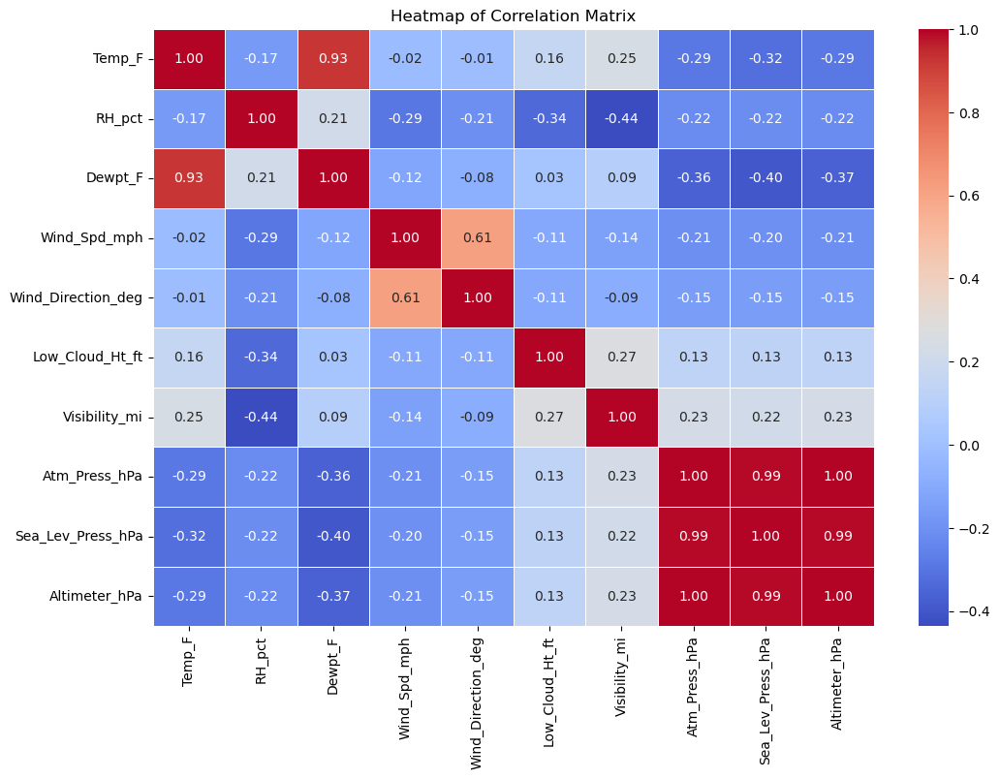

In [28]:
correlation_matrix = les.iloc[:, 3:-1].corr()

# Plot the heatmap
plt.figure(figsize=(12, 8))  # Adjust the figure size as needed
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=.5)
plt.title('Heatmap of Correlation Matrix')
plt.show()

**From the above Heat Map of Correalation Matrix**

1. Dewpt_F and Temp_F are highly correlated.
2. Altimeter_hPa and Atm_Press_hPa are highly correlated.
3. Altimeter_hPa and Sea_Lev_Press_hPa are highly correlated.
4. Atm_Press_hPa and Sea_Lev_Press_hPa are highly correlated.

### Eliminating highly correlated features

1. Removing Dewpt_F because Temp_F is important in the data and highly correlated with Dewpt_F.

2. Removing Sea_Lev_Press_hPa and Altimeter_hPa since Atm_Press_hPa is an important measure for predicting precipitation and highly correlated with both Sea_Lev_Press_hPa and Altimeter_hPa.

In [29]:
# Remove 'Altimeter_hPa' and 'Dewpt_F' columns from filtered_les_10k
les.drop(['Altimeter_hPa', 'Sea_Lev_Press_hPa', 'Dewpt_F'], axis=1, inplace=True)

# Print the DataFrame to verify the changes
les

,DateTime_UTC,Lake_data_1D,Lake_data_2D,Temp_F,RH_pct,Wind_Spd_mph,Wind_Direction_deg,Low_Cloud_Ht_ft,Visibility_mi,Atm_Press_hPa,Precip_in
0,2006-10-01 00:00:00,"[0.0075, 0.0025, 0.0, 0.005, 0.0, 0.005, nan, ...","[array([ nan, nan, nan, nan, nan...",48.0,86.0,7,150,4100,10,984.0,0.00
1,2006-10-01 01:00:00,"[0.0025, nan, 0.0025, 0.0025, nan, 0.0, nan, 0...","[array([ nan, nan, nan, nan, nan...",48.0,86.0,8,150,6000,10,983.7,0.00
2,2006-10-01 02:00:00,"[0.0, nan, 0.0075, nan, nan, 0.0025, nan, nan,...","[array([nan, nan, nan, nan, nan, nan, nan, nan...",48.0,86.0,6,150,5500,10,982.7,0.00
3,2006-10-01 03:00:00,"[0.0025, nan, 0.0025, 0.0, 0.0075, nan, 0.005,...","[array([nan, nan, nan, nan, nan, nan, nan, nan...",48.0,86.0,8,150,6000,10,982.0,0.00
4,2006-10-01 04:00:00,"[0.0025, nan, 0.0, nan, 0.0075, 0.0, nan, nan,...","[array([ nan, nan, nan, nan, nan...",48.0,89.0,5,150,2200,8,982.0,0.02
...,...,...,...,...,...,...,...,...,...,...,...
48116,2017-03-31 19:00:00,"[0.75, 0.78249997, 0.805, 0.78999996, 0.789999...","[array([ nan, nan, nan, nan, nan...",40.0,76.0,0,0,5000,10,991.7,0.00
48117,2017-03-31 20:00:00,"[0.76, 0.675, 0.72249997, 0.7175, 0.73249996, ...","[array([ nan, nan, nan, nan, nan...",39.0,72.0,3,20,5000,10,992.3,0.00
48118,2017-03-31 21:00:00,"[0.6225, 0.6375, 0.6525, 0.66499996, 0.6725, 0...","[array([ nan, nan, nan, nan, nan...",35.0,84.0,5,300,5000,10,993.3,0.00
48119,2017-03-31 22:00:00,"[0.4325, 0.45999998, 0.4725, 0.465, 0.45, 0.44...","[array([ nan, nan, nan, nan, nan...",34.0,85.0,0,0,5000,10,993.3,0.00


In [30]:
les.describe()

,DateTime_UTC,Temp_F,RH_pct,Wind_Spd_mph,Wind_Direction_deg,Low_Cloud_Ht_ft,Visibility_mi,Atm_Press_hPa,Precip_in
count,48121,48121.000000,48121.000000,48121.000000,48121.000000,48121.000000,48121.000000,48121.00000,48121.000000
mean,2011-12-31 10:48:50.662288896,33.133393,72.617464,6.795973,163.928015,4328.606430,8.114399,992.81835,0.002522
min,2006-10-01 00:00:00,-22.000000,0.000000,0.000000,0.000000,0.000000,0.000000,954.10000,0.000000
25%,2009-02-14 05:00:00,23.000000,64.000000,3.000000,20.000000,1400.000000,7.000000,987.30000,0.000000
50%,2011-12-31 11:00:00,33.000000,74.000000,6.000000,190.000000,2600.000000,10.000000,993.30000,0.000000
75%,2014-11-15 17:00:00,42.000000,84.000000,10.000000,260.000000,4300.000000,10.000000,999.00000,0.000000
max,2017-03-31 23:00:00,88.000000,100.000000,34.000000,360.000000,28000.000000,10.000000,1019.30000,1.400000
std,NaN,14.413027,13.901659,5.150020,120.527737,5446.231691,2.996060,8.84179,0.016038


**Meteorological Features are clean!!**

### Saving the data to CSV file

In [31]:
# Save the DataFrame to a CSV file
# les.to_csv('les_data.csv', index=False)

### Saving only Meteorological data to CSV file

In [32]:
Meteorological_data = les.drop(columns=les.columns[[1, 2]])
Meteorological_data

,DateTime_UTC,Temp_F,RH_pct,Wind_Spd_mph,Wind_Direction_deg,Low_Cloud_Ht_ft,Visibility_mi,Atm_Press_hPa,Precip_in
0,2006-10-01 00:00:00,48.0,86.0,7,150,4100,10,984.0,0.00
1,2006-10-01 01:00:00,48.0,86.0,8,150,6000,10,983.7,0.00
2,2006-10-01 02:00:00,48.0,86.0,6,150,5500,10,982.7,0.00
3,2006-10-01 03:00:00,48.0,86.0,8,150,6000,10,982.0,0.00
4,2006-10-01 04:00:00,48.0,89.0,5,150,2200,8,982.0,0.02
...,...,...,...,...,...,...,...,...,...
48116,2017-03-31 19:00:00,40.0,76.0,0,0,5000,10,991.7,0.00
48117,2017-03-31 20:00:00,39.0,72.0,3,20,5000,10,992.3,0.00
48118,2017-03-31 21:00:00,35.0,84.0,5,300,5000,10,993.3,0.00
48119,2017-03-31 22:00:00,34.0,85.0,0,0,5000,10,993.3,0.00


In [33]:
# # Save the modified DataFrame to a new CSV file
# Meteorological_data.to_csv('meteorological_data.csv', index=False)

-----

# 2. Cloud Imagery Analysis

**Let's plot the images from the `Lake_data_1D` and `Lake_data_2D` datasets. Additionally, we'll compare the images to cross verify if they are same and resize the `Lake_data_2D` data to 64x64**

**Read the `lat_long_1D_labels_for_plotting` data which contains latitude	& longitude data of the lake michigan**

In [34]:
df_lat_lon = df_lat_lon = pd.read_csv('../les-preprocessing/lat_long_1D_labels_for_plotting.csv')
df_lat_lon.head(5)

,latitude,longitude
0,41.78,-87.54
1,41.78,-87.50
2,41.78,-87.46
3,41.78,-87.42
4,41.78,-87.38


In [35]:
df_lat_lon.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3599 entries, 0 to 3598
Data columns (total 2 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   latitude   3599 non-null   float64
 1   longitude  3599 non-null   float64
dtypes: float64(2)
memory usage: 56.4 KB


**This function generates a scatter plot with latitude and longitude coordinates for 1D image** 

In [36]:
def arrays_2_png(lat, lon, val, fig_name):
    status_code = -1
    # Here it starts
    if len(lat) == len(lon) == len(val):
        plt.figure(figsize=(10, 10))
        plt.scatter(lon, lat, c=val, cmap=cm.gray, marker='s')
        plt.colorbar(orientation='vertical')
        status_code = 0
    else:
        status_code = 255

    return status_code

In [37]:
lat_lst = df_lat_lon['latitude'].to_list()
lon_lst = df_lat_lon['longitude'].to_list()

## Image plot from 1D data

### 1D data conversion 

In [38]:
data_sample = les['Lake_data_1D'][14]

In [39]:
import ast

data_sample_lst = ast.literal_eval(data_sample)
data_sample_lst

[0.067499995,
 0.07,
 0.0625,
 0.06,
 0.0725,
 0.06,
 0.074999996,
 0.065,
 0.067499995,
 0.067499995,
 0.0625,
 0.0625,
 0.067499995,
 0.0725,
 0.07,
 0.067499995,
 0.0775,
 0.08,
 0.082499996,
 0.06,
 0.067499995,
 0.0775,
 0.065,
 0.065,
 0.067499995,
 0.065,
 0.067499995,
 0.067499995,
 0.057499997,
 0.07,
 0.067499995,
 0.065,
 0.067499995,
 0.067499995,
 0.0725,
 0.067499995,
 0.07,
 0.0775,
 0.085,
 0.082499996,
 0.082499996,
 0.07,
 0.08,
 0.0775,
 0.0725,
 0.067499995,
 0.067499995,
 0.067499995,
 0.065,
 0.07,
 0.057499997,
 0.0725,
 0.067499995,
 0.0625,
 0.06,
 0.067499995,
 0.065,
 0.0725,
 0.0625,
 0.0725,
 0.0625,
 0.082499996,
 0.082499996,
 0.065,
 0.067499995,
 0.067499995,
 0.0725,
 0.0625,
 0.06,
 0.067499995,
 0.0625,
 0.067499995,
 0.067499995,
 0.067499995,
 0.0725,
 0.0625,
 0.067499995,
 0.0725,
 0.0625,
 0.07,
 0.07,
 0.067499995,
 0.07,
 0.067499995,
 0.074999996,
 0.0725,
 0.0775,
 0.0925,
 0.0725,
 0.0725,
 0.067499995,
 0.07,
 0.065,
 0.0725,
 0.067499995,

In [40]:
len(data_sample_lst)

3599

**Display the image**

0

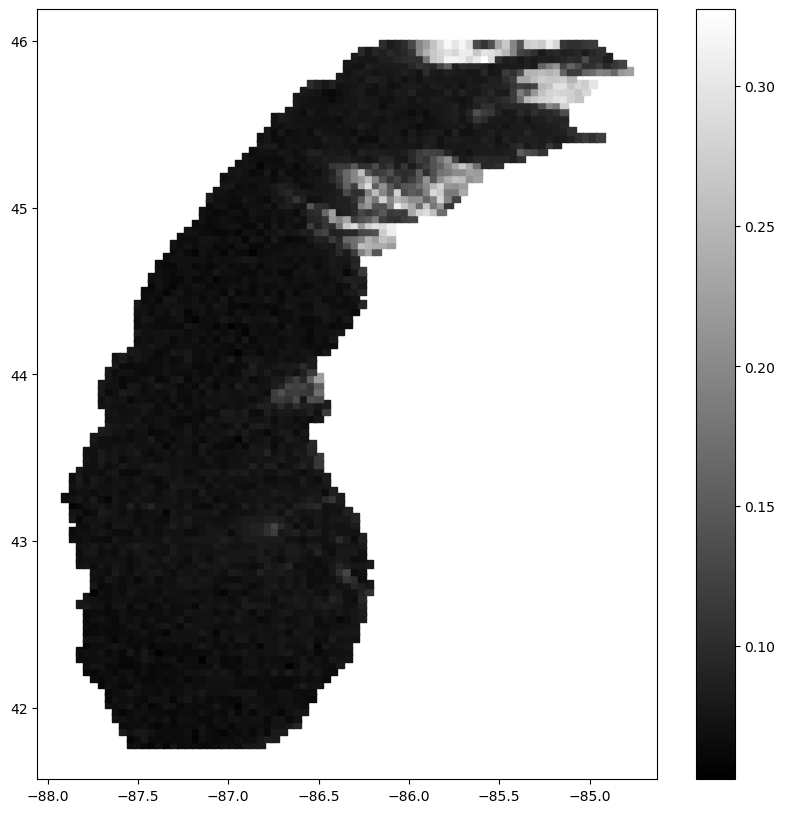

In [41]:
import matplotlib.cm as cm

arrays_2_png(lat_lst, lon_lst, data_sample_lst, 'sample')

## Image plot from 2D data

### 2D data conversion 

In [42]:
data_sample_2d = les['Lake_data_2D'][14]
data_sample_2d

'[array([       nan,        nan,        nan,        nan,        nan,\n              nan,        nan,        nan,        nan,        nan,\n              nan,        nan,        nan,        nan,        nan,\n              nan,        nan,        nan,        nan,        nan,\n              nan,        nan,        nan,        nan,        nan,\n              nan,        nan,        nan,        nan,        nan,\n              nan,        nan,        nan,        nan,        nan,\n              nan, 0.06749999,        nan,        nan,        nan,\n              nan,        nan,        nan,        nan,        nan,\n              nan,        nan,        nan,        nan,        nan,\n              nan,        nan,        nan,        nan,        nan,\n              nan,        nan,        nan,        nan,        nan,\n              nan,        nan,        nan,        nan,        nan,\n              nan,        nan,        nan,        nan,        nan,\n              nan,        nan,        nan,    

**Preprocess the string and convert it to NumPy arrays**

In [43]:
# Preprocess the string and convert it to a NumPy array
data_sample_2d_array = np.array(eval(data_sample_2d.replace('array(', '').replace('nan', 'np.nan').replace('\n', '').replace(')', '')))

# Transpose and flip the array vertically
data_sample_2d_array_transposed_flipped = np.flipud(np.transpose(data_sample_2d_array))

In [44]:
data_sample_2d_array.shape

(79, 105)

In [45]:
data_sample_2d_array_transposed_flipped.shape

(105, 79)

**Display the image**

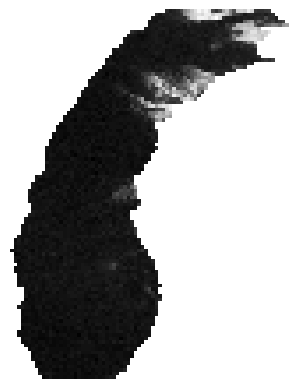

In [46]:
plt.imshow(data_sample_2d_array_transposed_flipped, cmap='gray')
plt.axis('off')  # Turn off axis labels
plt.show()

**Resize and plot the image**

In [47]:
import cv2
resized_img = cv2.resize(data_sample_2d_array_transposed_flipped, (64,64))

In [48]:
resized_img.shape

(64, 64)

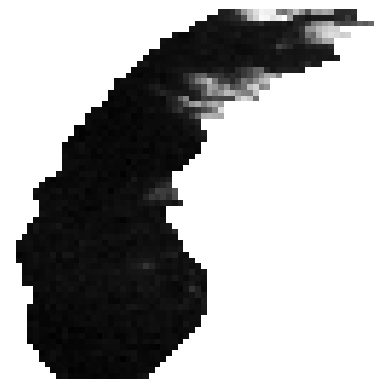

In [49]:
# Display the image
plt.imshow(resized_img, cmap='gray')
plt.axis('off')  # Turn off axis labels
plt.show()

**Since we know that the satellite images are available only when there is a good amount fo light available during day time so that the satillite was able to capture the images**

**Check the sunrise and sunset times of every first day of every month from 2006 to 2017 at lake michigan**

In [50]:
# pip install ephem

In [51]:
from datetime import date
import ephem
import pytz

# Create a sun object
sun = ephem.Sun()

# Create an observer object for Chicago, located on Lake Michigan
chicago = ephem.Observer()
chicago.lat = '44.78477'
chicago.lon = '-85.6369'
chicago.elevation = 181  # elevation in meters

# Define the first day of each month from 2006 to 2017
dates = [date(year, month, 1) for year in range(2006, 2018) for month in range(1, 13)]

# Timezone information for Chicago
chicago_tz = pytz.timezone('America/Chicago')

# Function to compute sunrise and sunset times adjusted for the local timezone
def get_sun_times(observer, body, dates, tz):
    sunrise_times = []
    sunset_times = []
    for day in dates:
        observer.date = ephem.Date(day)  # set observer's date
        sunrise_utc = observer.next_rising(body).datetime()  # UTC datetime of sunrise
        sunset_utc = observer.next_setting(body).datetime()  # UTC datetime of sunset
        # Convert UTC to local time
        sunrise_local = pytz.utc.localize(sunrise_utc).astimezone(tz)
        sunset_local = pytz.utc.localize(sunset_utc).astimezone(tz)
        sunrise_times.append(sunrise_local.strftime('%Y-%m-%d %H:%M:%S'))
        sunset_times.append(sunset_local.strftime('%Y-%m-%d %H:%M:%S'))
    return sunrise_times, sunset_times

# Calculating sunrise and sunset times for each first day of the month from 2006 to 2017
sunrise_times, sunset_times = get_sun_times(chicago, sun, dates, chicago_tz)
sun_times = list(zip(dates, sunrise_times, sunset_times))

In [52]:
sun_times

[(datetime.date(2006, 1, 1), '2006-01-01 07:19:45', '2006-01-01 16:12:50'),
 (datetime.date(2006, 2, 1), '2006-02-01 07:01:31', '2006-02-01 16:51:19'),
 (datetime.date(2006, 3, 1), '2006-03-01 06:19:58', '2006-03-01 17:30:28'),
 (datetime.date(2006, 4, 1), '2006-04-01 05:23:10', '2006-03-31 18:09:09'),
 (datetime.date(2006, 5, 1), '2006-05-01 05:32:08', '2006-04-30 19:46:40'),
 (datetime.date(2006, 6, 1), '2006-06-01 04:59:34', '2006-05-31 20:20:47'),
 (datetime.date(2006, 7, 1), '2006-07-01 05:00:11', '2006-06-30 20:32:37'),
 (datetime.date(2006, 8, 1), '2006-08-01 05:28:08', '2006-07-31 20:10:08'),
 (datetime.date(2006, 9, 1), '2006-09-01 06:04:27', '2006-08-31 19:21:32'),
 (datetime.date(2006, 10, 1), '2006-10-01 06:40:07', '2006-10-01 18:23:28'),
 (datetime.date(2006, 11, 1), '2006-11-01 06:20:13', '2006-11-01 16:31:28'),
 (datetime.date(2006, 12, 1), '2006-12-01 06:59:24', '2006-12-01 16:03:33'),
 (datetime.date(2007, 1, 1), '2007-01-01 07:19:43', '2007-01-01 16:12:36'),
 (datetim

**Let's check the cloud images starting from the 9am of every day across all years**

# 9AM EST

In [53]:
# Convert 'DateTime_UTC' column to datetime
les['DateTime_UTC'] = pd.to_datetime(les['DateTime_UTC'])

# Now filter the data for times between 14:00 and 21:00 UTC
filtered_les = les[(les['DateTime_UTC'].dt.hour == 13)]

In [54]:
filtered_les = filtered_les.reset_index(drop=True)
filtered_les

,DateTime_UTC,Lake_data_1D,Lake_data_2D,Temp_F,RH_pct,Wind_Spd_mph,Wind_Direction_deg,Low_Cloud_Ht_ft,Visibility_mi,Atm_Press_hPa,Precip_in
0,2006-10-01 13:00:00,"[0.074999996, 0.0725, 0.07, 0.07, 0.0775, 0.06...","[array([ nan, nan, nan, nan, nan...",60.0,53.0,9,300,3800,10,994.7,0.0
1,2006-10-02 13:00:00,"[0.19, 0.2925, 0.2075, 0.24499999, 0.1725, 0.1...","[array([ nan, nan, nan, nan, nan...",77.0,51.0,10,230,5000,10,989.7,0.0
2,2006-10-03 13:00:00,"[0.12, 0.1325, 0.14, 0.1525, 0.1425, 0.145, 0....","[array([ nan, nan, nan, nan, nan, nan, n...",67.0,72.0,9,20,8000,10,994.7,0.0
3,2006-10-04 13:00:00,"[0.33499998, 0.32, 0.2775, 0.26999998, 0.3275,...","[array([ nan, nan, nan, nan, nan, n...",55.0,66.0,13,20,2400,10,1000.0,0.0
4,2006-10-05 13:00:00,"[0.24, 0.22749999, 0.21249999, 0.22999999, 0.2...","[array([ nan, nan, nan, ...",55.0,44.0,11,20,4300,10,1005.6,0.0
...,...,...,...,...,...,...,...,...,...,...,...
2000,2017-03-27 13:00:00,"[0.48749998, 0.45999998, 0.445, 0.435, 0.39249...","[array([ nan, nan, nan, nan, nan...",40.0,85.0,6,30,800,10,990.3,0.0
2001,2017-03-28 13:00:00,"[0.4825, 0.4825, 0.48999998, 0.4775, 0.4874999...","[array([ nan, nan, nan, ...",46.0,65.0,8,40,1700,10,998.3,0.0
2002,2017-03-29 13:00:00,"[0.36499998, 0.36249998, 0.3475, 0.325, 0.325,...","[array([ nan, nan, nan, nan, nan, nan, n...",41.0,73.0,10,30,19000,10,1003.0,0.0
2003,2017-03-30 13:00:00,"[0.2375, 0.285, 0.4125, 0.3575, 0.4325, 0.3525...","[array([ nan, nan, nan, nan, nan...",42.0,59.0,15,80,3500,10,990.7,0.0


In [55]:
def get_3d_array(df):
    array_2d_list = []
    for i in tqdm(range(len(df)), desc="Processing arrays"):
        data_sample_2d = df['Lake_data_2D'].values[i]
        data_sample_2d_array = np.array(eval(data_sample_2d.replace('array(', '').replace('nan', 'np.nan').replace('\n', '').replace(')', '')))
        data_sample_2d_array_resized = cv2.resize(data_sample_2d_array, (64, 64))
        data_sample_2d_array_resized = np.expand_dims(data_sample_2d_array_resized, axis=-1)
        array_2d_list.append(data_sample_2d_array_resized)
    array_3d = np.stack(array_2d_list, axis=0)
    return array_3d

**Create the imagea arrays and lables for the `filtered_les_data` which is of only day time data**

In [56]:
array_3d = get_3d_array(filtered_les)

Processing arrays: 100%|███████████████████████████████████████████████████████████| 2005/2005 [00:51<00:00, 38.88it/s]


In [57]:
array_3d.shape

(2005, 64, 64, 1)

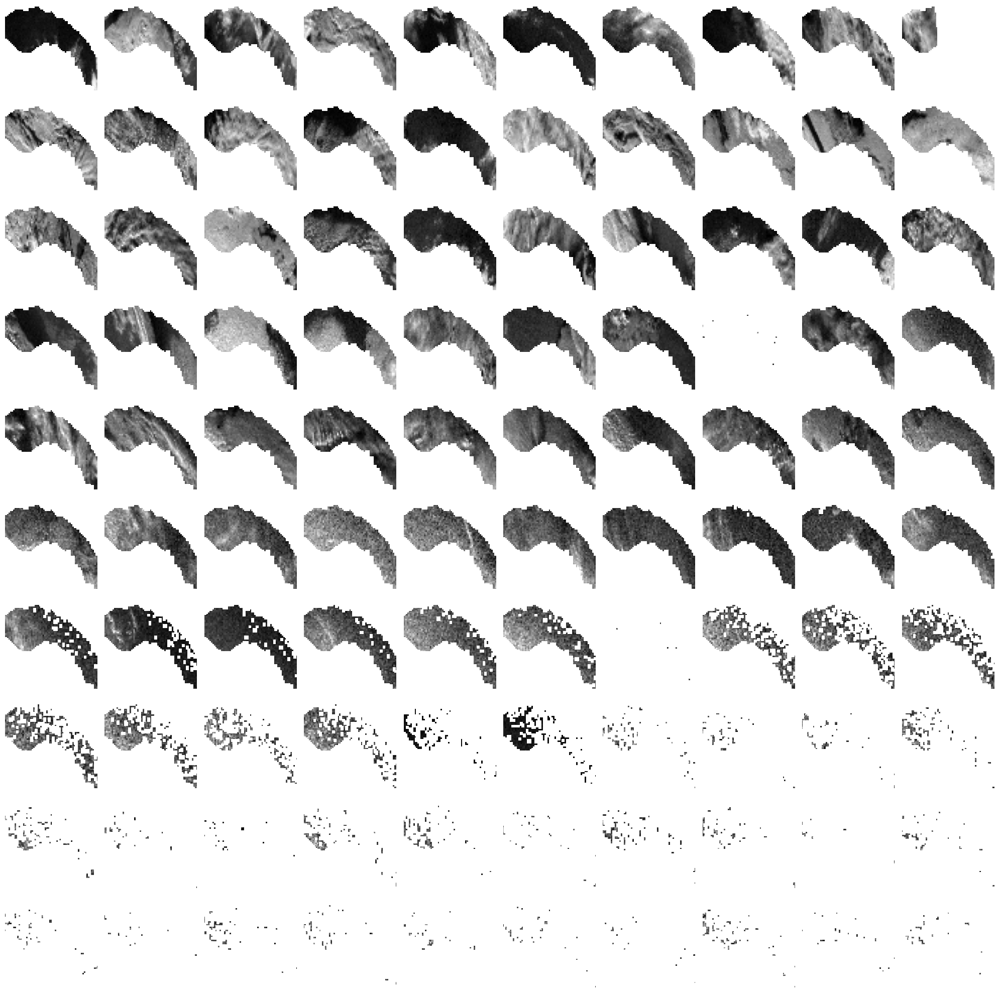

In [58]:
import matplotlib.pyplot as plt

fig, axes = plt.subplots(nrows=10, ncols=10, figsize=(20, 20))  
axes = axes.flatten()
for i in range(100):
    ax = axes[i]
    ax.imshow(array_3d[i], cmap='gray') 
    ax.axis('off')
plt.tight_layout()
plt.show()

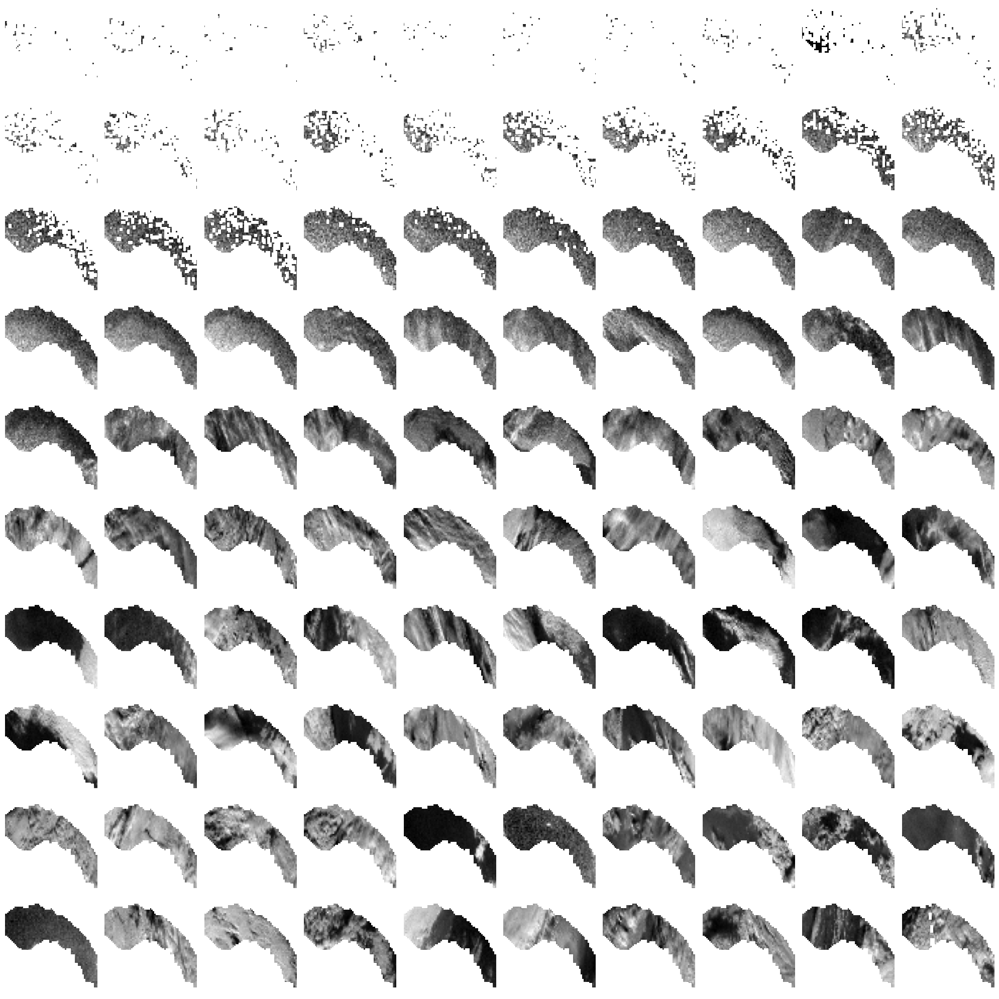

In [59]:
fig, axes = plt.subplots(nrows=10, ncols=10, figsize=(20, 20))  
axes = axes.flatten()
for i in range(100):
    ax = axes[i]
    ax.imshow(array_3d[i+100], cmap='gray') 
    ax.axis('off')
plt.tight_layout()
plt.show()

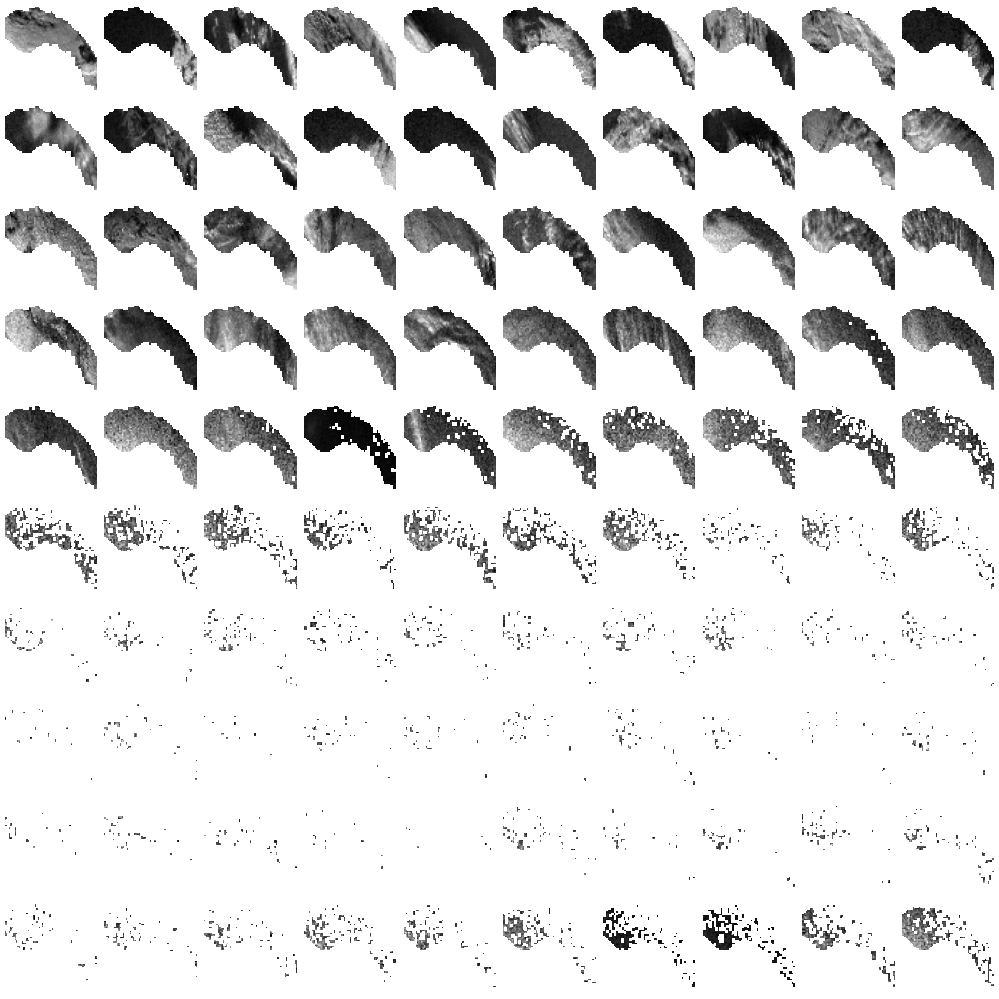

In [60]:
fig, axes = plt.subplots(nrows=10, ncols=10, figsize=(20, 20))  
axes = axes.flatten()
for i in range(100):
    ax = axes[i]
    ax.imshow(array_3d[i+200], cmap='gray') 
    ax.axis('off')
plt.tight_layout()
plt.show()

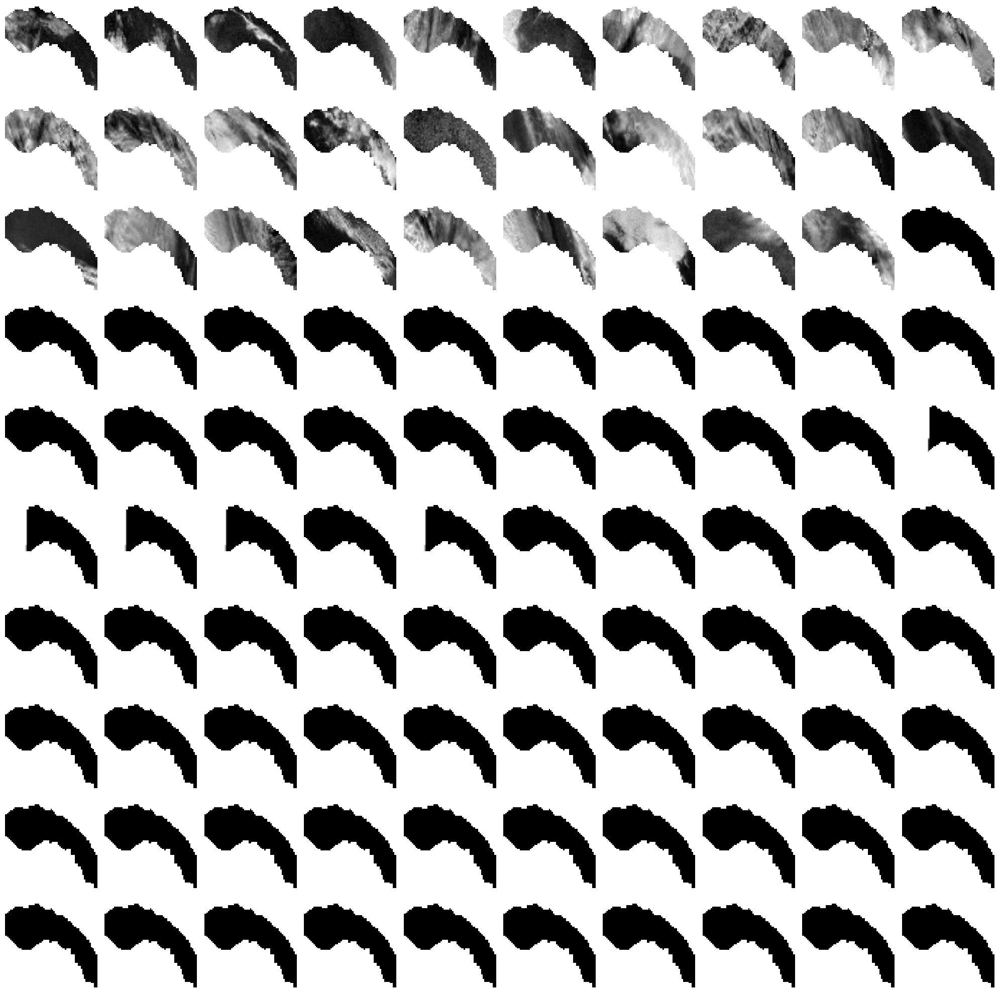

In [61]:
fig, axes = plt.subplots(nrows=10, ncols=10, figsize=(20, 20))  
axes = axes.flatten()
for i in range(100):
    ax = axes[i]
    ax.imshow(array_3d[i+700], cmap='gray') 
    ax.axis('off')
plt.tight_layout()
plt.show()

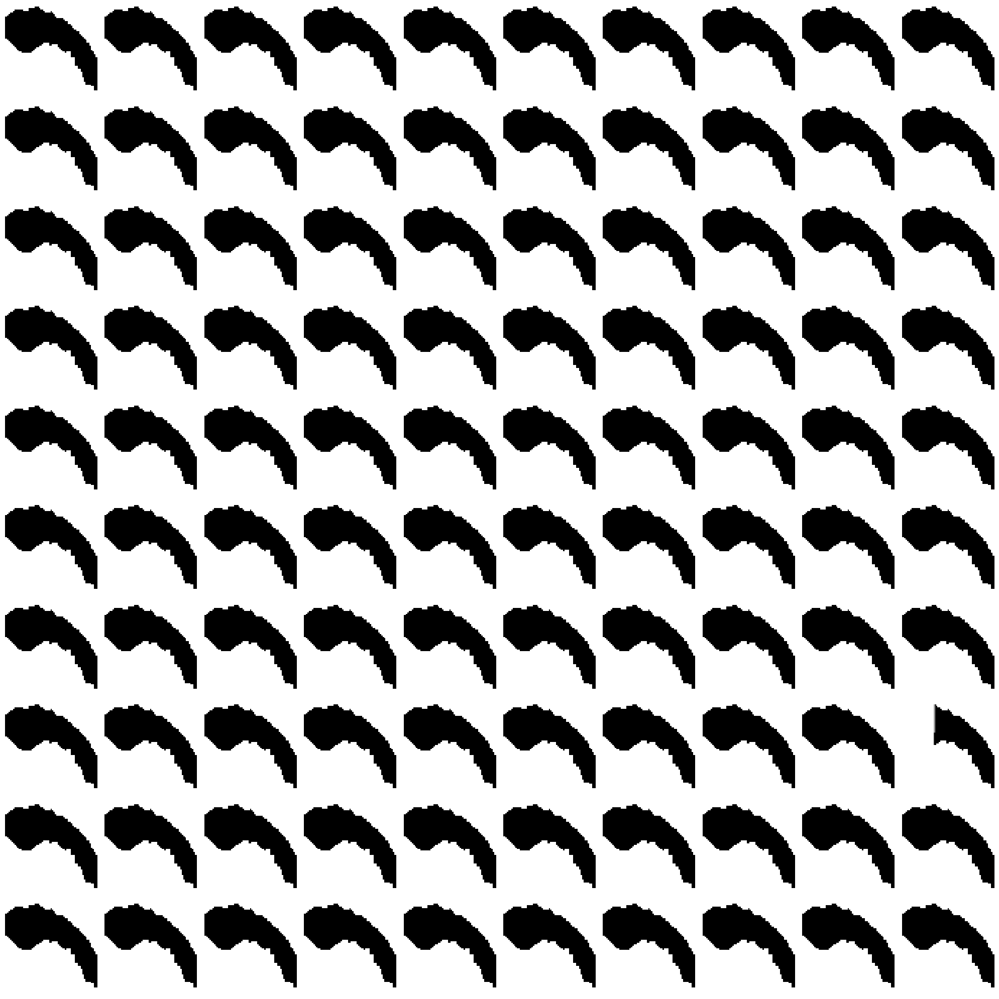

In [62]:
fig, axes = plt.subplots(nrows=10, ncols=10, figsize=(20, 20))  
axes = axes.flatten()
for i in range(100):
    ax = axes[i]
    ax.imshow(array_3d[i+800], cmap='gray') 
    ax.axis('off')
plt.tight_layout()
plt.show()

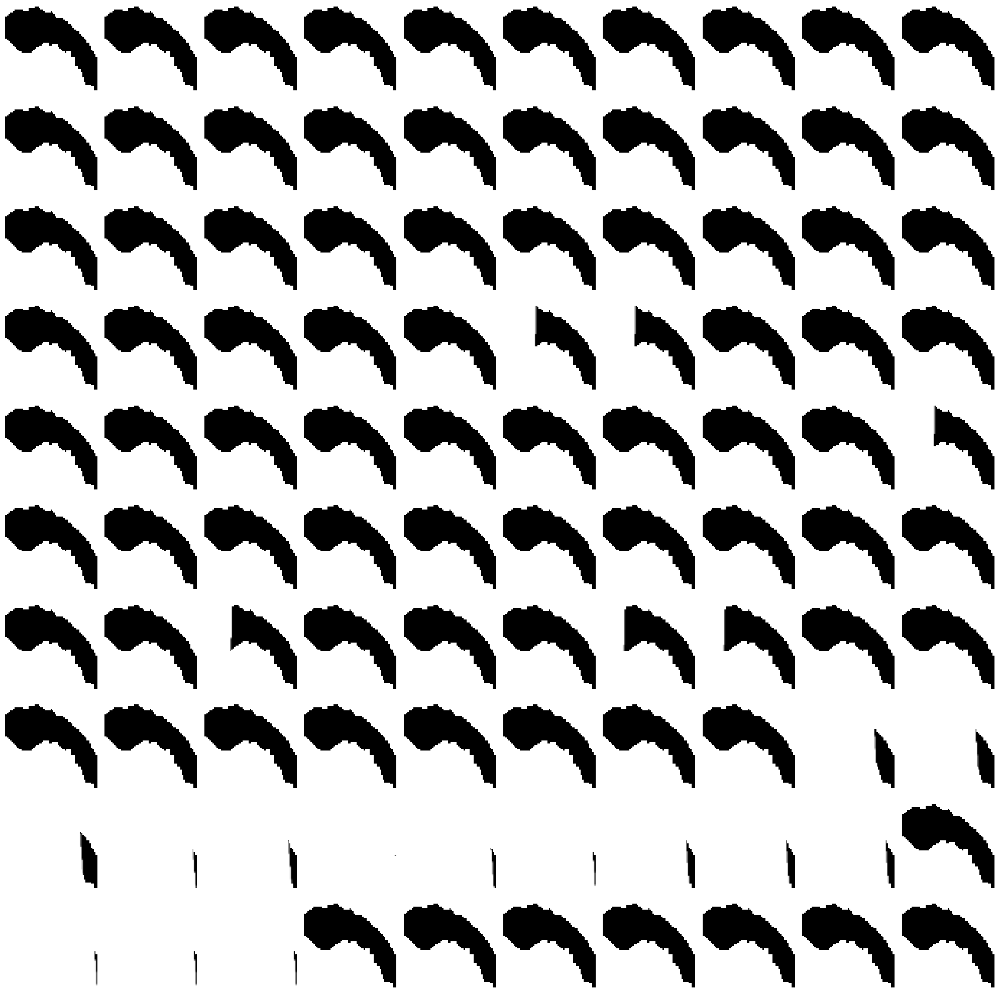

In [63]:
fig, axes = plt.subplots(nrows=10, ncols=10, figsize=(20, 20))  
axes = axes.flatten()
for i in range(100):
    ax = axes[i]
    ax.imshow(array_3d[i+900], cmap='gray') 
    ax.axis('off')
plt.tight_layout()
plt.show()

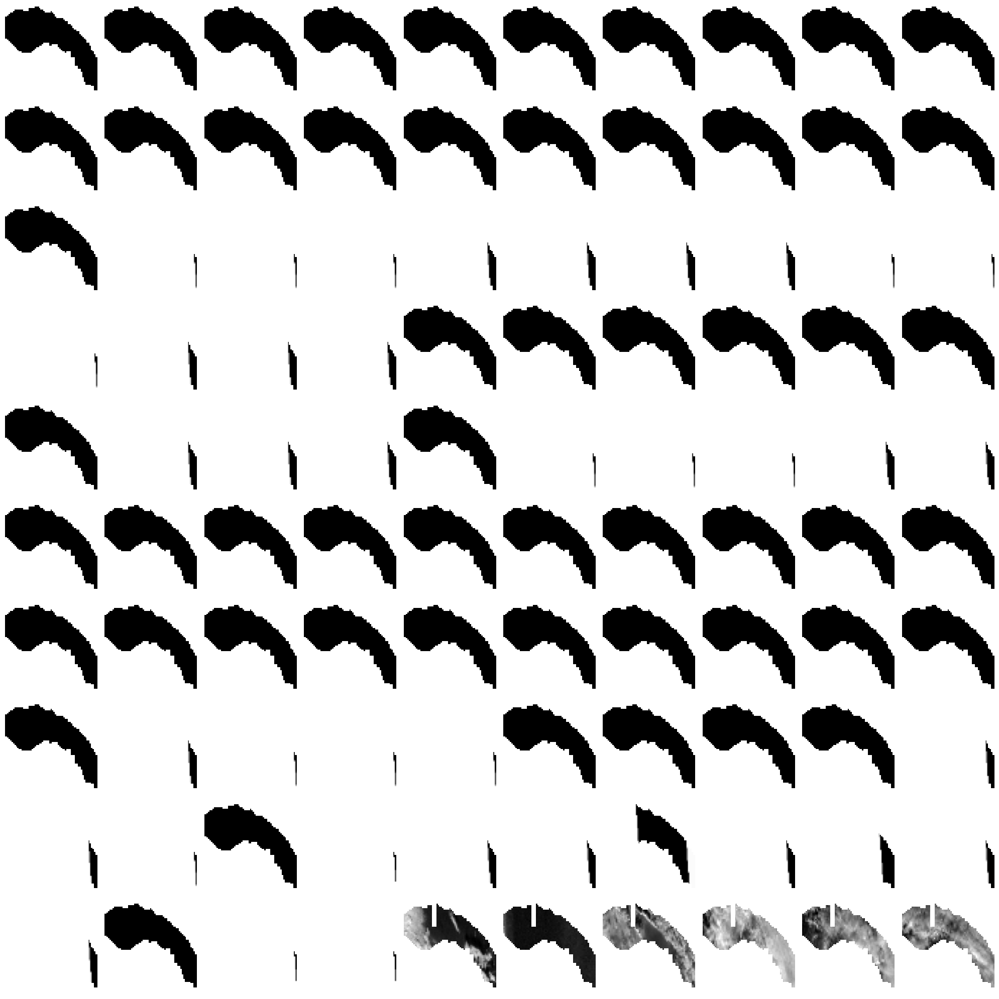

In [64]:
fig, axes = plt.subplots(nrows=10, ncols=10, figsize=(20, 20))  
axes = axes.flatten()
for i in range(100):
    ax = axes[i]
    ax.imshow(array_3d[i+1000], cmap='gray') 
    ax.axis('off')
plt.tight_layout()
plt.show()

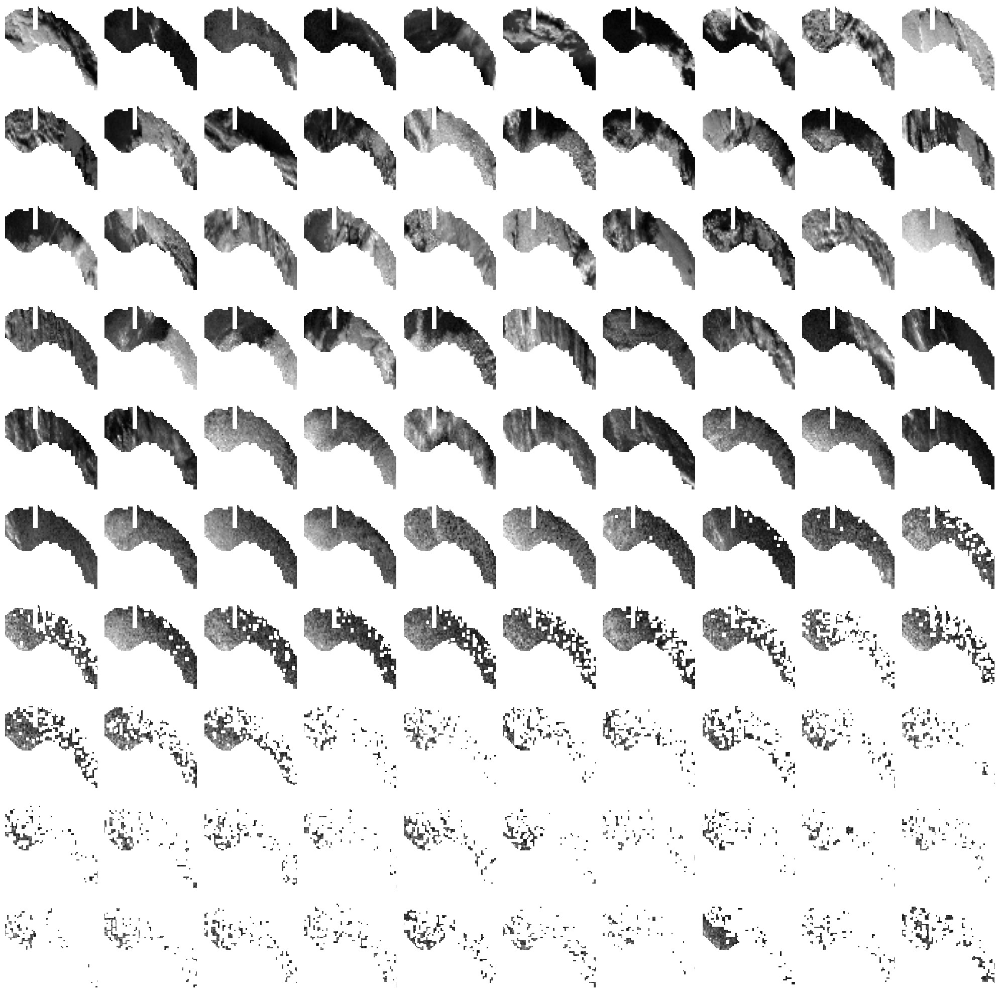

In [65]:
fig, axes = plt.subplots(nrows=10, ncols=10, figsize=(20, 20))  
axes = axes.flatten()
for i in range(100):
    ax = axes[i]
    ax.imshow(array_3d[i+1100], cmap='gray') 
    ax.axis('off')
plt.tight_layout()
plt.show()

**Lot of distortions in the images, so we don't include the image data during 9am**

# 10AM EST

In [66]:
filtered_les = les[(les['DateTime_UTC'].dt.hour == 14)]
filtered_les = filtered_les.reset_index(drop=True)
filtered_les

,DateTime_UTC,Lake_data_1D,Lake_data_2D,Temp_F,RH_pct,Wind_Spd_mph,Wind_Direction_deg,Low_Cloud_Ht_ft,Visibility_mi,Atm_Press_hPa,Precip_in
0,2006-10-01 14:00:00,"[0.067499995, 0.07, 0.0625, 0.06, 0.0725, 0.06...","[array([ nan, nan, nan, ...",60.0,49.0,10,270,3600,10,994.7,0.0
1,2006-10-02 14:00:00,"[0.37, 0.325, 0.2575, 0.2075, 0.2175, 0.295, 0...","[array([ nan, nan, nan, nan, nan, n...",75.0,53.0,15,220,5000,10,989.7,0.0
2,2006-10-03 14:00:00,"[0.1575, 0.1375, 0.13, 0.1325, 0.1325, 0.1275,...","[array([ nan, nan, nan, nan, nan, nan, n...",69.0,67.0,6,30,5000,10,994.3,0.0
3,2006-10-04 14:00:00,"[0.4525, 0.4075, 0.42999998, 0.45749998, 0.475...","[array([ nan, nan, nan, nan, nan, n...",55.0,66.0,13,30,2600,10,1000.3,0.0
4,2006-10-05 14:00:00,"[0.2725, 0.24749999, 0.24499999, 0.24499999, 0...","[array([ nan, nan, nan, nan, nan...",54.0,48.0,10,50,5000,10,1005.3,0.0
...,...,...,...,...,...,...,...,...,...,...,...
2000,2017-03-27 14:00:00,"[0.5475, 0.53249997, 0.5675, 0.5775, 0.555, 0....","[array([ nan, nan, nan, nan, nan, n...",40.0,85.0,6,30,700,10,990.3,0.0
2001,2017-03-28 14:00:00,"[0.56, 0.53999996, 0.5275, 0.525, 0.53249997, ...","[array([ nan, nan, nan, nan, nan...",44.0,70.0,9,30,1700,10,998.3,0.0
2002,2017-03-29 14:00:00,"[0.4425, 0.4475, 0.42249998, 0.4175, 0.405, 0....","[array([ nan, nan, nan, ...",41.0,73.0,5,20,17000,10,1003.3,0.0
2003,2017-03-30 14:00:00,"[0.55, 0.53999996, 0.56, 0.57, 0.5575, 0.53749...","[array([ nan, nan, nan, nan, nan...",40.0,69.0,14,100,4100,10,990.0,0.0


**Create the imagea arrays and lables for the `filtered_les_data` which is of only day time data**

In [67]:
array_3d = get_3d_array(filtered_les)

Processing arrays: 100%|███████████████████████████████████████████████████████████| 2005/2005 [00:55<00:00, 35.84it/s]


In [68]:
array_3d.shape

(2005, 64, 64, 1)

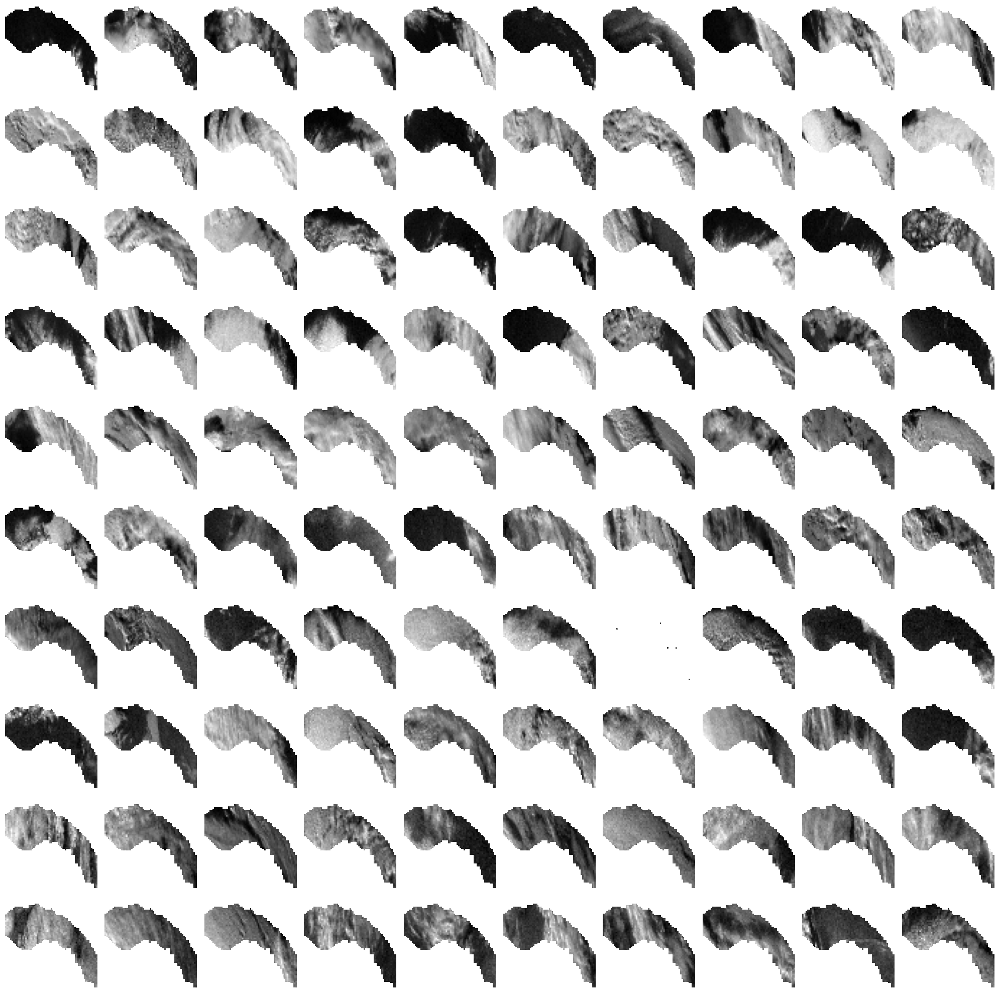

In [69]:
import matplotlib.pyplot as plt

fig, axes = plt.subplots(nrows=10, ncols=10, figsize=(20, 20))  
axes = axes.flatten()
for i in range(100):
    ax = axes[i]
    ax.imshow(array_3d[i], cmap='gray') 
    ax.axis('off')
plt.tight_layout()
plt.show()

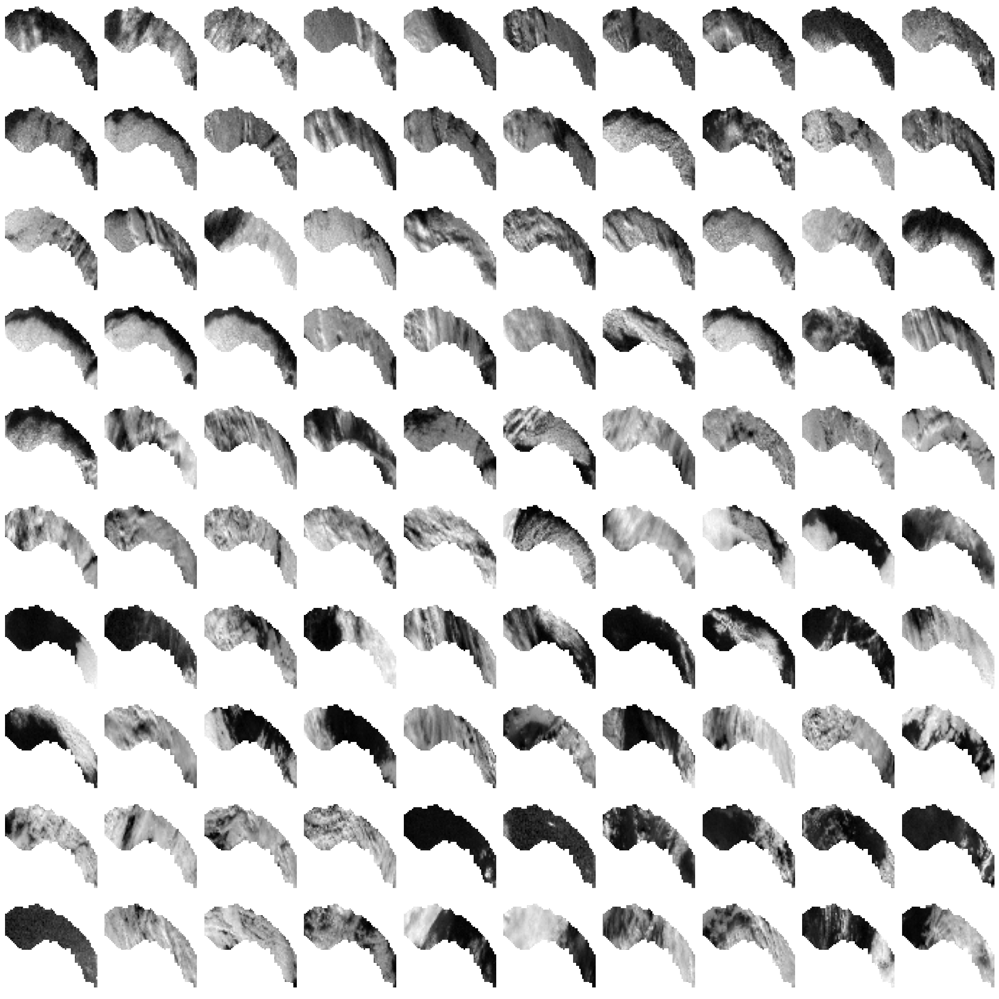

In [70]:
fig, axes = plt.subplots(nrows=10, ncols=10, figsize=(20, 20))  
axes = axes.flatten()
for i in range(100):
    ax = axes[i]
    ax.imshow(array_3d[i+100], cmap='gray') 
    ax.axis('off')
plt.tight_layout()
plt.show()

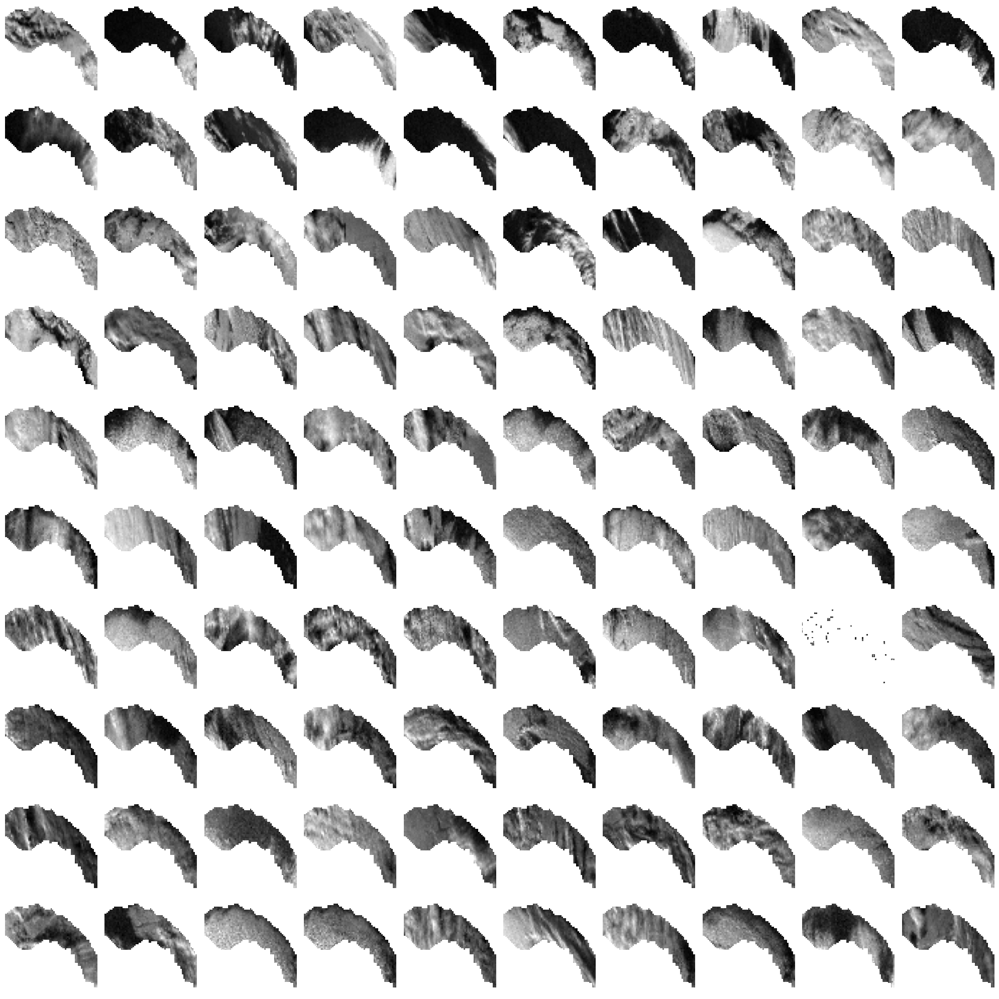

In [71]:
fig, axes = plt.subplots(nrows=10, ncols=10, figsize=(20, 20))  
axes = axes.flatten()
for i in range(100):
    ax = axes[i]
    ax.imshow(array_3d[i+200], cmap='gray') 
    ax.axis('off')
plt.tight_layout()
plt.show()

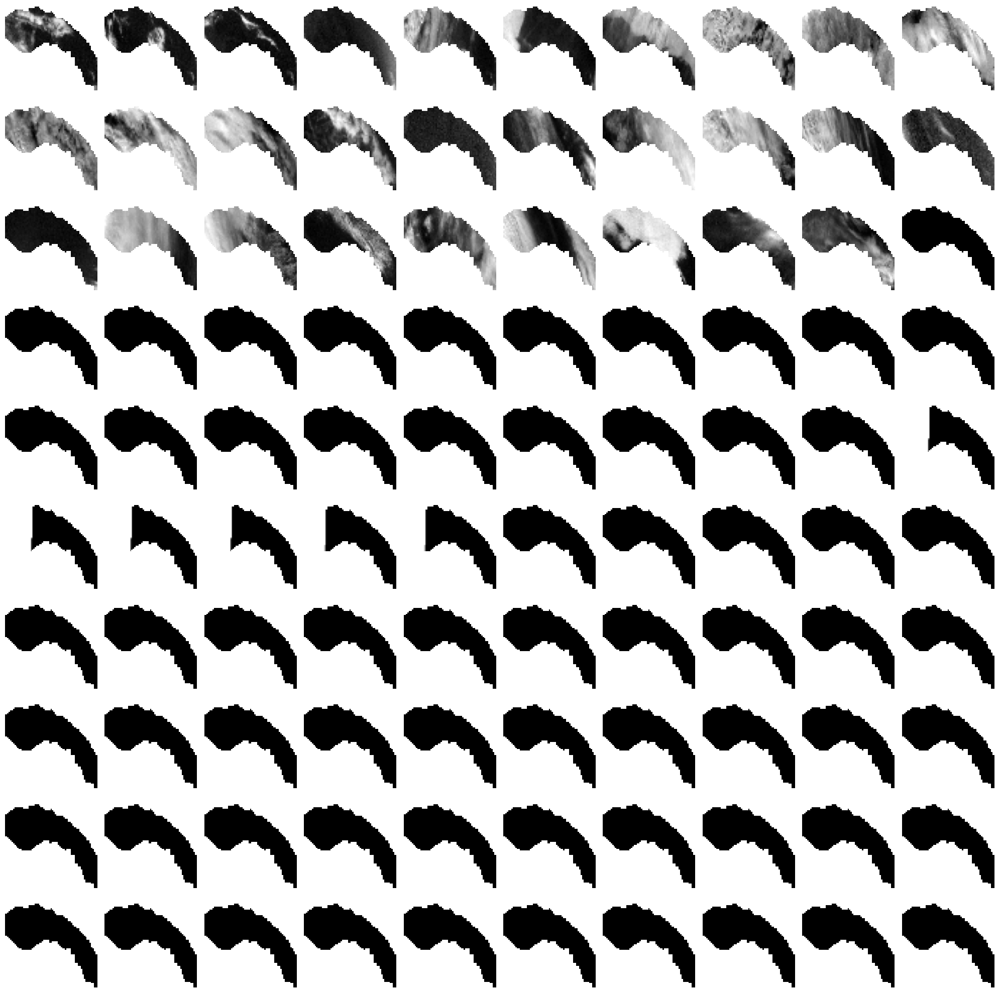

In [72]:
fig, axes = plt.subplots(nrows=10, ncols=10, figsize=(20, 20))  
axes = axes.flatten()
for i in range(100):
    ax = axes[i]
    ax.imshow(array_3d[i+700], cmap='gray') 
    ax.axis('off')
plt.tight_layout()
plt.show()

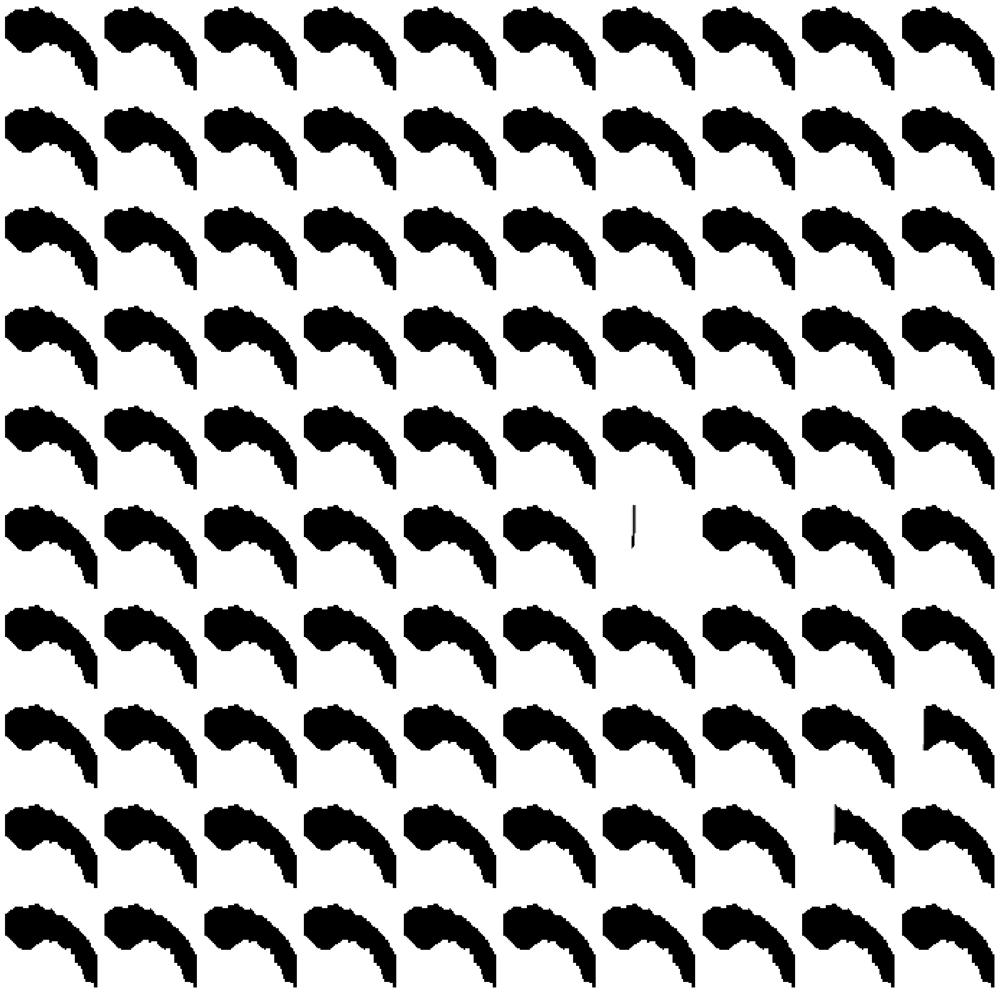

In [73]:
fig, axes = plt.subplots(nrows=10, ncols=10, figsize=(20, 20))  
axes = axes.flatten()
for i in range(100):
    ax = axes[i]
    ax.imshow(array_3d[i+800], cmap='gray') 
    ax.axis('off')
plt.tight_layout()
plt.show()

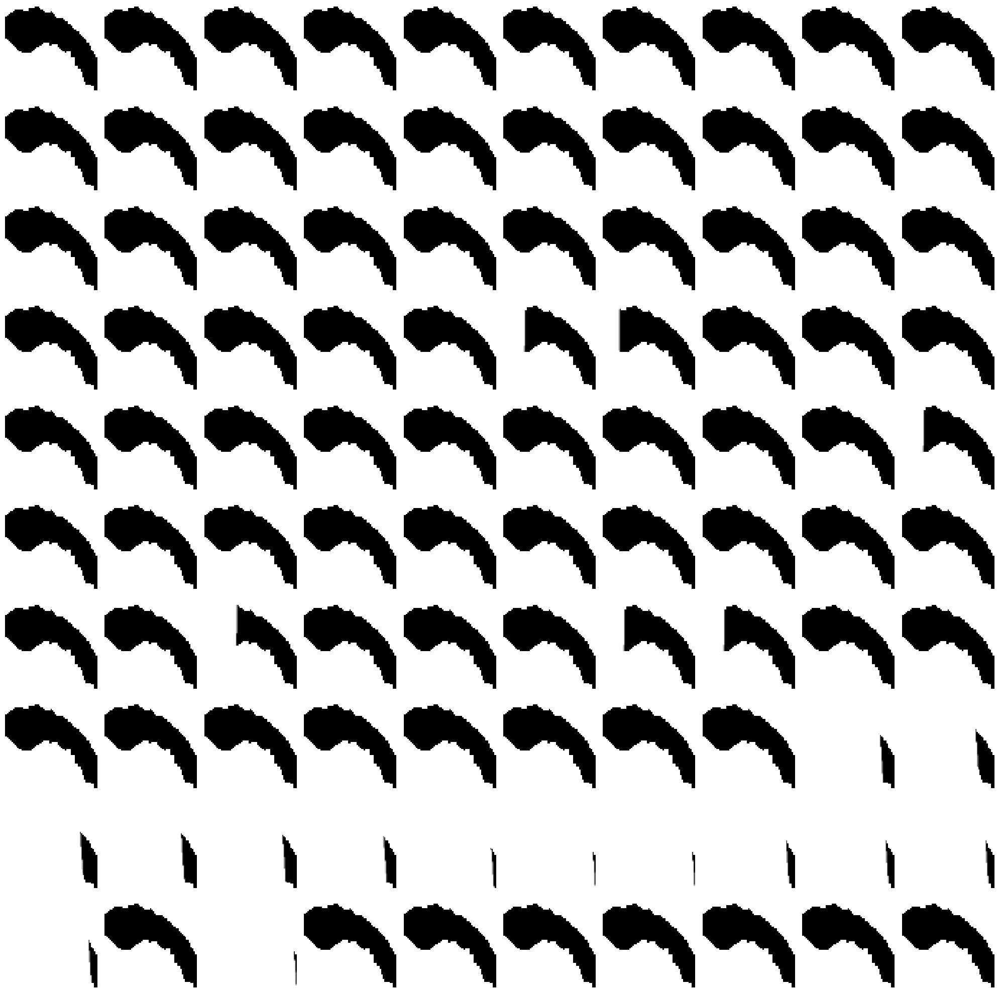

In [74]:
fig, axes = plt.subplots(nrows=10, ncols=10, figsize=(20, 20))  
axes = axes.flatten()
for i in range(100):
    ax = axes[i]
    ax.imshow(array_3d[i+900], cmap='gray') 
    ax.axis('off')
plt.tight_layout()
plt.show()

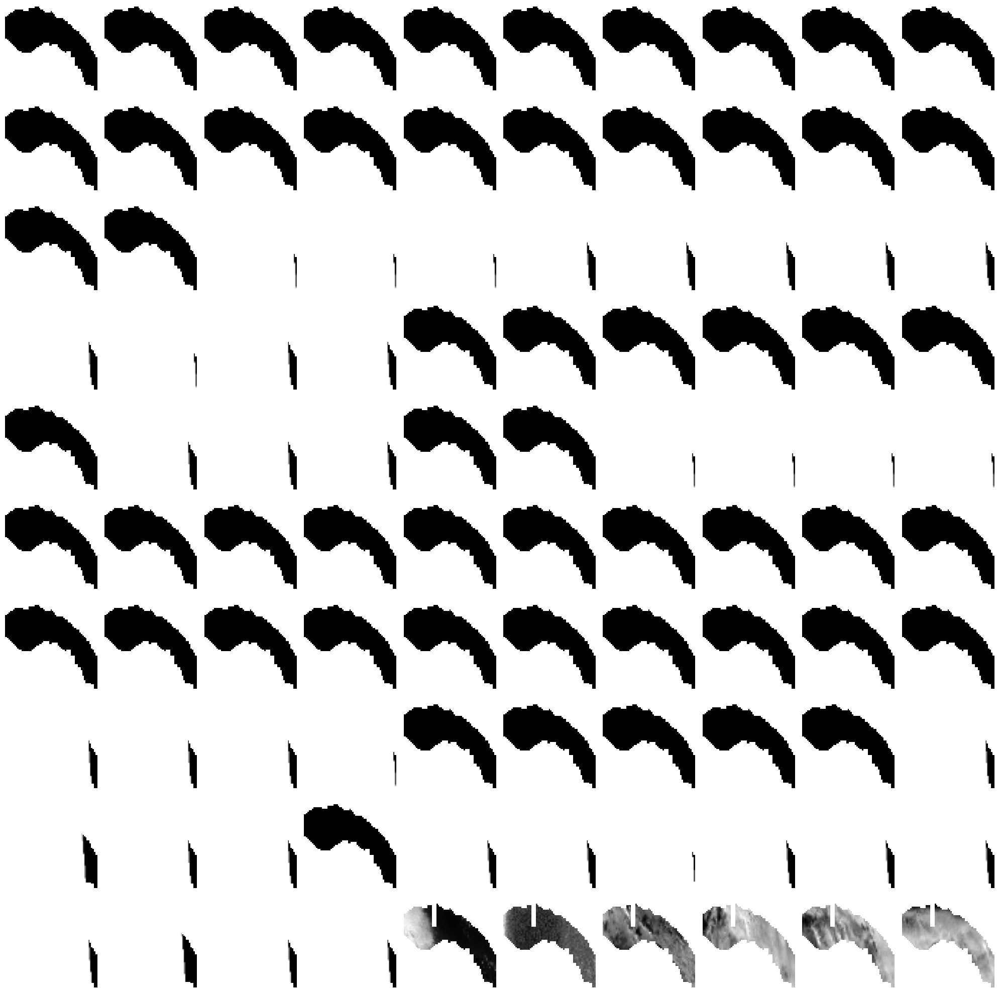

In [75]:
fig, axes = plt.subplots(nrows=10, ncols=10, figsize=(20, 20))  
axes = axes.flatten()
for i in range(100):
    ax = axes[i]
    ax.imshow(array_3d[i+1000], cmap='gray') 
    ax.axis('off')
plt.tight_layout()
plt.show()

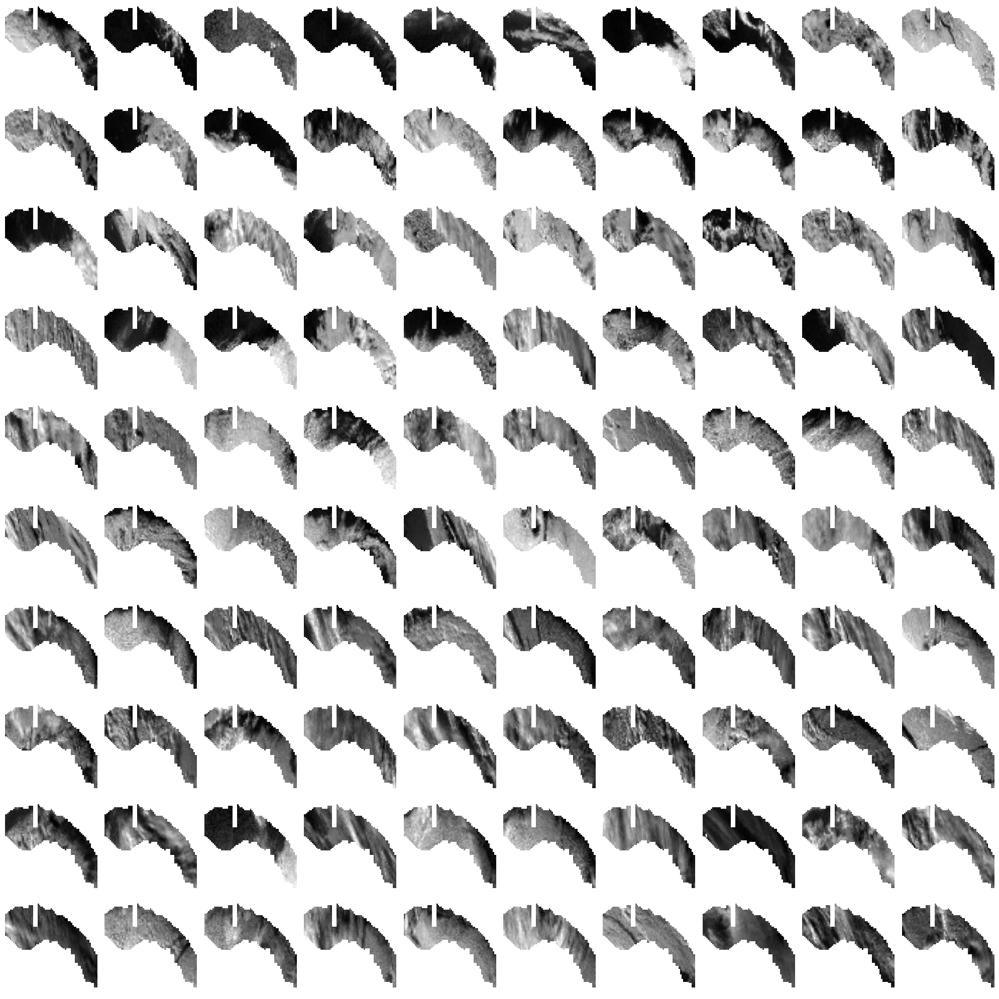

In [76]:
fig, axes = plt.subplots(nrows=10, ncols=10, figsize=(20, 20))  
axes = axes.flatten()
for i in range(100):
    ax = axes[i]
    ax.imshow(array_3d[i+1100], cmap='gray') 
    ax.axis('off')
plt.tight_layout()
plt.show()

**Colud images are good enough but at particular time periods all the cloud images are dark, let's examine for few other time periods and see if this repeats**

# Let's check at 2PM EST

In [77]:
filtered_les = les[(les['DateTime_UTC'].dt.hour == 18)]
filtered_les = filtered_les.reset_index(drop=True)
filtered_les

,DateTime_UTC,Lake_data_1D,Lake_data_2D,Temp_F,RH_pct,Wind_Spd_mph,Wind_Direction_deg,Low_Cloud_Ht_ft,Visibility_mi,Atm_Press_hPa,Precip_in
0,2006-10-01 18:00:00,"[0.085, 0.085, 0.0875, 0.0725, 0.0775, 0.0775,...","[array([ nan, nan, nan, nan, nan...",50.0,82.0,0,0,8000,10,994.7,0.00
1,2006-10-02 18:00:00,"[0.16749999, 0.1375, 0.1275, 0.114999995, 0.12...","[array([ nan, nan, nan, nan, nan...",69.0,67.0,3,210,0,10,990.7,0.00
2,2006-10-03 18:00:00,"[0.13499999, 0.12, 0.122499995, 0.1375, 0.1575...","[array([ nan, nan, nan, ...",58.0,90.0,0,0,4300,10,994.0,0.00
3,2006-10-04 18:00:00,"[0.615, 0.64, 0.515, 0.55, 0.4775, 0.2775, 0.3...","[array([ nan, nan, nan, ...",53.0,56.0,9,350,3800,10,1003.0,0.00
4,2006-10-05 18:00:00,"[0.295, 0.235, 0.1475, 0.1375, 0.2025, 0.2025,...","[array([ nan, nan, nan, nan, nan...",44.0,76.0,0,0,0,10,1006.0,0.00
...,...,...,...,...,...,...,...,...,...,...,...
2000,2017-03-27 18:00:00,"[0.895, 0.89, 0.85749996, 0.85749996, 0.865, 0...","[array([ nan, nan, nan, ...",39.0,81.0,5,350,800,10,991.7,0.00
2001,2017-03-28 18:00:00,"[0.59749997, 0.59999996, 0.60749996, 0.5725, 0...","[array([ nan, nan, nan, ...",38.0,85.0,6,10,20000,10,999.6,0.00
2002,2017-03-29 18:00:00,"[0.72999996, 0.72249997, 0.755, 0.78, 0.7775, ...","[array([ nan, nan, nan, ...",39.0,72.0,0,0,14000,10,1000.0,0.00
2003,2017-03-30 18:00:00,"[1.14, 1.13, 1.2825, 1.13, 1.0849999, 0.955, 1...","[array([ nan, nan, nan, nan, nan...",34.0,92.0,9,60,1300,2,988.7,0.06


In [78]:
array_3d = get_3d_array(filtered_les)

Processing arrays: 100%|███████████████████████████████████████████████████████████| 2005/2005 [01:00<00:00, 32.94it/s]


In [79]:
array_3d.shape

(2005, 64, 64, 1)

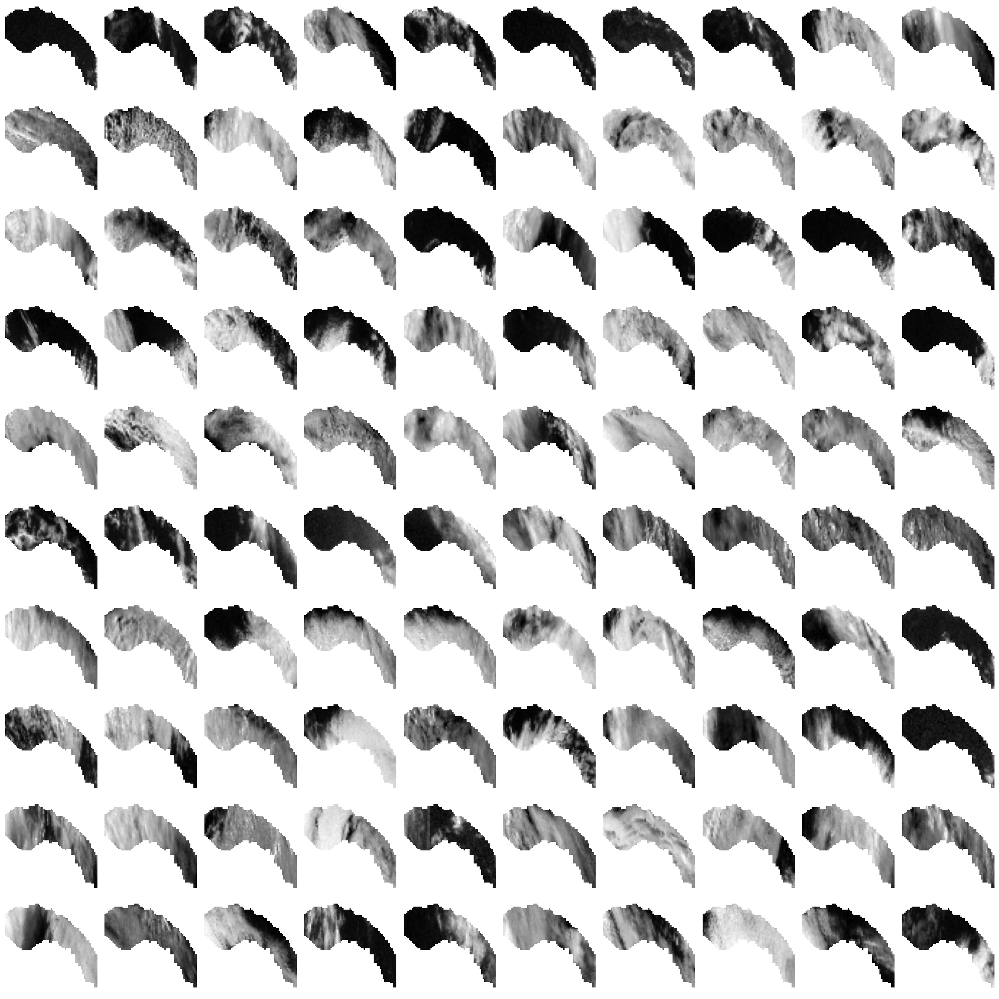

In [80]:
import matplotlib.pyplot as plt

fig, axes = plt.subplots(nrows=10, ncols=10, figsize=(20, 20))  
axes = axes.flatten()
for i in range(100):
    ax = axes[i]
    ax.imshow(array_3d[i], cmap='gray') 
    ax.axis('off')
plt.tight_layout()
plt.show()

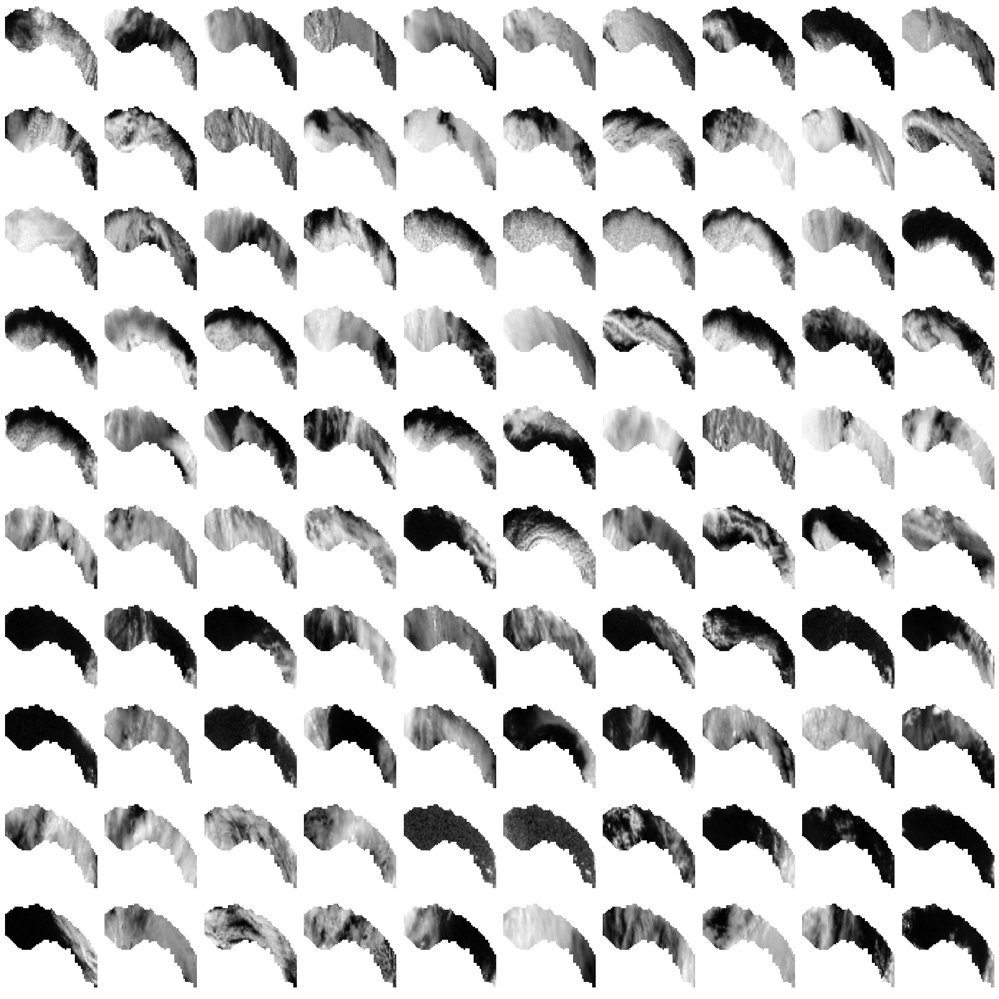

In [81]:
fig, axes = plt.subplots(nrows=10, ncols=10, figsize=(20, 20))  
axes = axes.flatten()
for i in range(100):
    ax = axes[i]
    ax.imshow(array_3d[i+100], cmap='gray') 
    ax.axis('off')
plt.tight_layout()
plt.show()

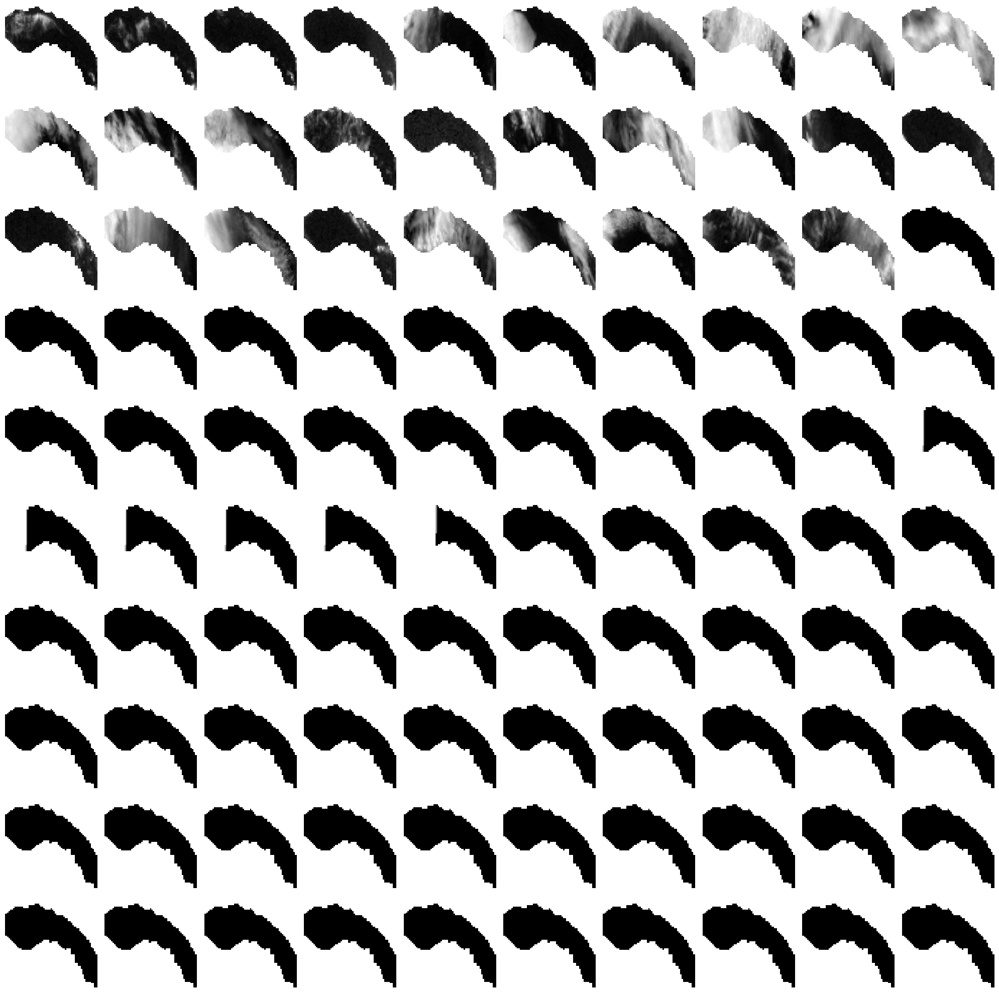

In [82]:
fig, axes = plt.subplots(nrows=10, ncols=10, figsize=(20, 20))  
axes = axes.flatten()
for i in range(100):
    ax = axes[i]
    ax.imshow(array_3d[i+700], cmap='gray') 
    ax.axis('off')
plt.tight_layout()
plt.show()

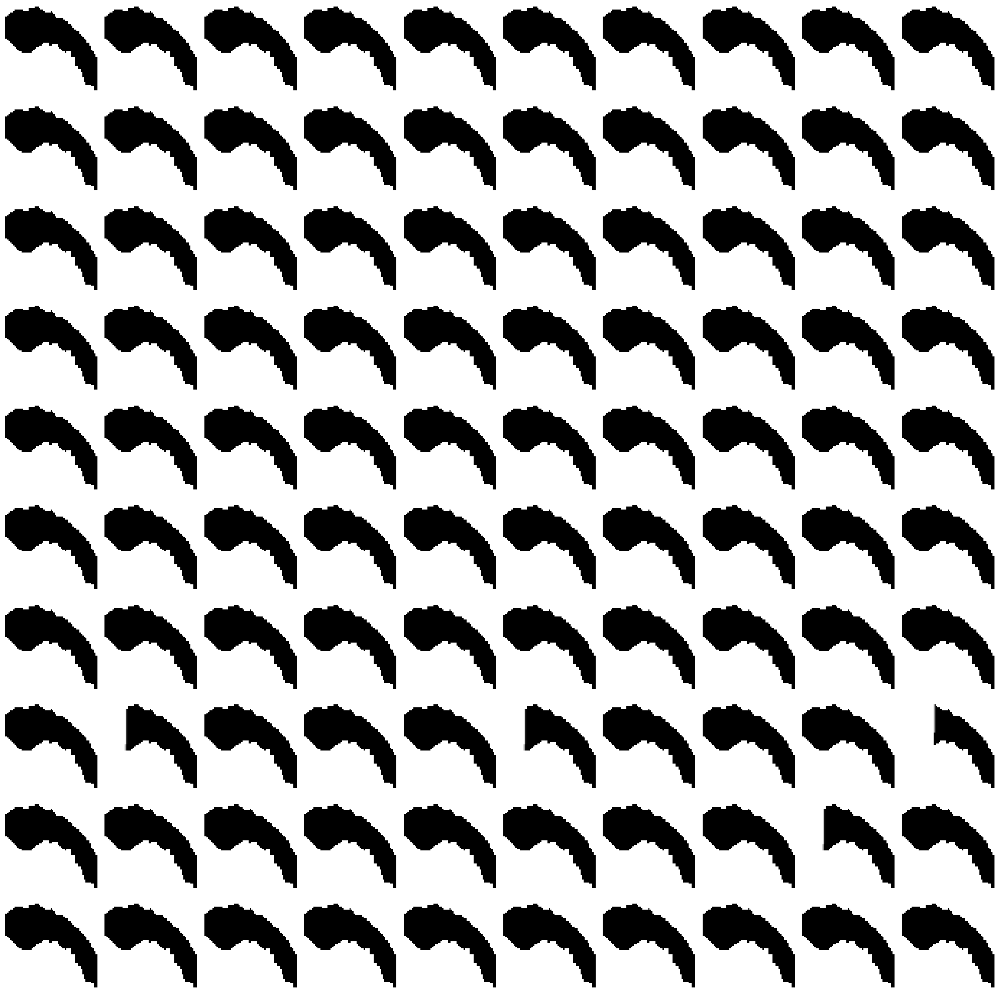

In [83]:
fig, axes = plt.subplots(nrows=10, ncols=10, figsize=(20, 20))  
axes = axes.flatten()
for i in range(100):
    ax = axes[i]
    ax.imshow(array_3d[i+800], cmap='gray') 
    ax.axis('off')
plt.tight_layout()
plt.show()

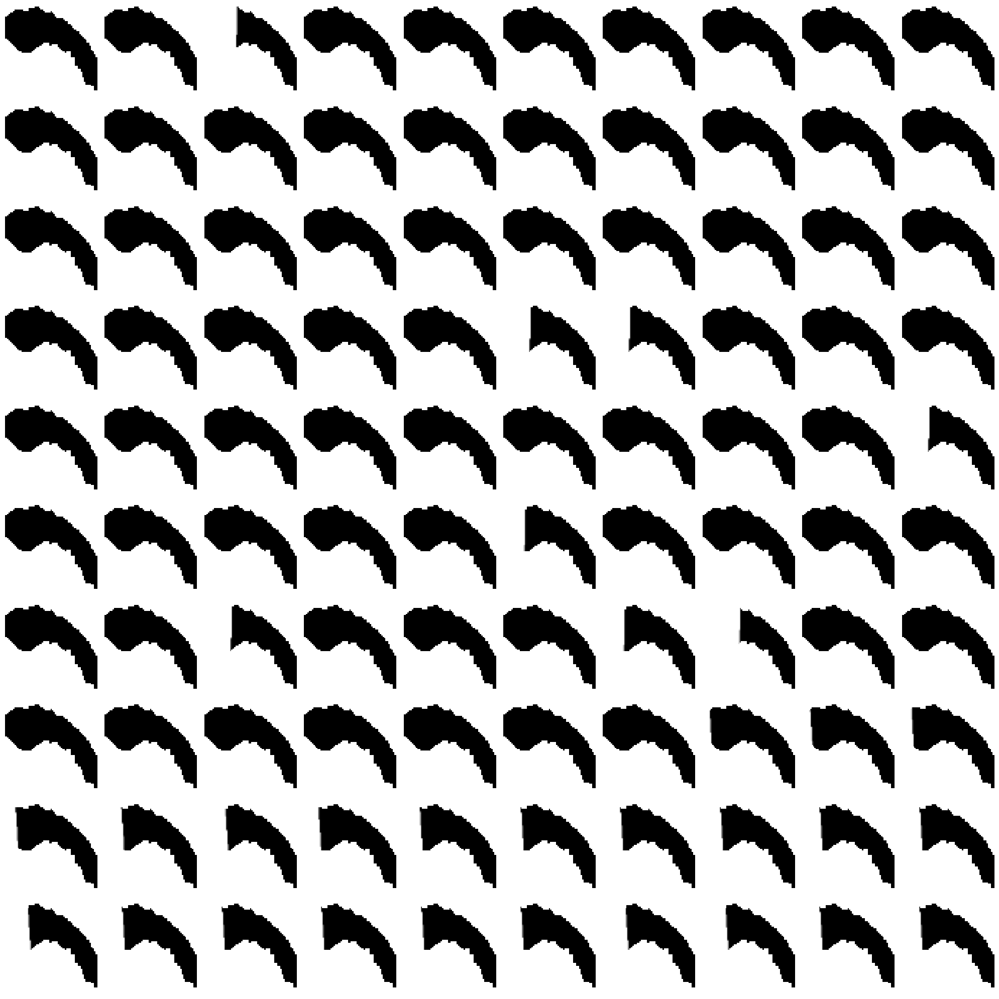

In [84]:
fig, axes = plt.subplots(nrows=10, ncols=10, figsize=(20, 20))  
axes = axes.flatten()
for i in range(100):
    ax = axes[i]
    ax.imshow(array_3d[i+900], cmap='gray') 
    ax.axis('off')
plt.tight_layout()
plt.show()

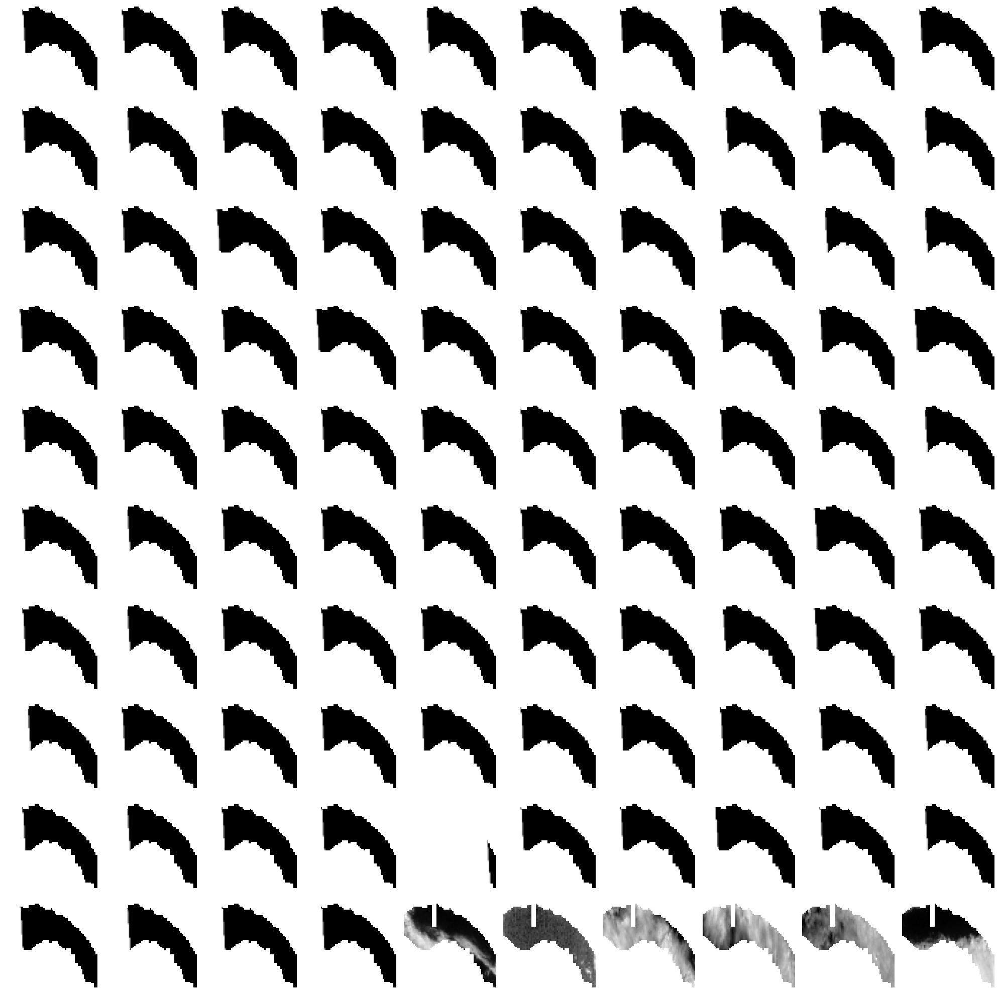

In [85]:
fig, axes = plt.subplots(nrows=10, ncols=10, figsize=(20, 20))  
axes = axes.flatten()
for i in range(100):
    ax = axes[i]
    ax.imshow(array_3d[i+1000], cmap='gray') 
    ax.axis('off')
plt.tight_layout()
plt.show()

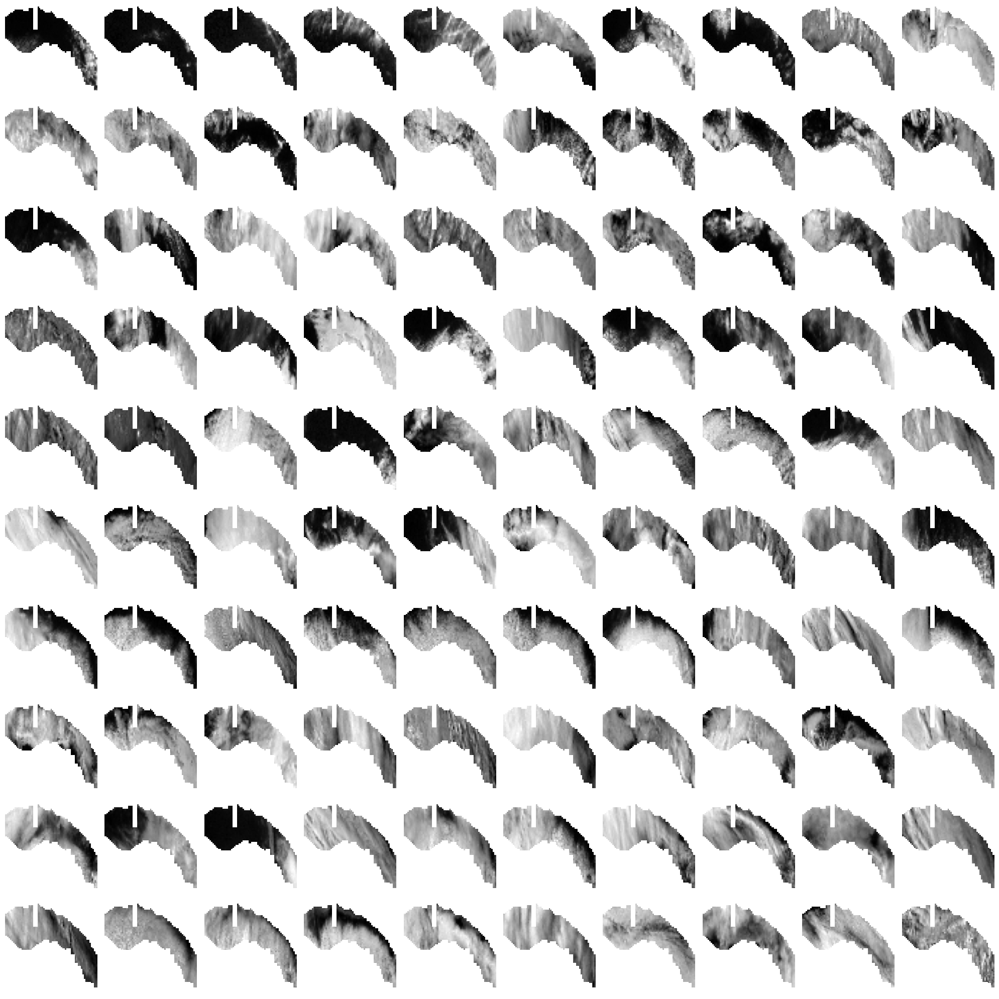

In [86]:
fig, axes = plt.subplots(nrows=10, ncols=10, figsize=(20, 20))  
axes = axes.flatten()
for i in range(100):
    ax = axes[i]
    ax.imshow(array_3d[i+1100], cmap='gray') 
    ax.axis('off')
plt.tight_layout()
plt.show()

**Same problem during this time too, the colud images are all dark during perticluar time period**

# 5PM EST

In [87]:
filtered_les = les[(les['DateTime_UTC'].dt.hour == 21)]
filtered_les = filtered_les.reset_index(drop=True)
filtered_les

,DateTime_UTC,Lake_data_1D,Lake_data_2D,Temp_F,RH_pct,Wind_Spd_mph,Wind_Direction_deg,Low_Cloud_Ht_ft,Visibility_mi,Atm_Press_hPa,Precip_in
0,2006-10-01 21:00:00,"[0.11, 0.105, 0.0975, 0.107499994, 0.099999994...","[array([ nan, nan, nan, ...",49.0,79.0,3,130,11000,10,994.3,0.00
1,2006-10-02 21:00:00,"[0.66249996, 0.6225, 0.6275, 0.5625, 0.5225, 0...","[array([ nan, nan, nan, nan, nan, n...",68.0,70.0,6,0,0,10,991.0,0.00
2,2006-10-03 21:00:00,"[0.1525, 0.1325, 0.1375, 0.1325, 0.13499999, 0...","[array([ nan, nan, nan, nan, nan, n...",57.0,93.0,0,0,4700,8,989.7,0.00
3,2006-10-04 21:00:00,"[0.39749998, 0.42499998, 0.42249998, 0.4624999...","[array([ nan, nan, nan, ...",52.0,63.0,11,40,0,10,1004.0,0.00
4,2006-10-05 21:00:00,"[0.255, 0.16, 0.2025, 0.285, 0.21249999, 0.214...","[array([ nan, nan, nan, nan, nan...",38.0,92.0,0,0,0,10,1007.0,0.00
...,...,...,...,...,...,...,...,...,...,...,...
2000,2017-03-27 21:00:00,"[0.6125, 0.60749996, 0.6225, 0.6275, 0.6375, 0...","[array([ nan, nan, nan, nan, nan...",38.0,89.0,3,10,800,10,992.0,0.00
2001,2017-03-28 21:00:00,"[0.585, 0.585, 0.585, 0.5725, 0.58, 0.5525, 0....","[array([ nan, nan, nan, nan, nan...",32.0,92.0,0,0,20000,10,1000.6,0.00
2002,2017-03-29 21:00:00,"[0.59, 0.59749997, 0.66249996, 0.65999997, 0.6...","[array([ nan, nan, nan, nan, nan, n...",42.0,54.0,8,120,10000,10,1001.3,0.00
2003,2017-03-30 21:00:00,"[0.5525, 0.545, 0.60499996, 0.60249996, 0.5974...","[array([ nan, nan, nan, nan, nan, n...",34.0,92.0,6,50,2000,9,988.0,0.01


In [88]:
def get_3d_array(df):
    array_2d_list = []
    for i in tqdm(range(len(df)), desc="Processing arrays"):
        data_sample_2d = df['Lake_data_2D'].values[i]
        data_sample_2d_array = np.array(eval(data_sample_2d.replace('array(', '').replace('nan', 'np.nan').replace('\n', '').replace(')', '')))
        data_sample_2d_array_resized = cv2.resize(data_sample_2d_array, (64, 64))
        data_sample_2d_array_resized = np.expand_dims(data_sample_2d_array_resized, axis=-1)
        array_2d_list.append(data_sample_2d_array_resized)
    array_3d = np.stack(array_2d_list, axis=0)
    return array_3d

In [89]:
array_3d = get_3d_array(filtered_les)

Processing arrays: 100%|███████████████████████████████████████████████████████████| 2005/2005 [00:57<00:00, 35.14it/s]


In [90]:
array_3d.shape

(2005, 64, 64, 1)

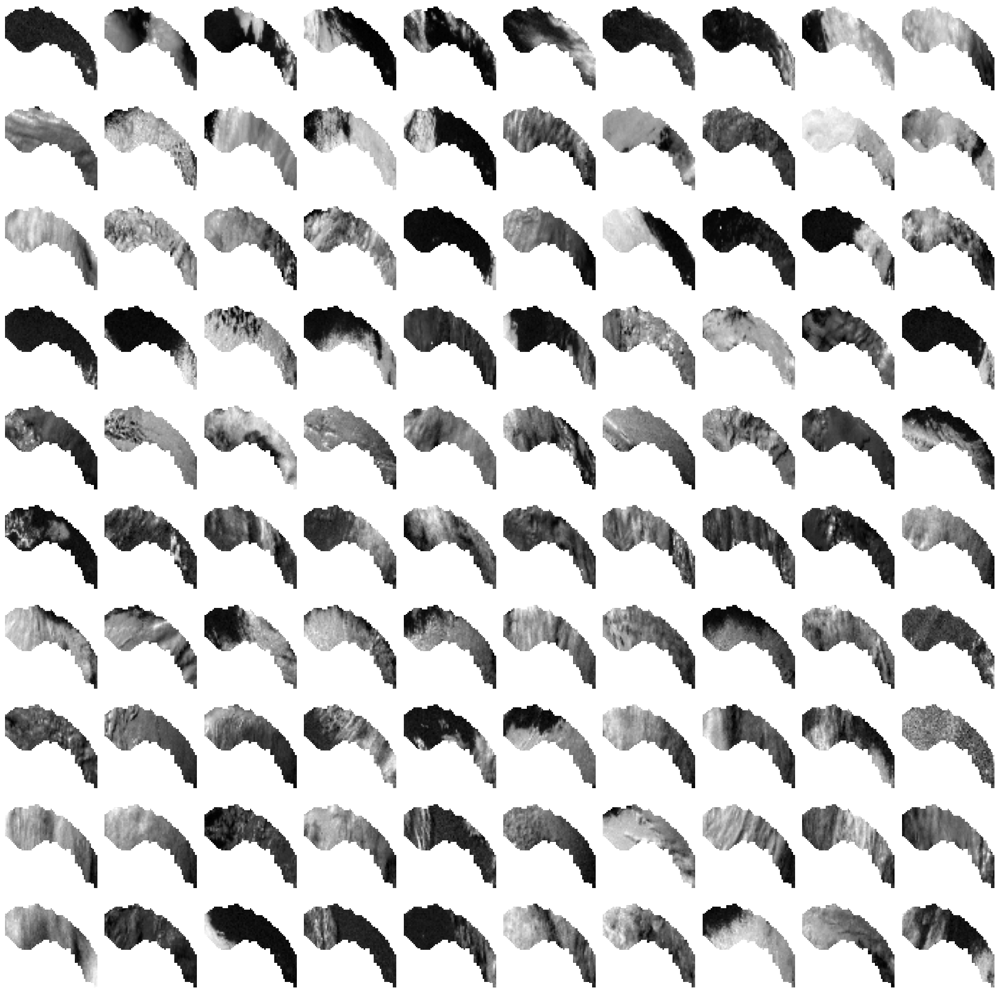

In [91]:
import matplotlib.pyplot as plt

fig, axes = plt.subplots(nrows=10, ncols=10, figsize=(20, 20))  
axes = axes.flatten()
for i in range(100):
    ax = axes[i]
    ax.imshow(array_3d[i], cmap='gray') 
    ax.axis('off')
plt.tight_layout()
plt.show()

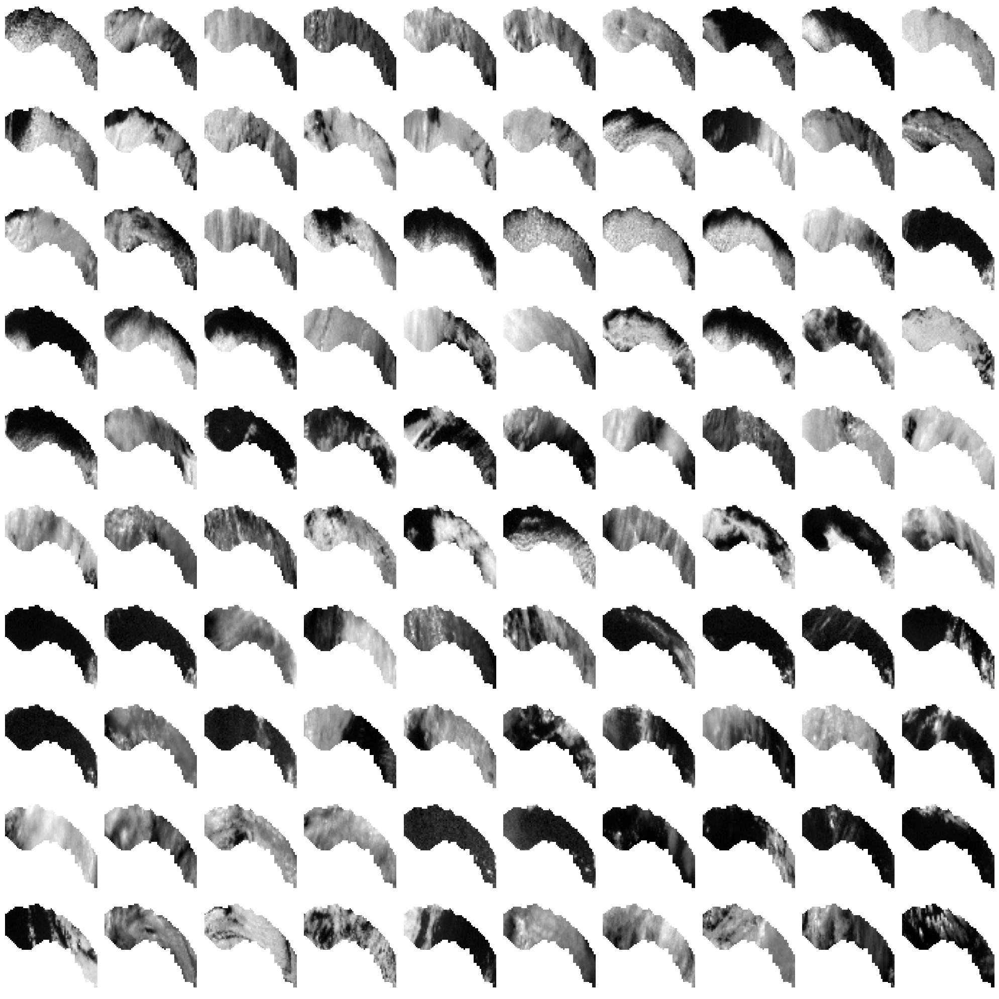

In [92]:
fig, axes = plt.subplots(nrows=10, ncols=10, figsize=(20, 20))  
axes = axes.flatten()
for i in range(100):
    ax = axes[i]
    ax.imshow(array_3d[i+100], cmap='gray') 
    ax.axis('off')
plt.tight_layout()
plt.show()

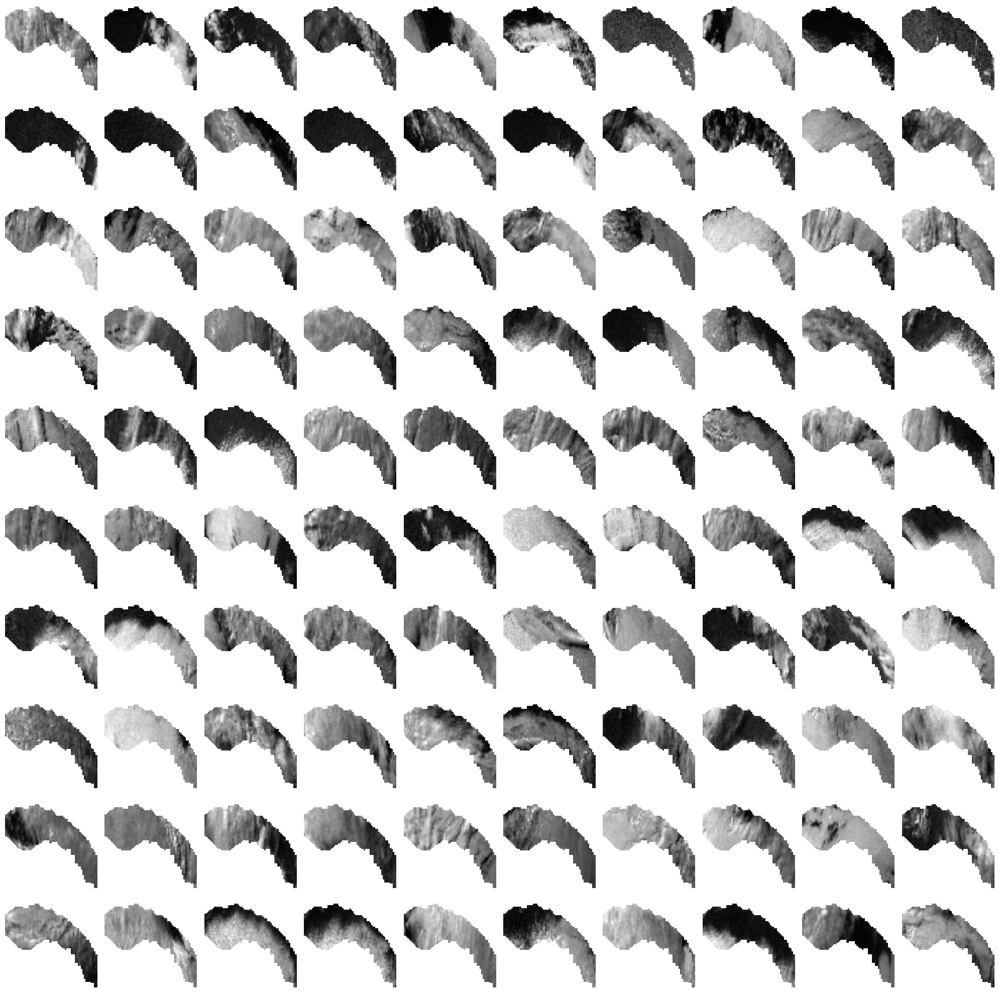

In [93]:
fig, axes = plt.subplots(nrows=10, ncols=10, figsize=(20, 20))  
axes = axes.flatten()
for i in range(100):
    ax = axes[i]
    ax.imshow(array_3d[i+200], cmap='gray') 
    ax.axis('off')
plt.tight_layout()
plt.show()

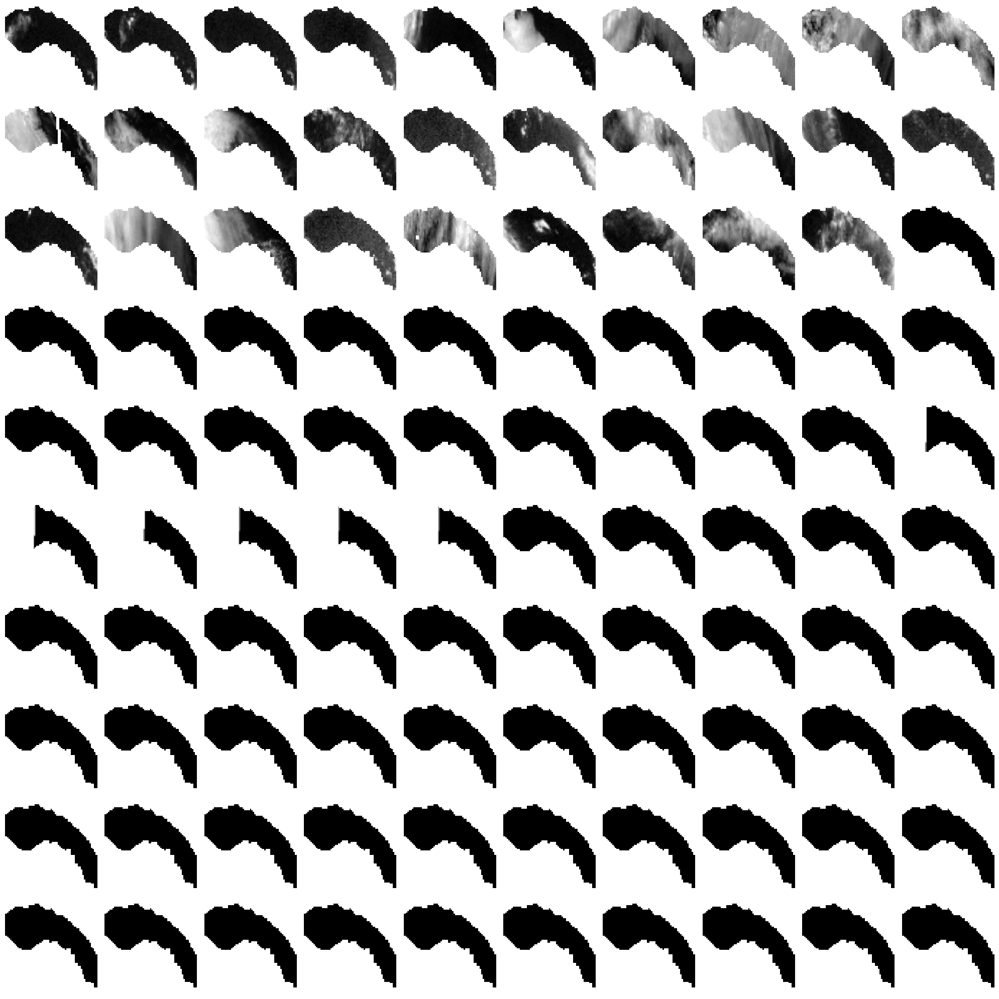

In [94]:
fig, axes = plt.subplots(nrows=10, ncols=10, figsize=(20, 20))  
axes = axes.flatten()
for i in range(100):
    ax = axes[i]
    ax.imshow(array_3d[i+700], cmap='gray') 
    ax.axis('off')
plt.tight_layout()
plt.show()

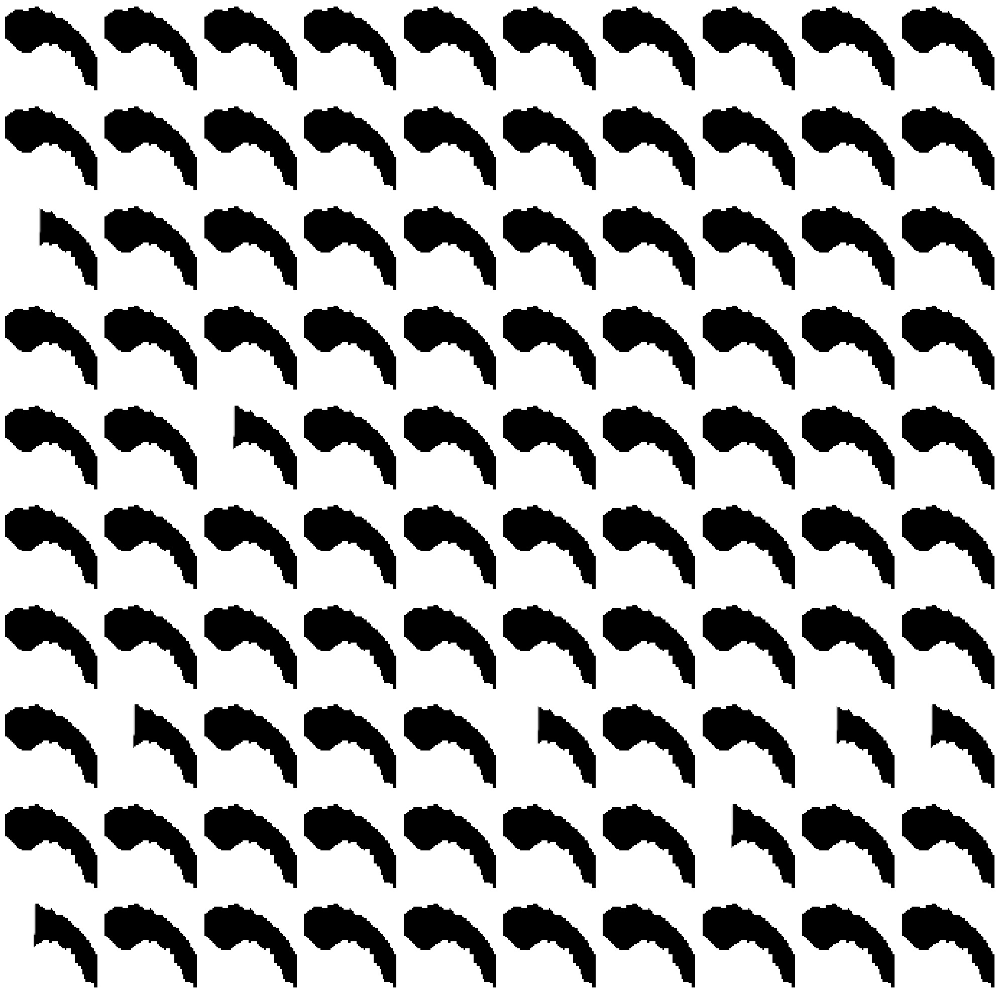

In [95]:
fig, axes = plt.subplots(nrows=10, ncols=10, figsize=(20, 20))  
axes = axes.flatten()
for i in range(100):
    ax = axes[i]
    ax.imshow(array_3d[i+800], cmap='gray') 
    ax.axis('off')
plt.tight_layout()
plt.show()

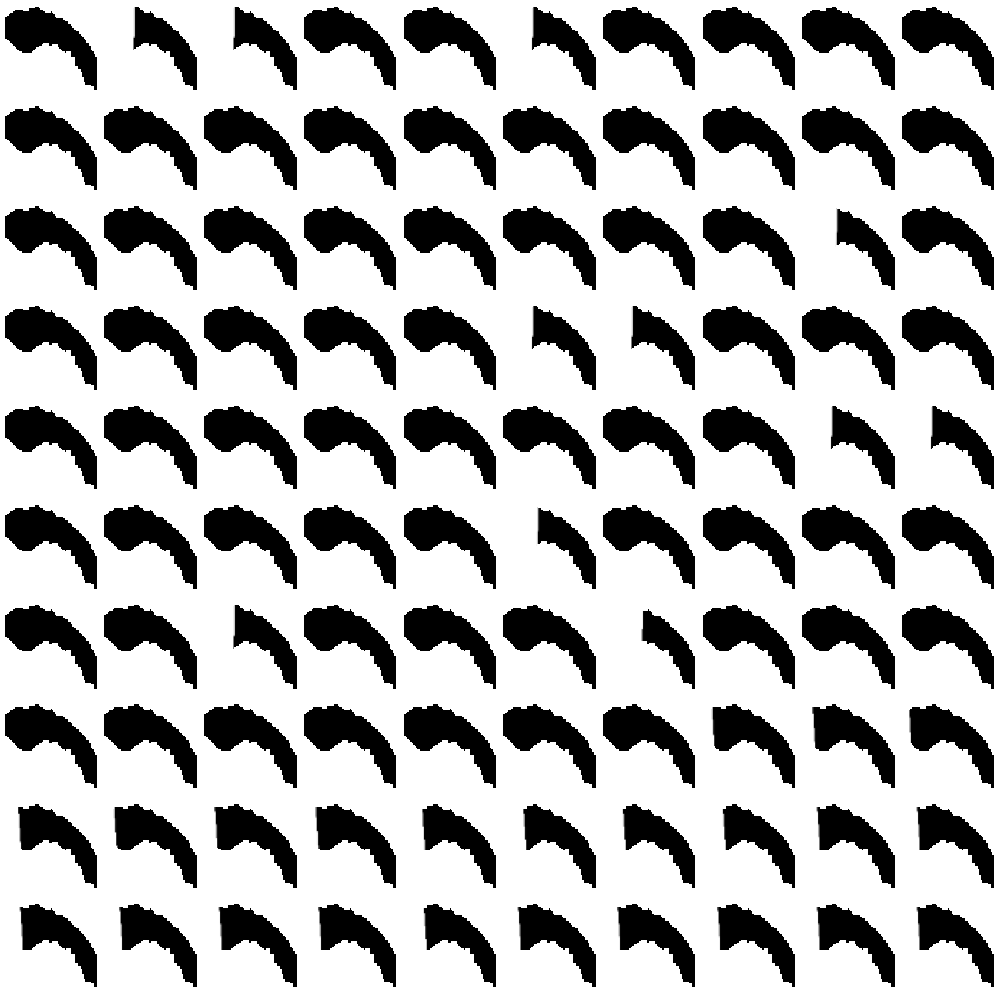

In [96]:
fig, axes = plt.subplots(nrows=10, ncols=10, figsize=(20, 20))  
axes = axes.flatten()
for i in range(100):
    ax = axes[i]
    ax.imshow(array_3d[i+900], cmap='gray') 
    ax.axis('off')
plt.tight_layout()
plt.show()

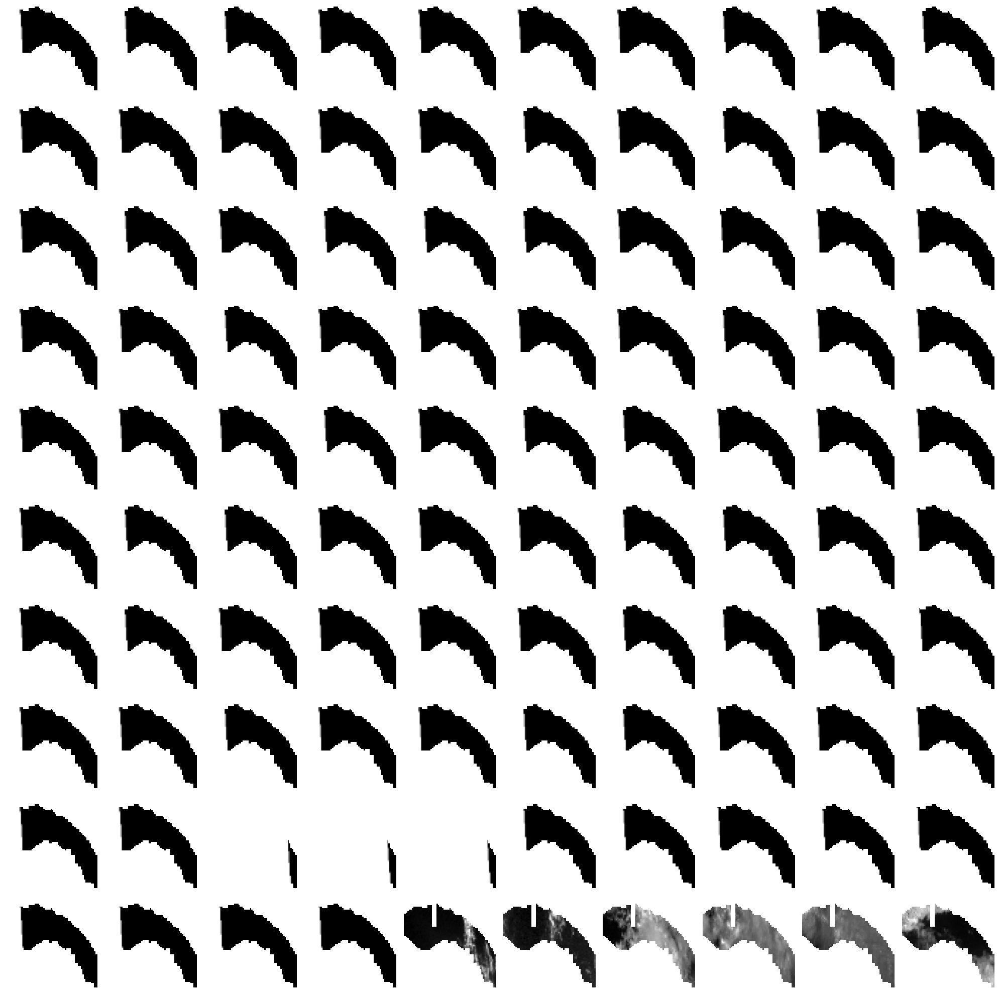

In [97]:
fig, axes = plt.subplots(nrows=10, ncols=10, figsize=(20, 20))  
axes = axes.flatten()
for i in range(100):
    ax = axes[i]
    ax.imshow(array_3d[i+1000], cmap='gray') 
    ax.axis('off')
plt.tight_layout()
plt.show()

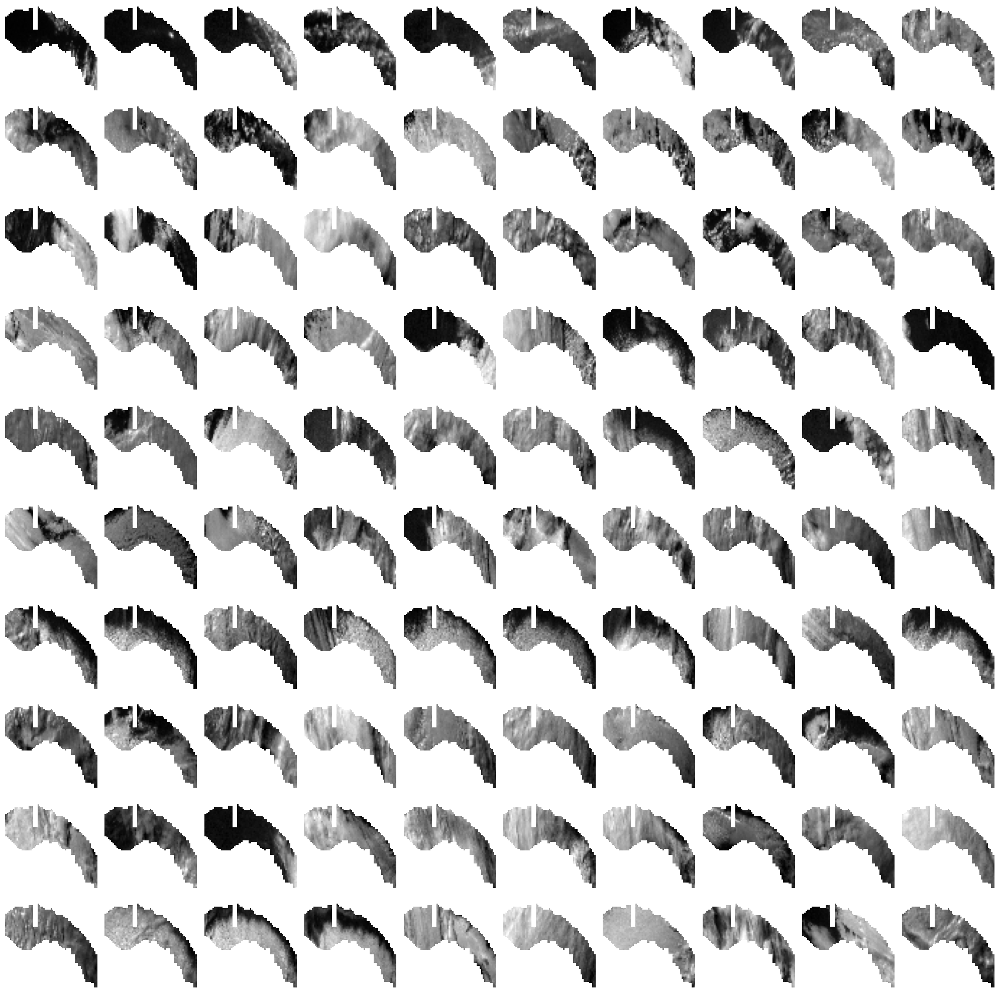

In [98]:
fig, axes = plt.subplots(nrows=10, ncols=10, figsize=(20, 20))  
axes = axes.flatten()
for i in range(100):
    ax = axes[i]
    ax.imshow(array_3d[i+1100], cmap='gray') 
    ax.axis('off')
plt.tight_layout()
plt.show()

**The cloud images are still clear enough, but there is missing information as well**

# 6PM EST

In [99]:
filtered_les = les[(les['DateTime_UTC'].dt.hour == 22)]
filtered_les = filtered_les.reset_index(drop=True)
filtered_les

,DateTime_UTC,Lake_data_1D,Lake_data_2D,Temp_F,RH_pct,Wind_Spd_mph,Wind_Direction_deg,Low_Cloud_Ht_ft,Visibility_mi,Atm_Press_hPa,Precip_in
0,2006-10-01 22:00:00,"[0.089999996, 0.082499996, 0.0875, 0.0775, 0.0...","[array([ nan, nan, nan, nan, nan...",51.0,73.0,6,130,11000,10,993.7,0.00
1,2006-10-02 22:00:00,"[0.21249999, 0.26, 0.33499998, 0.265, 0.42, 0....","[array([ nan, nan, nan, nan, nan...",67.0,72.0,6,0,0,10,990.7,0.00
2,2006-10-03 22:00:00,"[0.12, 0.099999994, 0.11, 0.0975, 0.1025, 0.10...","[array([ nan, nan, nan, nan, nan, n...",61.0,93.0,9,320,1300,3,990.3,0.61
3,2006-10-04 22:00:00,"[0.28, 0.285, 0.2775, 0.29, 0.28, 0.2875, 0.26...","[array([ nan, nan, nan, ...",47.0,73.0,6,90,0,10,1004.0,0.00
4,2006-10-05 22:00:00,"[0.2025, 0.22, 0.175, 0.1425, 0.21, 0.21, 0.13...","[array([ nan, nan, nan, nan, nan...",37.0,92.0,0,0,0,10,1007.0,0.00
...,...,...,...,...,...,...,...,...,...,...,...
2000,2017-03-27 22:00:00,"[0.4775, 0.475, 0.4725, 0.48, 0.4775, 0.48, 0....","[array([ nan, nan, nan, ...",38.0,89.0,0,0,1000,10,992.7,0.00
2001,2017-03-28 22:00:00,"[0.42249998, 0.42749998, 0.435, 0.42749998, 0....","[array([ nan, nan, nan, nan, nan...",32.0,88.0,0,0,20000,10,1001.6,0.00
2002,2017-03-29 22:00:00,"[0.3525, 0.345, 0.3575, 0.42749998, 0.45, 0.46...","[array([ nan, nan, nan, ...",40.0,50.0,9,100,9000,10,1001.0,0.00
2003,2017-03-30 22:00:00,"[0.415, 0.4325, 0.4325, 0.42749998, 0.44, 0.44...","[array([ nan, nan, nan, nan, nan...",35.0,92.0,7,30,2000,10,987.7,0.00


In [100]:
array_3d = get_3d_array(filtered_les)

Processing arrays: 100%|███████████████████████████████████████████████████████████| 2005/2005 [00:55<00:00, 36.18it/s]


In [101]:
array_3d.shape

(2005, 64, 64, 1)

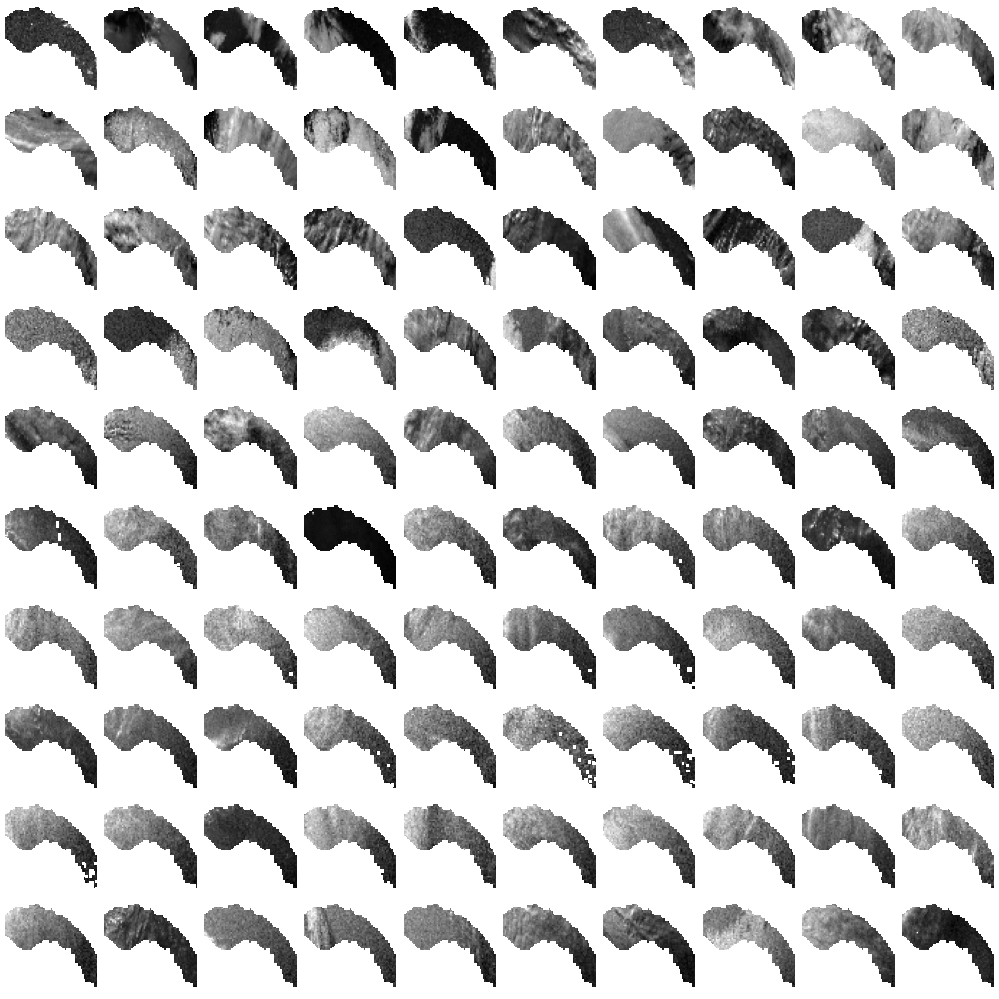

In [102]:
import matplotlib.pyplot as plt

fig, axes = plt.subplots(nrows=10, ncols=10, figsize=(20, 20))  
axes = axes.flatten()
for i in range(100):
    ax = axes[i]
    ax.imshow(array_3d[i], cmap='gray') 
    ax.axis('off')
plt.tight_layout()
plt.show()

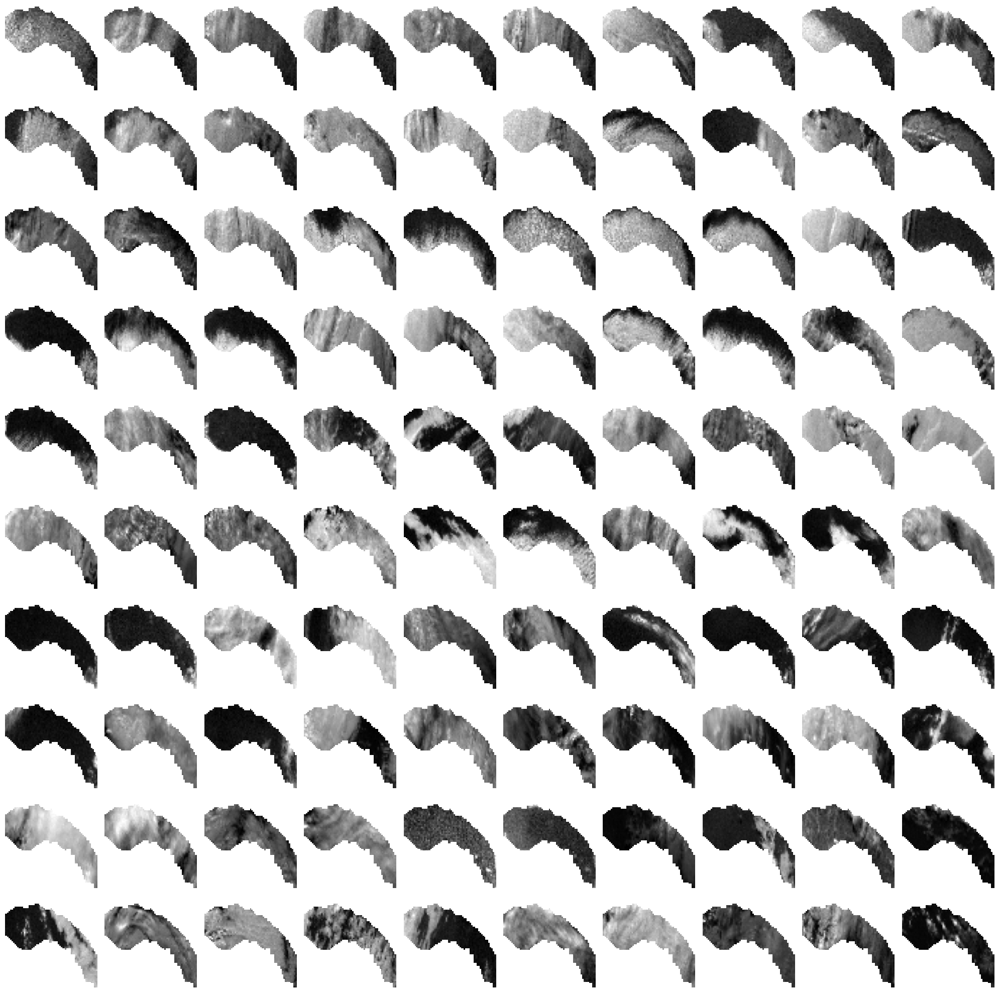

In [103]:
fig, axes = plt.subplots(nrows=10, ncols=10, figsize=(20, 20))  
axes = axes.flatten()
for i in range(100):
    ax = axes[i]
    ax.imshow(array_3d[i+100], cmap='gray') 
    ax.axis('off')
plt.tight_layout()
plt.show()

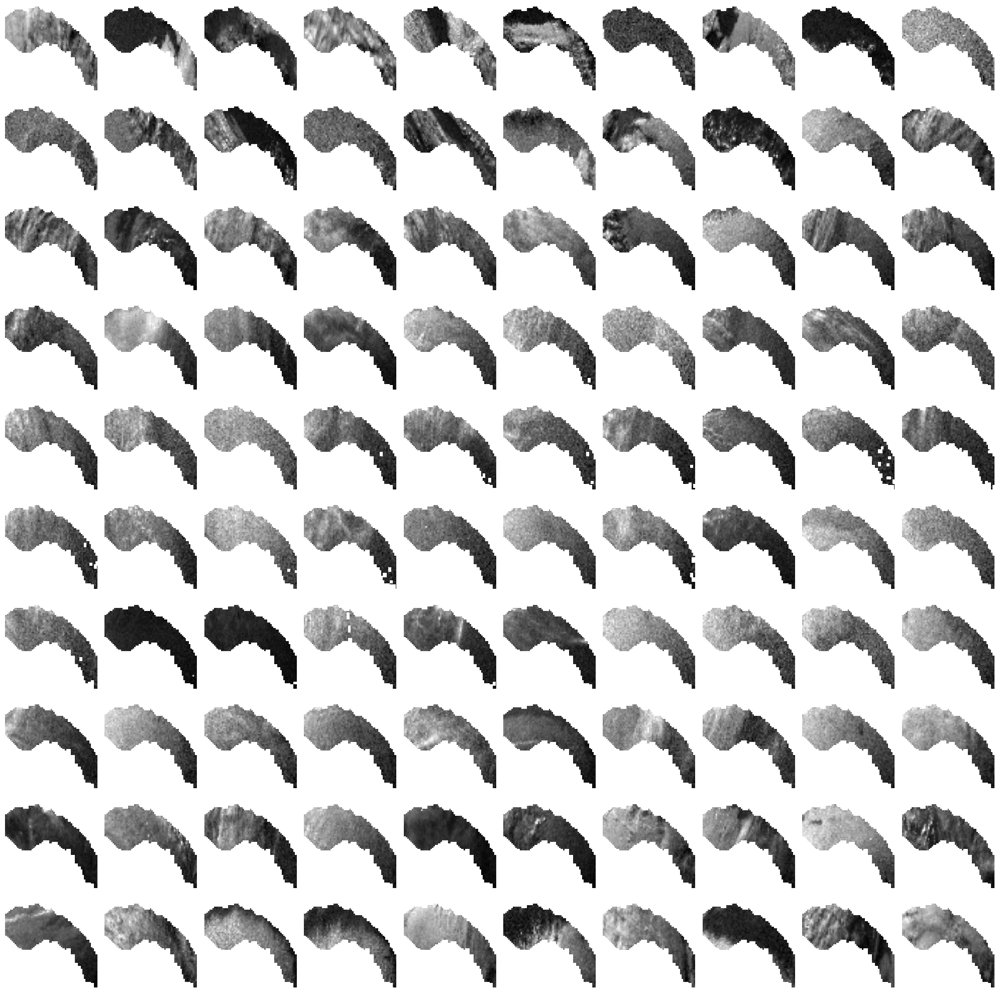

In [104]:
fig, axes = plt.subplots(nrows=10, ncols=10, figsize=(20, 20))  
axes = axes.flatten()
for i in range(100):
    ax = axes[i]
    ax.imshow(array_3d[i+200], cmap='gray') 
    ax.axis('off')
plt.tight_layout()
plt.show()

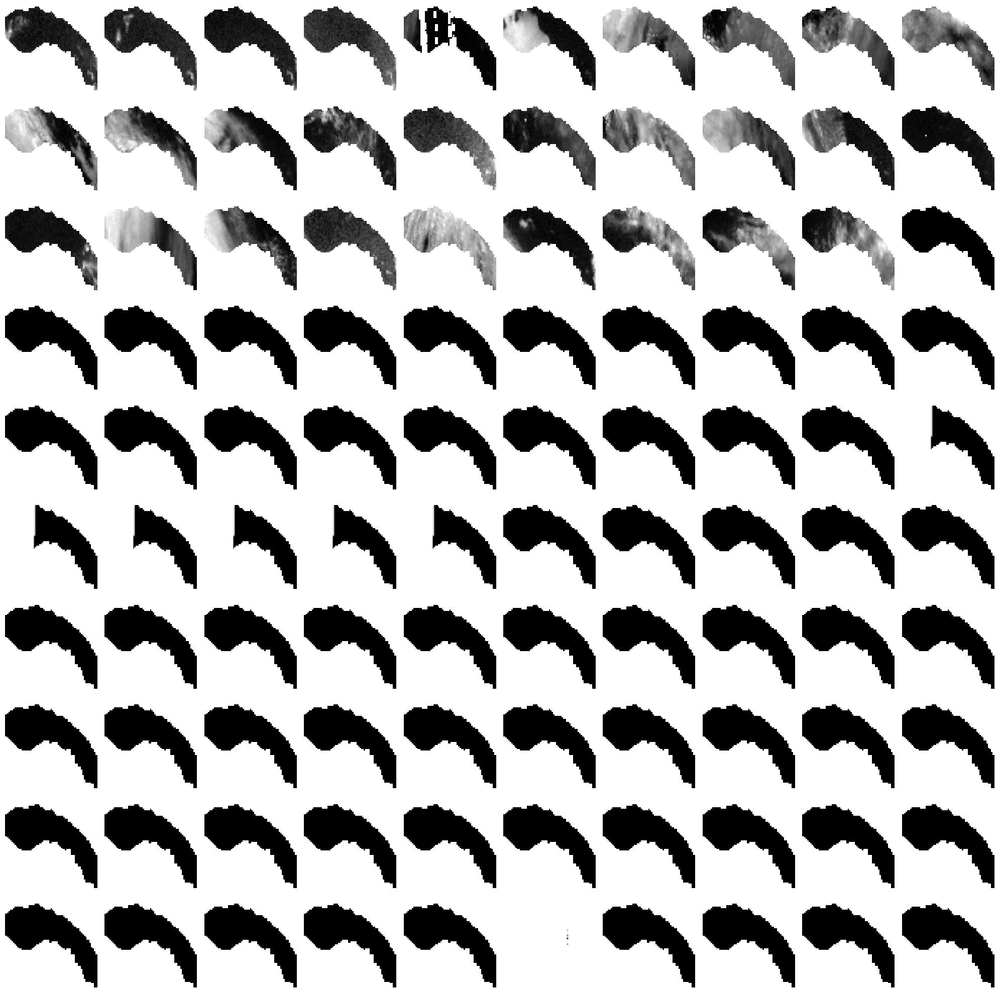

In [105]:
fig, axes = plt.subplots(nrows=10, ncols=10, figsize=(20, 20))  
axes = axes.flatten()
for i in range(100):
    ax = axes[i]
    ax.imshow(array_3d[i+700], cmap='gray') 
    ax.axis('off')
plt.tight_layout()
plt.show()

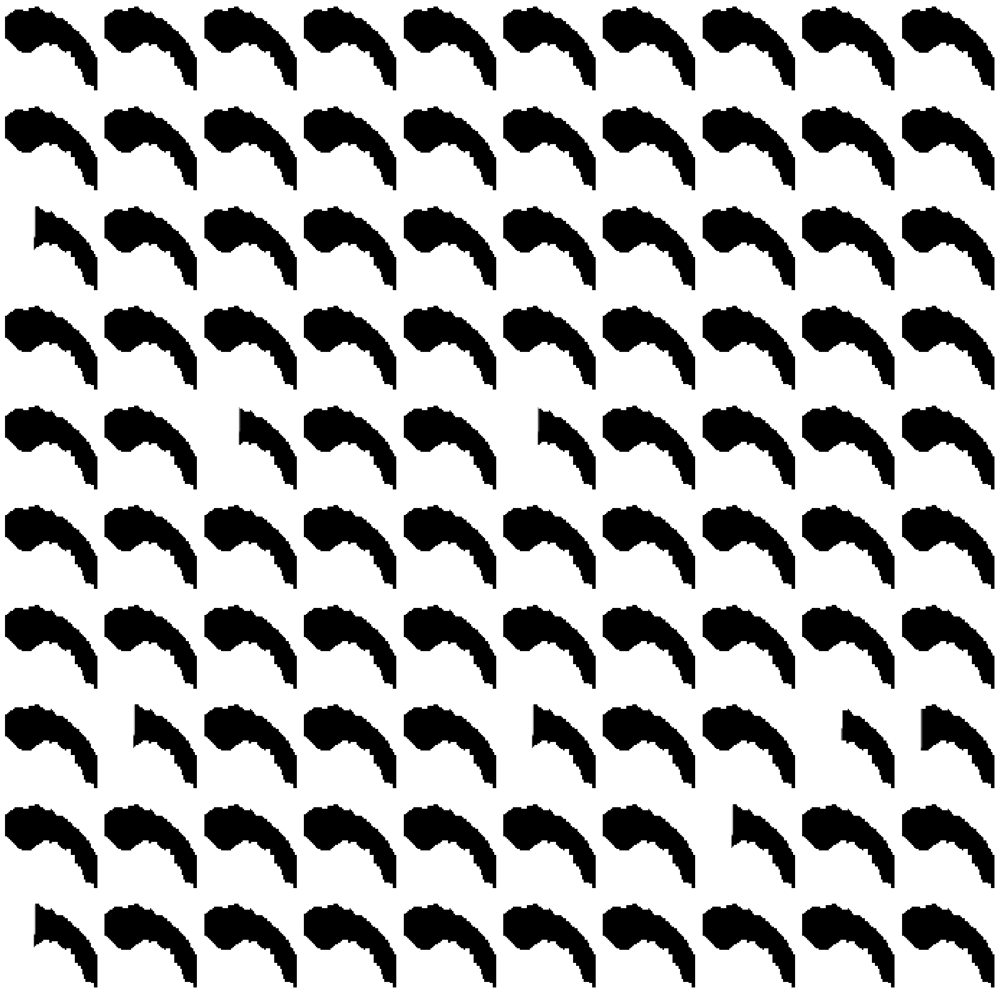

In [106]:
fig, axes = plt.subplots(nrows=10, ncols=10, figsize=(20, 20))  
axes = axes.flatten()
for i in range(100):
    ax = axes[i]
    ax.imshow(array_3d[i+800], cmap='gray') 
    ax.axis('off')
plt.tight_layout()
plt.show()

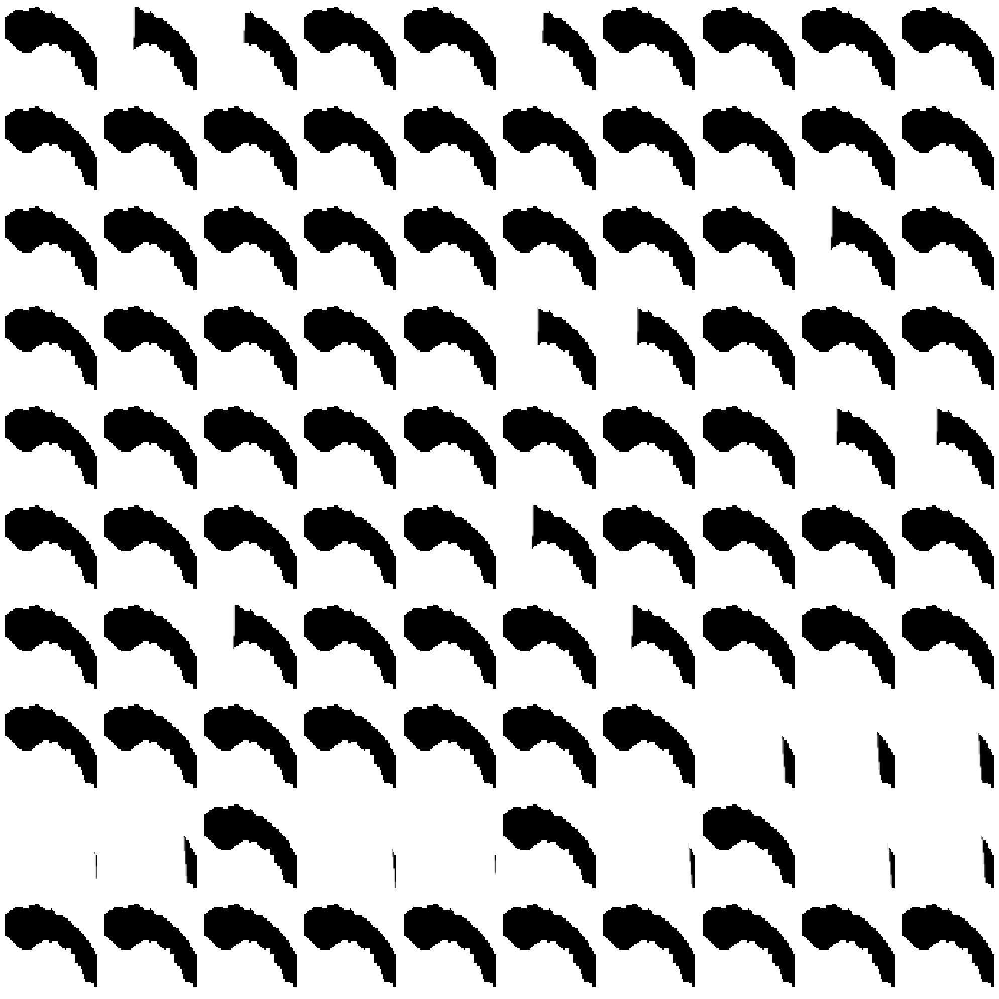

In [107]:
fig, axes = plt.subplots(nrows=10, ncols=10, figsize=(20, 20))  
axes = axes.flatten()
for i in range(100):
    ax = axes[i]
    ax.imshow(array_3d[i+900], cmap='gray') 
    ax.axis('off')
plt.tight_layout()
plt.show()

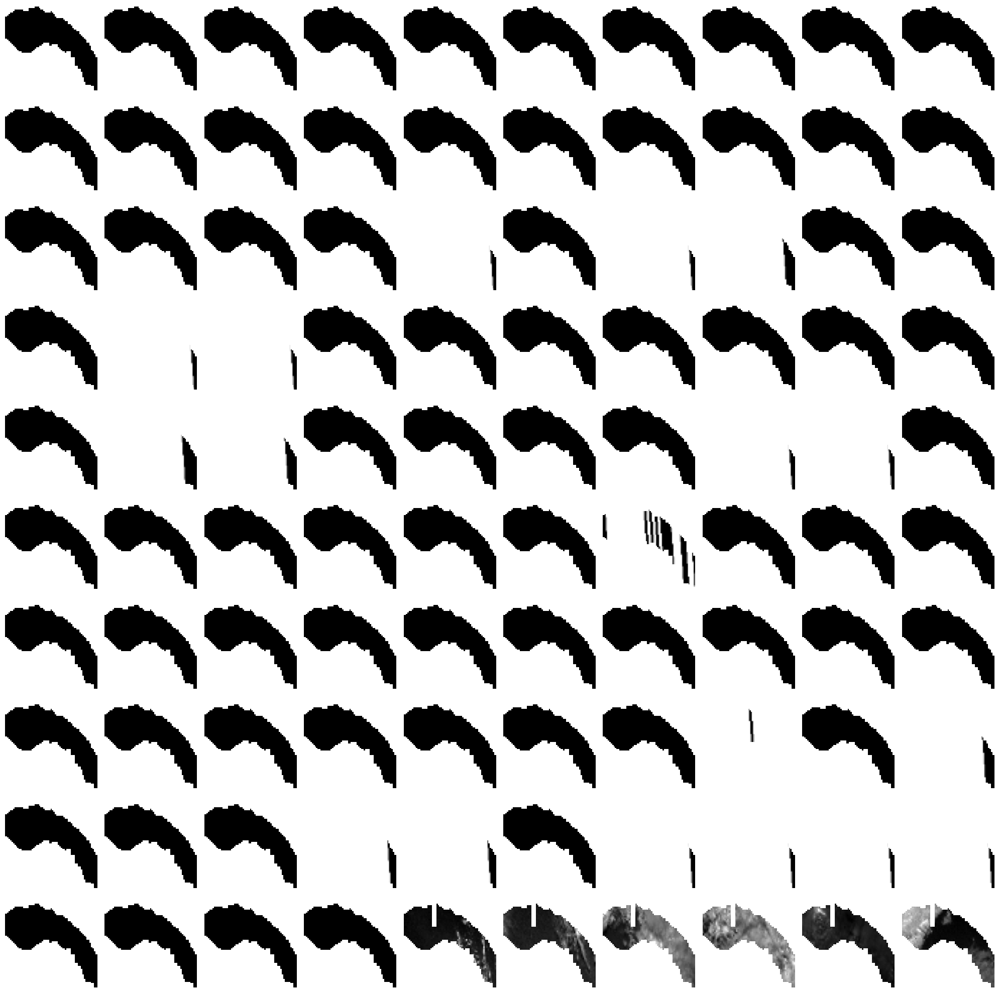

In [108]:
fig, axes = plt.subplots(nrows=10, ncols=10, figsize=(20, 20))  
axes = axes.flatten()
for i in range(100):
    ax = axes[i]
    ax.imshow(array_3d[i+1000], cmap='gray') 
    ax.axis('off')
plt.tight_layout()
plt.show()

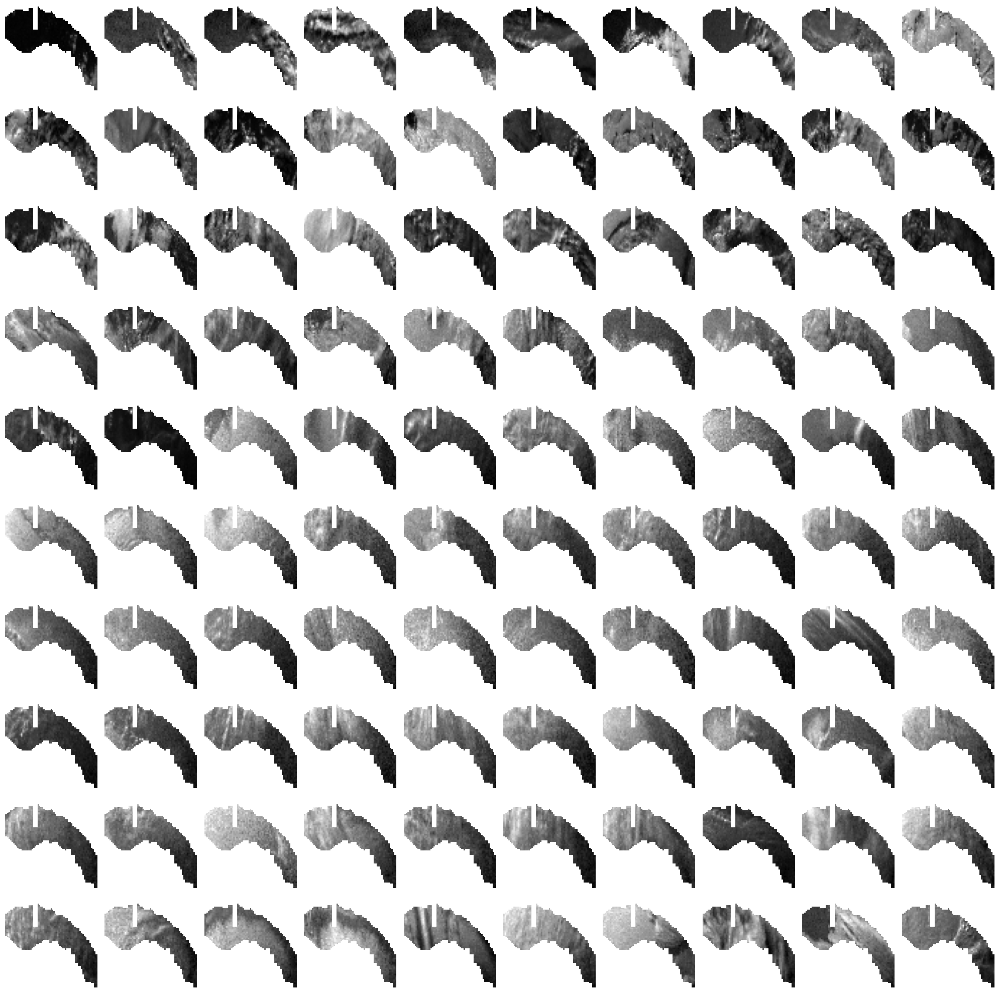

In [109]:
fig, axes = plt.subplots(nrows=10, ncols=10, figsize=(20, 20))  
axes = axes.flatten()
for i in range(100):
    ax = axes[i]
    ax.imshow(array_3d[i+1100], cmap='gray') 
    ax.axis('off')
plt.tight_layout()
plt.show()

**The cloud images are still clear enough, but there is missing information as well**

# 7PM EST

In [110]:
filtered_les = les[(les['DateTime_UTC'].dt.hour == 23)]
filtered_les = filtered_les.reset_index(drop=True)
filtered_les

,DateTime_UTC,Lake_data_1D,Lake_data_2D,Temp_F,RH_pct,Wind_Spd_mph,Wind_Direction_deg,Low_Cloud_Ht_ft,Visibility_mi,Atm_Press_hPa,Precip_in
0,2006-10-01 23:00:00,"[0.04, 0.0425, 0.044999998, 0.04, 0.04, 0.0475...","[array([ nan, nan, nan, nan, nan, n...",51.0,79.0,5,170,10000,10,994.0,0.00
1,2006-10-02 23:00:00,"[0.022499999, 0.035, 0.03, 0.03, 0.022499999, ...","[array([ nan, nan, nan, nan, nan...",66.0,75.0,3,0,0,10,990.7,0.00
2,2006-10-03 23:00:00,"[0.0525, 0.049999997, 0.0425, 0.057499997, 0.0...","[array([ nan, nan, nan, nan, nan...",60.0,100.0,7,350,700,3,989.7,1.40
3,2006-10-04 23:00:00,"[0.089999996, 0.0925, 0.0775, 0.0775, 0.085, 0...","[array([ nan, nan, nan, nan, nan...",46.0,76.0,6,50,0,10,1004.3,0.00
4,2006-10-05 23:00:00,"[0.0425, 0.067499995, 0.049999997, 0.0325, 0.0...","[array([ nan, nan, nan, nan, nan...",37.0,92.0,0,0,0,10,1007.3,0.00
...,...,...,...,...,...,...,...,...,...,...,...
2000,2017-03-27 23:00:00,"[0.24499999, 0.24499999, 0.22749999, 0.2175, 0...","[array([ nan, nan, nan, nan, nan...",37.0,88.0,7,360,700,10,993.0,0.00
2001,2017-03-28 23:00:00,"[0.235, 0.24, 0.24, 0.24249999, 0.235, 0.24, 0...","[array([ nan, nan, nan, nan, nan...",30.0,92.0,0,0,20000,10,1001.6,0.00
2002,2017-03-29 23:00:00,"[0.24499999, 0.2625, 0.24, 0.24249999, 0.205, ...","[array([ nan, nan, nan, nan, nan, n...",39.0,45.0,9,110,7500,10,1000.6,0.00
2003,2017-03-30 23:00:00,"[0.26749998, 0.26999998, 0.285, 0.28, 0.2725, ...","[array([ nan, nan, nan, ...",35.0,92.0,8,50,1800,8,987.0,0.01


In [111]:
array_3d = get_3d_array(filtered_les)

Processing arrays: 100%|███████████████████████████████████████████████████████████| 2005/2005 [00:53<00:00, 37.18it/s]


In [112]:
array_3d.shape

(2005, 64, 64, 1)

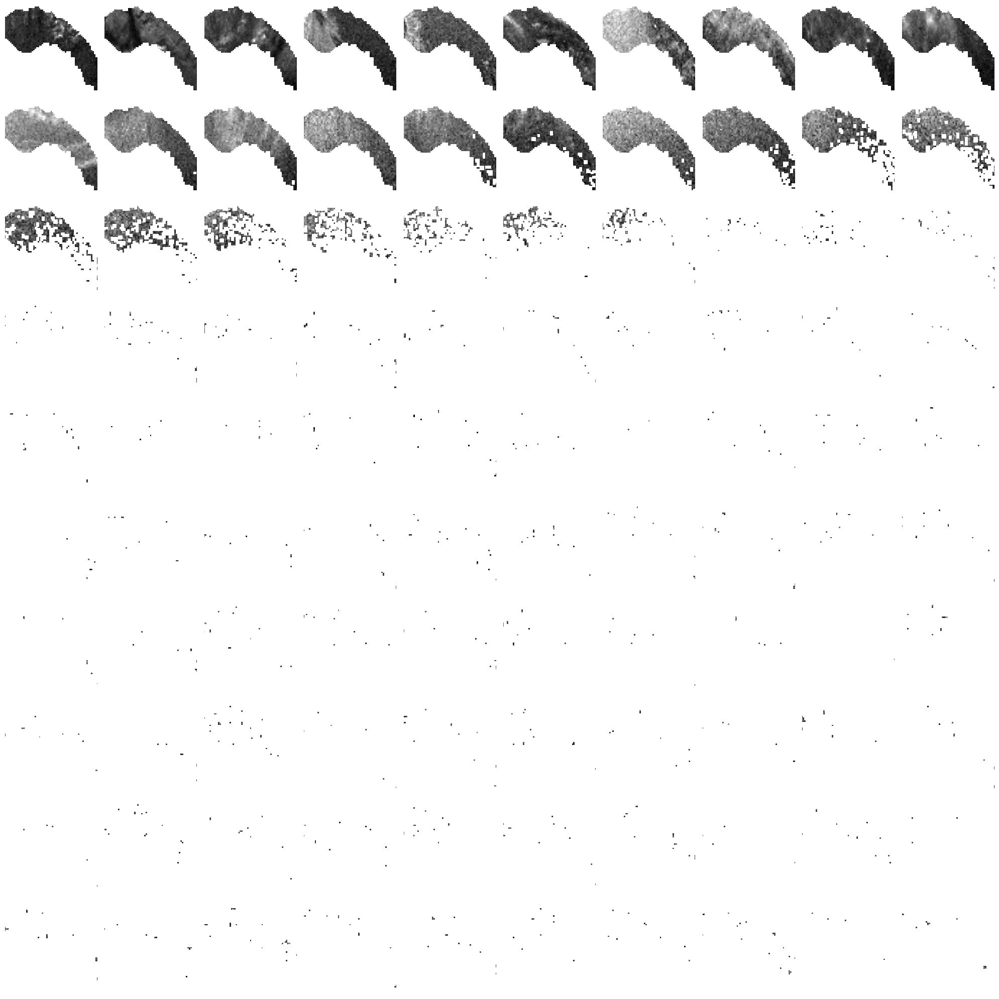

In [113]:
import matplotlib.pyplot as plt

fig, axes = plt.subplots(nrows=10, ncols=10, figsize=(20, 20))  
axes = axes.flatten()
for i in range(100):
    ax = axes[i]
    ax.imshow(array_3d[i], cmap='gray') 
    ax.axis('off')
plt.tight_layout()
plt.show()

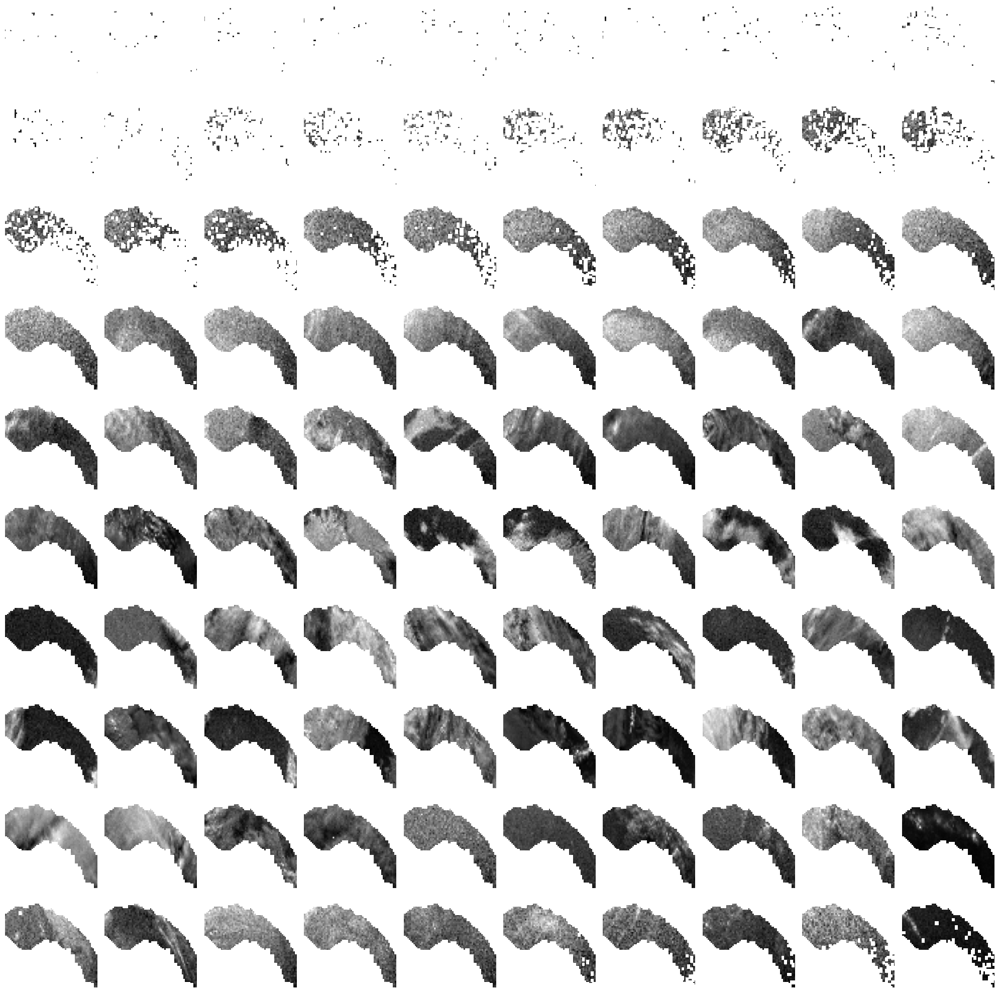

In [114]:
fig, axes = plt.subplots(nrows=10, ncols=10, figsize=(20, 20))  
axes = axes.flatten()
for i in range(100):
    ax = axes[i]
    ax.imshow(array_3d[i+100], cmap='gray') 
    ax.axis('off')
plt.tight_layout()
plt.show()

**After 6PM EST the images staring distorted**

**Let's check the dates for those indices where the images are all dark continously accross all time periods**

In [115]:
print(filtered_les.iloc[729])
print(filtered_les.iloc[1094])

DateTime_UTC                                        2010-10-01 23:00:00
Lake_data_1D          [3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, ...
Lake_data_2D          [array([nan, nan, nan, nan, nan, nan, nan, nan...
Temp_F                                                             50.0
RH_pct                                                             76.0
Wind_Spd_mph                                                          6
Wind_Direction_deg                                                  350
Low_Cloud_Ht_ft                                                    5000
Visibility_mi                                                        10
Atm_Press_hPa                                                     994.7
Precip_in                                                          0.01
Name: 729, dtype: object
DateTime_UTC                                        2012-10-01 23:00:00
Lake_data_1D          [0.074999996, 0.0775, 0.0725, 0.082499996, 0.0...
Lake_data_2D          [array([  nan,   

**The date range for those dark images are from `2010-10-01 23:00:00` to `2012-10-01 23:00:00`**

**Upon reviewing the images, it is evident that the clear cloud images are available from 10 AM EST to 6 PM EST, which corresponds to 14:00 UTC to 22:00 UTC.**

**Additionally, the images are completely dark from `October 1, 2010, at 23:00:00 to October 1, 2012, at 23:00:00.`**

# Dropping data

We are focusing on data from **14:00 UTC to 22:00 UTC**, corresponding to **10:00 AM EST to 6:00 PM EST**, during which there is sufficient sunlight to generate reflections and capture valuable information. This time window provides reliable data for our experiments and allows us to extract meaningful insights from Lake Michigan and its surroundings.

Additionally, we are missing information for the period from **October 1, 2010, at 23:00:00 to October 1, 2012, at 23:00:00.**

So, let's drop the unclear cloud image data which is from **23:00 UTC to 13:00 UTC** and missing information for the period from **October 1, 2010, at 23:00:00 to October 1, 2012, at 23:00:00.**

In [116]:
# start and end of the period to exclude
start_date = pd.Timestamp('2010-10-01 23:00:00')
end_date = pd.Timestamp('2012-10-01 23:00:00')

# Filter data for times between 14:00 and 21:00 UTC
# Exclude data between October 1, 2010, 23:00:00 and October 1, 2012, 23:00:00
filtered_les = les[
    (les['DateTime_UTC'].dt.hour >= 14) & 
    (les['DateTime_UTC'].dt.hour <= 22) & 
    ~((les['DateTime_UTC'] > start_date) & (les['DateTime_UTC'] < end_date))
]

In [117]:
filtered_les = filtered_les.reset_index(drop=True)
filtered_les

,DateTime_UTC,Lake_data_1D,Lake_data_2D,Temp_F,RH_pct,Wind_Spd_mph,Wind_Direction_deg,Low_Cloud_Ht_ft,Visibility_mi,Atm_Press_hPa,Precip_in
0,2006-10-01 14:00:00,"[0.067499995, 0.07, 0.0625, 0.06, 0.0725, 0.06...","[array([ nan, nan, nan, ...",60.0,49.0,10,270,3600,10,994.7,0.0
1,2006-10-01 15:00:00,"[0.067499995, 0.067499995, 0.06, 0.06, 0.05749...","[array([ nan, nan, nan, ...",60.0,47.0,3,270,0,10,994.7,0.0
2,2006-10-01 16:00:00,"[0.0725, 0.067499995, 0.07, 0.07, 0.067499995,...","[array([ nan, nan, nan, nan, nan...",59.0,55.0,6,40,0,10,994.7,0.0
3,2006-10-01 17:00:00,"[0.067499995, 0.067499995, 0.067499995, 0.07, ...","[array([ nan, nan, nan, nan, nan, nan, n...",55.0,71.0,0,0,0,10,994.7,0.0
4,2006-10-01 18:00:00,"[0.085, 0.085, 0.0875, 0.0725, 0.0775, 0.0775,...","[array([ nan, nan, nan, nan, nan...",50.0,82.0,0,0,8000,10,994.7,0.0
...,...,...,...,...,...,...,...,...,...,...,...
14755,2017-03-31 18:00:00,"[0.72749996, 0.7525, 0.74, 0.7075, 0.715, 0.73...","[array([ nan, nan, nan, nan, nan...",42.0,67.0,3,320,5000,10,991.3,0.0
14756,2017-03-31 19:00:00,"[0.75, 0.78249997, 0.805, 0.78999996, 0.789999...","[array([ nan, nan, nan, nan, nan...",40.0,76.0,0,0,5000,10,991.7,0.0
14757,2017-03-31 20:00:00,"[0.76, 0.675, 0.72249997, 0.7175, 0.73249996, ...","[array([ nan, nan, nan, nan, nan...",39.0,72.0,3,20,5000,10,992.3,0.0
14758,2017-03-31 21:00:00,"[0.6225, 0.6375, 0.6525, 0.66499996, 0.6725, 0...","[array([ nan, nan, nan, nan, nan...",35.0,84.0,5,300,5000,10,993.3,0.0


**Let's keep only the `DateTime_UTC` and `lake_data_2D` to further work on the coluds images for CNN model**

In [118]:
filtered_les_cld_imgs = filtered_les[['DateTime_UTC', 'Lake_data_2D']]
filtered_les_cld_imgs.head(10)

,DateTime_UTC,Lake_data_2D
0,2006-10-01 14:00:00,"[array([ nan, nan, nan, ..."
1,2006-10-01 15:00:00,"[array([ nan, nan, nan, ..."
2,2006-10-01 16:00:00,"[array([ nan, nan, nan, nan, nan..."
3,2006-10-01 17:00:00,"[array([ nan, nan, nan, nan, nan, nan, n..."
4,2006-10-01 18:00:00,"[array([ nan, nan, nan, nan, nan..."
5,2006-10-01 19:00:00,"[array([ nan, nan, nan, nan, nan..."
6,2006-10-01 20:00:00,"[array([ nan, nan, nan, nan, nan, nan, n..."
7,2006-10-01 21:00:00,"[array([ nan, nan, nan, ..."
8,2006-10-01 22:00:00,"[array([ nan, nan, nan, nan, nan..."
9,2006-10-02 14:00:00,"[array([ nan, nan, nan, nan, nan, n..."


### Saving the filtered data to CSV file

In [ ]:
# filtered_les.to_csv('filtered_les_cld_imgs.csv', index=False)